### Master in Data Science and Analytics Program Design

The following .ipynb file contains the code for the design of the six "pillar" courses along with the webscrapping codes used to generate them. This is then followed by the code for the recommender system implementation and then, the code for scrapping from various job board sites.


### Intro to Programming Course Design

In [35]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
pd.options.display.max_columns = None

import os
#import re package for the use of regular expressions
import re
#import package for string handling
import string
try:
    import emoji #If tweepy is already installed on the system
except:
    !pip install emoji

#import nltk package for text processing
import nltk
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem.porter import PorterStemmer

import numpy as np
try:
    from wordcloud import WordCloud, STOPWORDS
except:
    !pip install wordcloud
    from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
import seaborn as sns

from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn.metrics import pairwise_distances
import unicodedata





import warnings
#warnings.filterwarnings("ignore", category=ConvergenceWarning)
warnings.filterwarnings("ignore")

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


# The following performs web scraping on classcentral.com

All the highest rated courses are obtained

In [36]:
# job_listings_url_1 = 'https://www.classcentral.com/search?q=programming&sort=rating-up&subject=data-science'
# job_listings_url_2 = 'https://www.classcentral.com/search?page=2&q=programming&sort=rating-up&subject=data-science'
# job_listings_url_3 = 'https://www.classcentral.com/search?page=3&q=programming&sort=rating-up&subject=data-science'
# job_listings_url_4 = 'https://www.classcentral.com/search?page=4&q=programming&sort=rating-up&subject=data-science'

# response = requests.get(job_listings_url_1)
# listingSoup_1 = BeautifulSoup(response.text, 'html.parser')

# response = requests.get(job_listings_url_2)
# listingSoup_2 = BeautifulSoup(response.text, 'html.parser')

# response = requests.get(job_listings_url_3)
# listingSoup_3 = BeautifulSoup(response.text, 'html.parser')

# response = requests.get(job_listings_url_4)
# listingSoup_4 = BeautifulSoup(response.text, 'html.parser')

In [37]:
# all_links_1 = listingSoup_1.find_all('a', attrs={'class': 'color-charcoal block line-tight course-name'})
# all_links_2 = listingSoup_2.find_all('a', attrs={'class': 'color-charcoal block line-tight course-name'})
# all_links_3 = listingSoup_3.find_all('a', attrs={'class': 'color-charcoal block line-tight course-name'})
# all_links_4 = listingSoup_4.find_all('a', attrs={'class': 'color-charcoal block line-tight course-name'})
# all_links = all_links_1 + all_links_2 + all_links_3 + all_links_4


# # Links are relative, of the form /course/course_number. Need to append this to main host name
# web_pages = ['https://www.classcentral.com' + link.get('href') for link in all_links]
# print(len(web_pages))
# web_pages

In [38]:
# def getDescription(url):
#     response = requests.get(url)
#     jobSoup = BeautifulSoup(response.text, 'html.parser')
#     summary = jobSoup.find_all('div', attrs={'class': 'wysiwyg line-wide text-1 margin-bottom-large'})
#     return summary

# descriptions = [getDescription(page) for page in web_pages]

In [39]:
#all_stars = listingSoup.find_all('span', attrs = {'class': 'text-4 color-charcoal block'})[1:] #skip first, it's an ad
#all_stars = [float(star.text) for star in all_stars]
#print(len(all_stars))

# 54 ratings instead of 50 because of fucking ads. Need to work on removing them later.

In [40]:
# all_descriptions = ['']*len(descriptions)
# for idx, each_job in enumerate(descriptions):
#     for description in each_job:
#         all_descriptions[idx] += description.text
        
# for i in range(len(all_descriptions)):
#     all_descriptions[i] = all_descriptions[i].strip()
    
# print(all_descriptions[0])

In [41]:
# len(all_descriptions)

In [42]:
# df_data = {'Link': web_pages, 'Description': all_descriptions}
# df = pd.DataFrame(df_data)

# df.to_csv('./programming_scraped.csv', index=False, header=True)
# df

# Load the scraped data that we saved previously

In [43]:
df = pd.read_csv('./programming_scraped.csv')
df.head(2)

,Link,Description
0,https://www.classcentral.com/course/independent-dco042-python-for-informatics-1010,"This is a course to teach basic Python programming skills through data analysis. The book and course materials are all free and licensed as Creative Commons. There is no complex math in the course, the programs are generally quite short, and the workload is no more than a few hours per week. By the time you complete the course, you will understand be able to read, parse, and manipulate data using Python. Hopefully at the end of the course you will like programming well enough to take another course in programming or web development. You can register and launch, take the course, and earn your place on the map at any time and at your own pace"
1,https://www.classcentral.com/course/udacity-data-analysis-with-r-1478,"Exploratory data analysis is an approach for summarizing and visualizing the important characteristics of a data set. Promoted by John Tukey, exploratory data analysis focuses on exploring data to understand the data’s underlying structure and variables, to develop intuition about the data set, to consider how that data set came into existence, and to decide how it can be investigated with more formal statistical methods.If you're interested in supplemental reading material for the course check out the Exploratory Data Analysis book. (Not Required)This course is also a part of our Data Analyst Nanodegree.Why Take This Course?You will... Understand data analysis via EDA as a journey and a way to explore data Explore data at multiple levels using appropriate visualizations Acquire statistical knowledge for summarizing data Demonstrate curiosity and skepticism when performing data analysis Develop intuition around a data set and understand how the data was generated.\n\n\n\nLesson 1: What is EDA? (1 hour)We'll start by learn about what exploratory data analysis (EDA) is and why it is important. You'll meet the amazing instructors for the course and find out about the course structure and final project.Lesson 2: R Basics (3 hours)EDA, which comes before formal hypothesis testing and modeling, makes use of visual methods to analyze and summarize data sets. R will be our tool for generating those visuals and conducting analyses. In this lesson, we will install RStudio and packages, learn the layout and basic commands of R, practice writing basic R scripts, and inspect data sets.Lesson 3: Explore One Variable (4 hours)We perform EDA to understand the distribution of a variable and to check for anomalies and outliers. Learn how to quantify and visualize individual variables within a data set as we begin to make sense of a pseudo-data set of Facebook users. While the data set does not contain real user data, it does contain a wealth of information. Through the lesson, we will create histograms and boxplots, transform variables, and examine tradeoffs in visualizations.Problem Set 3 (2 hours)Lesson 4: Explore Two Variables (4 hours)EDA allows us to identify the most important variables and relationships within a data set before building predictive models. In this lesson, we will learn techniques for exploring the relationship between any two variables in a data set. We'll create scatter plots, calculate correlations, and investigate conditional means.Problem Set 4 (2 hours)Lesson 5: Explore Many Variables (4 hours)Data sets can be complex. In this lesson, we will learn powerful methods and visualizations for examining relationships among multiple variables. We'll learn how to reshape data frames and how to use aesthetics like color and shape to uncover more information. Extending our knowledge of previous plots, we'll continue to build intuition around the Facebook data set and explore some new data sets as well.Problem Set 5 (2 hours)Lesson 6: Diamonds and Price Predictions (2 hours)Investigate the diamonds data set alongside Facebook Data Scientist, Solomon Messing. He'll recap many of the strategies covered in the course an

In [44]:
def ProcessText(tweet):
        
    
    #start by tokenize the tweet (separate it the text into words, or n-grams) with nltk
    word_tokens = word_tokenize(tweet) 
 
    #convert text into lowercase
    word_tokens = [word.lower() for word in word_tokens]
    
    #remove punctuation signs from tokens
    table = str.maketrans('', '', string.punctuation)
    word_tokens = [word.translate(table) for word in word_tokens]
    
    #remove non-alphabetic characters
    word_tokens = [word for word in word_tokens if word.isalpha()]
    
    #remove stopwords
    stop_words = set(stopwords.words('english')) #import a predefined set of stopwords from the nltk package
    word_tokens = [word for word in word_tokens if not word in stop_words]

    clean_tweet = [] #create empty list to store the final tokens after text processing
    for w in word_tokens:
        clean_tweet.append(w)

    #join the tokens of the clean tweet back into a string with spaces in between
    clean_tweet_str = ' '.join(clean_tweet)
    
    #return the clean tweet string
    return clean_tweet_str  


processedTextList = []
for desc in df['Description']:
    temp = ProcessText(desc)
    processedTextList.append(temp)
df['Processed Description'] = processedTextList

In [45]:
df['Processed Description'].head(3)

0    course teach basic python programming skills data analysis book course materials free licensed creative commons complex math course programs generally quite short workload hours per week time complete course understand able read parse manipulate data using python hopefully end course like programming well enough take another course programming web development register launch take course earn place map time pace                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                     

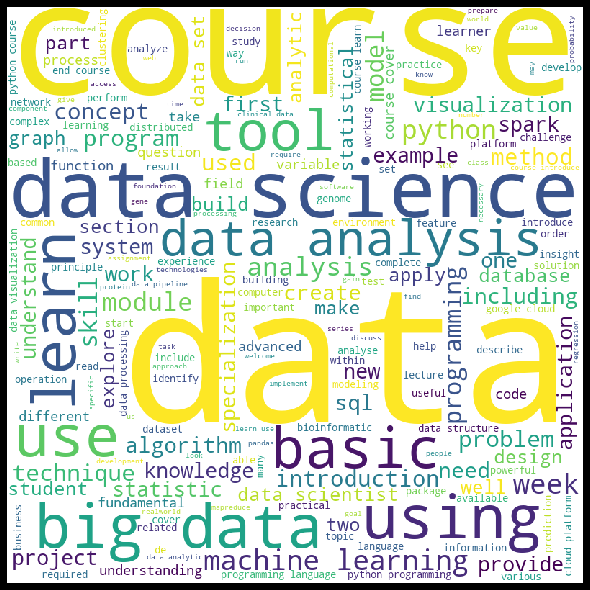

In [46]:
def generateWordCloud(strInput):
    wordcloud = WordCloud(width = 800, height = 800, 
                    background_color ='white',  
                    min_font_size = 10).generate(strInput) 

    # plot the WordCloud image                        
    plt.figure(figsize = (8, 8), facecolor = 'black') 
    plt.imshow(wordcloud) 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 

    plt.show() 
    
    
strForWC = ""
for desc in processedTextList:
    for text in desc:
        strForWC = strForWC + text

generateWordCloud(strForWC)

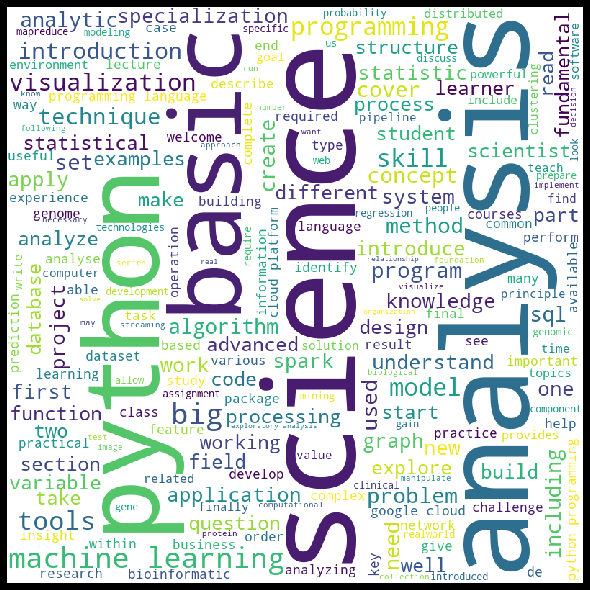

In [47]:
strForWC = ""
for desc in processedTextList:
    wordList = desc.split()
    for word in wordList:
        if (word not in ['week','module','learn','week','using','data','course','use','tool', 'provide', 'example', 
                        'topic', 'understanding']):
            strForWC = strForWC + word + ' '
generateWordCloud(strForWC)

# Constructing course curriculum from descriptions

In [48]:
# Based off ratings, this is the highest rated course with a good description Python

df['Processed Description'][3]

'course aims equipping participants able use python programming solving data science problems intended audience final year undergraduates prerequisites knowledge basic data science algorithms industry support honeywell abb ford gyan data pvt ltd course layout week python spyder tool introduction spyder setting working directory creating saving script file file execution clearing console removing variables environment clearing environment commenting script files variable creation arithmetic logical operators data types associated operations week structures lists tuples dictionary sets numpy array matrix associated operations linear algebra related operations week dataframe dataframe related operations toyota corolla dataset reading files exploratory data analysis data preparation preprocessing visualization toyoto corolla dataset using matplotlib seaborn libraries scatter plot line plot bar plot histogram box plot pair plot structures using toyota corolla dataset ifelse family loop loop

In [49]:
python_skills = ['algorithm', 'structures', 'list', 'tuple', 'dictionary', 'array', 'numpy', 'linear', 'algebra', 
                'dataframe', 'pandas', 'analysis', 'preprocessing', 'visualization', 'matplotlib', 'plot', 'seaborn',
                'libraries']


In [50]:
# Based off ratings, this is the highest rated course with a good description for R

df['Processed Description'][5]

'first professional certificate program data science course introduce basics r programming better retain r learn solve specific problem use realworld dataset crime united states learn r skills needed answer essential questions differences crime across different states cover r functions data types tackle operate vectors use advanced functions like sorting learn apply general programming features like ifelse loop commands wrangle analyze visualize data rather covering every r skill might need build strong foundation prepare indepth courses later series cover concepts like probability inference regression machine learning help develop skill set includes r programming data wrangling dplyr data visualization file organization unixlinux version control git github reproducible document preparation rstudio demand skilled data science practitioners rapidly growing series prepares tackle realworld data analysis challenges'

In [51]:
r_skills = ['exploratory', 'analysis', 'visualization', 'hypothesis', 'testing', 'rstudio', 'packages', 
            'distribution', 'anomalies', 'outliers', 'models', 'plots', 'variable', 'functions', 'wrangling', 
            'inference', 'dplyr']

These are some general progamming skills everyone requires

In [52]:
programming_skills = ['git', 'github', 'version', 'control']

In [53]:
skills = python_skills + r_skills + programming_skills

In [54]:
def detect_tool(table, concepts):
    # Initialize a word frequency table
    concept_table=pd.DataFrame(columns = concepts, index=range(len(table)), dtype=int)
    
    for concept in concepts:
        concept_table[concept] = np.zeros(len(concept_table))
        
    # Phrase detector
    for i in range(len(table)):
        text = table.iloc[i]
        
        # Extract the common concepts and calculate the word frequency
        for concept in concepts:
            if (re.findall(re.escape(concept), str(text)) != []):
                concept_table.loc[i, concept]=int(len(re.findall(re.escape(concept), text)))
    
    return concept_table

df_concepts = detect_tool(df['Processed Description'], skills)

df_concepts.head()

,algorithm,structures,list,tuple,dictionary,array,numpy,linear,algebra,dataframe,pandas,analysis,preprocessing,visualization,matplotlib,plot,seaborn,libraries,exploratory,analysis,visualization,hypothesis,testing,rstudio,packages,distribution,anomalies,outliers,models,plots,variable,functions,wrangling,inference,dplyr,git,github,version,control
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,0.0,3.0,0.0,3.0,0.0,0.0,6.0,8.0,3.0,1.0,1.0,1.0,1.0,1.0,2.0,1.0,1.0,3.0,10.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,0.0,1.0,1.0,1.0,1.0,6.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [55]:
df_concepts = df_concepts.loc[:, (df_concepts != 0).any(axis=0)]

# Clustering concepts into modules using unsupervised clustering dendrogram

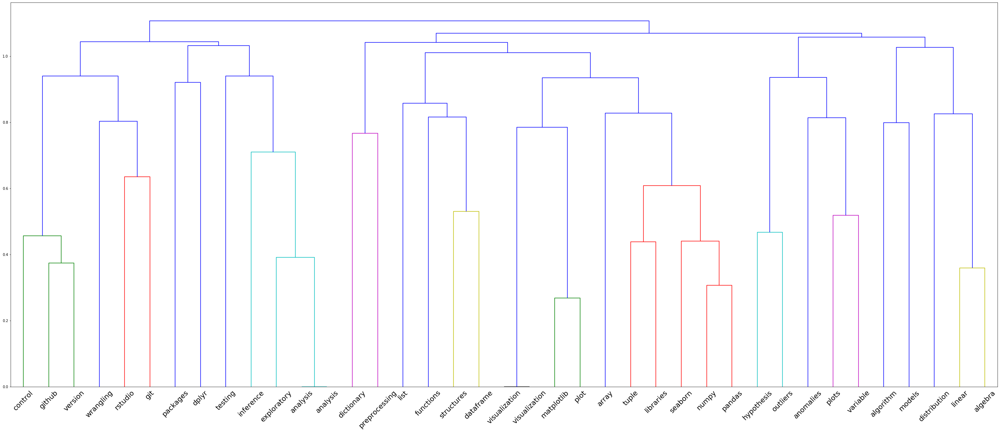

In [56]:
# Calculating the distance
dist = pdist(df_concepts.T, metric='euclidean')

# Calculating the linkage matrix
link = linkage(df_concepts.T, method='complete', metric='correlation')

# Draw the dendrogram
plt.figure(figsize=(50,20))
B=dendrogram(link, labels=df_concepts.columns, leaf_font_size=20)

### Programming

A fundamental course required not only as a basic skill, but also to bridge the gap between theoretical knowledge of statistics, data science, machine learning and practical implementation. Upon completion of the course, the student will be able to: 
* comfortably program in Python
* understand data structures and their uses
* use libraries such as numpy, pandas and seaborn with ease
* visualize given data
* understand and use version control effectively


#### COURSE OUTLINE

#### Module 1: An introduction to the snake

- Fundamentals: Variables, basic algebra
- Data structures: Lists, tuples, dictionaries
- Functions: Defining a function, input parameters, return statements, recursion
- Advanced operations: Aliasing, slicing, copying

#### Module 2: An introduction to snake libraries

- Numpy: arrays, reshaping, stacking, comparison with lists
- Pandas: series, dataframes, loading data, manipulating dataframes

#### Module 3: Version control (giving the snake a break)

- Necessity for version control
- Introduction to git
- Version control operations: stage, commit, push, revert, fetch, branch
- Github: Creating an account, uploading first repository

#### Module 4: Visualizing with the snake

- Basic plots: Matplotlib - plotting, essential charts
- Advanced plots: Seaborn -  additional plots, advanced operations
- Inference from visualization - identification of anomalies and outliers, trends, patterns, and relevant information

#### Module 5: You vs. snake

- Open-ended project. The user will choose a dataset from Kaggle, and derive useful insights from it. The goal is to get comfortable with all the libraries the user studied throughout the course. Creativity is, as always, encouraged.
- Essentials for the project: Pandas, matplotlib, seaborn.
- The user MUST use git, with periodic commits while working. The final github repository link should be shared with us.

# Data to back up above claim on best possible skills

- We use the Kaggle Salary dataset to obtain data on how many data scientists recommend the above skills, and how much salaries they earn with those skills

In [57]:
df = pd.read_csv('./Kaggle_Salary.csv')

In [58]:
df.head(2)

,Time from Start to Finish (seconds),Q1,Q2,Q2_OTHER_TEXT,Q3,Q4,Q5,Q5_OTHER_TEXT,Q6,Q7,Q8,Q9_Part_1,Q9_Part_2,Q9_Part_3,Q9_Part_4,Q9_Part_5,Q9_Part_6,Q9_Part_7,Q9_Part_8,Q9_OTHER_TEXT,Q10,Q11,Q12_Part_1,Q12_Part_2,Q12_Part_3,Q12_Part_4,Q12_Part_5,Q12_Part_6,Q12_Part_7,Q12_Part_8,Q12_Part_9,Q12_Part_10,Q12_Part_11,Q12_Part_12,Q12_OTHER_TEXT,Q13_Part_1,Q13_Part_2,Q13_Part_3,Q13_Part_4,Q13_Part_5,Q13_Part_6,Q13_Part_7,Q13_Part_8,Q13_Part_9,Q13_Part_10,Q13_Part_11,Q13_Part_12,Q13_OTHER_TEXT,Q14,Q14_Part_1_TEXT,Q14_Part_2_TEXT,Q14_Part_3_TEXT,Q14_Part_4_TEXT,Q14_Part_5_TEXT,Q14_OTHER_TEXT,Q15,Q16_Part_1,Q16_Part_2,Q16_Part_3,Q16_Part_4,Q16_Part_5,Q16_Part_6,Q16_Part_7,Q16_Part_8,Q16_Part_9,Q16_Part_10,Q16_Part_11,Q16_Part_12,Q16_OTHER_TEXT,Q17_Part_1,Q17_Part_2,Q17_Part_3,Q17_Part_4,Q17_Part_5,Q17_Part_6,Q17_Part_7,Q17_Part_8,Q17_Part_9,Q17_Part_10,Q17_Part_11,Q17_Part_12,Q17_OTHER_TEXT,Q18_Part_1,Q18_Part_2,Q18_Part_3,Q18_Part_4,Q18_Part_5,Q18_Part_6,Q18_Part_7,Q18_Part_8,Q18_Part_9,Q18_Part_10,Q18_Part_11,Q18_Part_12,Q18_OTHER_TEXT,Q19,Q19_OTHER_TEXT,Q20_Part_1,Q20_Part_2,Q20_Part_3,Q20_Part_4,Q20_Part_5,Q20_Part_6,Q20_Part_7,Q20_Part_8,Q20_Part_9,Q20_Part_10,Q20_Part_11,Q20_Part_12,Q20_OTHER_TEXT,Q21_Part_1,Q21_Part_2,Q21_Part_3,Q21_Part_4,Q21_Part_5,Q21_OTHER_TEXT,Q22,Q23,Q24_Part_1,Q24_Part_2,Q24_Part_3,Q24_Part_4,Q24_Part_5,Q24_Part_6,Q24_Part_7,Q24_Part_8,Q24_Part_9,Q24_Part_10,Q24_Part_11,Q24_Part_12,Q24_OTHER_TEXT,Q25_Part_1,Q25_Part_2,Q25_Part_3,Q25_Part_4,Q25_Part_5,Q25_Part_6,Q25_Part_7,Q25_Part_8,Q25_OTHER_TEXT,Q26_Part_1,Q26_Part_2,Q26_Part_3,Q26_Part_4,Q26_Part_5,Q26_Part_6,Q26_Part_7,Q26_OTHER_TEXT,Q27_Part_1,Q27_Part_2,Q27_Part_3,Q27_Part_4,Q27_Part_5,Q27_Part_6,Q27_OTHER_TEXT,Q28_Part_1,Q28_Part_2,Q28_Part_3,Q28_Part_4,Q28_Part_5,Q28_Part_6,Q28_Part_7,Q28_Part_8,Q28_Part_9,Q28_Part_10,Q28_Part_11,Q28_Part_12,Q28_OTHER_TEXT,Q29_Part_1,Q29_Part_2,Q29_Part_3,Q29_Part_4,Q29_Part_5,Q29_Part_6,Q29_Part_7,Q29_Part_8,Q29_Part_9,Q29_Part_10,Q29_Part_11,Q29_Part_12,Q29_OTHER_TEXT,Q30_Part_1,Q30_Part_2,Q30_Part_3,Q30_Part_4,Q30_Part_5,Q30_Part_6,Q30_Part_7,Q30_Part_8,Q30_Part_9,Q30_Part_10,Q30_Part_11,Q30_Part_12,Q30_OTHER_TEXT,Q31_Part_1,Q31_Part_2,Q31_Part_3,Q31_Part_4,Q31_Part_5,Q31_Part_6,Q31_Part_7,Q31_Part_8,Q31_Part_9,Q31_Part_10,Q31_Part_11,Q31_Part_12,Q31_OTHER_TEXT,Q32_Part_1,Q32_Part_2,Q32_Part_3,Q32_Part_4,Q32_Part_5,Q32_Part_6,Q32_Part_7,Q32_Part_8,Q32_Part_9,Q32_Part_10,Q32_Part_11,Q32_Part_12,Q32_OTHER_TEXT,Q33_Part_1,Q33_Part_2,Q33_Part_3,Q33_Part_4,Q33_Part_5,Q33_Part_6,Q33_Part_7,Q33_Part_8,Q33_Part_9,Q33_Part_10,Q33_Part_11,Q33_Part_12,Q33_OTHER_TEXT,Q34_Part_1,Q34_Part_2,Q34_Part_3,Q34_Part_4,Q34_Part_5,Q34_Part_6,Q34_Part_7,Q34_Part_8,Q34_Part_9,Q34_Part_10,Q34_Part_11,Q34_Part_12,Q34_OTHER_TEXT,Q10_Encoded,Q10_buckets
0,510,22-24,Male,-1,France,Master’s degree,Software Engineer,-1,"1000-9,999 employees",0,I do not know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1,"30,000-39,999",$0 (USD),Twitter (data science influencers),NaN,NaN,"Kaggle (forums, blog, social media, etc)",NaN,NaN,NaN,"Blogs (Towards Data Science, Medium, Analytics Vidhya, KDnuggets etc)","Journal Publications (traditional publications, preprint journals, etc)",NaN,NaN,NaN,-1,NaN,Coursera,NaN,DataCamp,NaN,Kaggle Courses (i.e. Kaggle Learn),NaN,Udemy,NaN,NaN,NaN,NaN,-1,"Basic statistical software (Microsoft Excel, Google Sheets, etc.)",0,-1,-1,-1,-1,-1,1-2 years,"Jupyter (JupyterLab, Jupyter Notebooks, etc)",RStudio,PyCharm,NaN,MATLAB,NaN,Spyder,NaN,NaN,NaN,NaN,NaN,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN,-1,Python,R,SQL,NaN,NaN,Java,Javascript,NaN,NaN,MATLAB,NaN,NaN,-1,Python,-1,NaN,Matplotlib,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1,CPUs,GPUs,NaN,NaN,NaN,-1,Never,1-2 years,Linear or Logistic Regression,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1,NaN,NaN,NaN,NaN,NaN,NaN,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN,-1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [59]:
list_of_columns = ['Q10']
for column in df.columns:
    if 'TEXT' not in column and '11' not in column and '12' not in column and ('Q18' in column or 'Q20' in column):
        list_of_columns.append(column)
print(list_of_columns)

df.drop(df.columns.difference(list_of_columns), 1, inplace=True)
df.fillna(value=0, inplace=True)

['Q10', 'Q18_Part_1', 'Q18_Part_2', 'Q18_Part_3', 'Q18_Part_4', 'Q18_Part_5', 'Q18_Part_6', 'Q18_Part_7', 'Q18_Part_8', 'Q18_Part_9', 'Q18_Part_10', 'Q20_Part_1', 'Q20_Part_2', 'Q20_Part_3', 'Q20_Part_4', 'Q20_Part_5', 'Q20_Part_6', 'Q20_Part_7', 'Q20_Part_8', 'Q20_Part_9', 'Q20_Part_10']


In [60]:
df.head(2)

,Q10,Q18_Part_1,Q18_Part_2,Q18_Part_3,Q18_Part_4,Q18_Part_5,Q18_Part_6,Q18_Part_7,Q18_Part_8,Q18_Part_9,Q18_Part_10,Q20_Part_1,Q20_Part_2,Q20_Part_3,Q20_Part_4,Q20_Part_5,Q20_Part_6,Q20_Part_7,Q20_Part_8,Q20_Part_9,Q20_Part_10
0,"30,000-39,999",Python,R,SQL,0,0,Java,Javascript,0,0,MATLAB,0,Matplotlib,0,0,0,0,0,0,0,0
1,"5,000-7,499",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [61]:
for column in df.columns:
    print(column, ': ', df[column].unique())

Q10 :  ['30,000-39,999' '5,000-7,499' '250,000-299,999' '4,000-4,999'
 '60,000-69,999' '10,000-14,999' '80,000-89,999' '$0-999' '2,000-2,999'
 '70,000-79,999' '90,000-99,999' '125,000-149,999' '40,000-49,999'
 '20,000-24,999' '15,000-19,999' '100,000-124,999' '7,500-9,999'
 '150,000-199,999' '25,000-29,999' '3,000-3,999' '1,000-1,999'
 '200,000-249,999' '50,000-59,999' '> $500,000' '300,000-500,000']
Q18_Part_1 :  ['Python' 0]
Q18_Part_2 :  ['R' 0]
Q18_Part_3 :  ['SQL' 0]
Q18_Part_4 :  [0 'C']
Q18_Part_5 :  [0 'C++']
Q18_Part_6 :  ['Java' 0]
Q18_Part_7 :  ['Javascript' 0]
Q18_Part_8 :  [0 'TypeScript']
Q18_Part_9 :  [0 'Bash']
Q18_Part_10 :  ['MATLAB' 0]
Q20_Part_1 :  [0 ' Ggplot / ggplot2 ']
Q20_Part_2 :  [' Matplotlib ' 0]
Q20_Part_3 :  [0 ' Altair ']
Q20_Part_4 :  [0 ' Shiny ']
Q20_Part_5 :  [0 ' D3.js ']
Q20_Part_6 :  [0 ' Plotly / Plotly Express ']
Q20_Part_7 :  [0 ' Bokeh ']
Q20_Part_8 :  [0 ' Seaborn ']
Q20_Part_9 :  [0 ' Geoplotlib ']
Q20_Part_10 :  [0 ' Leaflet / Folium ']


In [62]:
# Replace salary buckets with mid values

replace_dict = {}
for temp in df['Q10'].unique():
    salary = temp
    salary = salary.replace('$','').strip()
    salary = salary.replace('>','').strip()
    salary = salary.replace(',','').strip()
    if '-' not in salary:
        salary = float(salary)
    else:
        salary = (float(salary.split('-')[0]) + float(salary.split('-')[1])) / 2.0
    replace_dict[temp] = salary

df['Q10'].replace(replace_dict, inplace=True)
df.head()

,Q10,Q18_Part_1,Q18_Part_2,Q18_Part_3,Q18_Part_4,Q18_Part_5,Q18_Part_6,Q18_Part_7,Q18_Part_8,Q18_Part_9,Q18_Part_10,Q20_Part_1,Q20_Part_2,Q20_Part_3,Q20_Part_4,Q20_Part_5,Q20_Part_6,Q20_Part_7,Q20_Part_8,Q20_Part_9,Q20_Part_10
0,34999.5,Python,R,SQL,0,0,Java,Javascript,0,0,MATLAB,0,Matplotlib,0,0,0,0,0,0,0,0
1,6249.5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,274999.5,Python,R,SQL,0,0,0,0,0,Bash,0,Ggplot / ggplot2,Matplotlib,0,0,0,0,0,Seaborn,0,0
3,4499.5,Python,0,SQL,0,0,0,0,0,0,0,0,Matplotlib,0,0,0,Plotly / Plotly Express,0,Seaborn,0,0
4,64999.5,Python,R,0,0,0,0,0,0,0,0,Ggplot / ggplot2,0,0,0,0,0,0,0,0,0


In [63]:
#df = df[df['Q10'] >= 50000]

In [64]:
# Groups by unique values in each column to get the number of jobs that correspond to that skill

languages_list = []
visualization_list = []
languages_salaries = []
visualization_salaries = []
skill_count_dict = {}

for column in df.columns:
    if column == 'Q10':
        continue
    #print(column, ': ', df[column].unique())
    
    #Replace plotly/plotly express with plotly for brevity
    unique = 0
    for unique_val in df[column].unique():
        unique = unique_val if unique_val != 0 else unique
    #print(unique)
    
    skill_count_dict[unique] = df.groupby(column).count()['Q10'][unique]
    
    # This part is for later in the notebook
    if 'Plotly' in unique:
        unique = 'Plotly'
    
    if '18' in column:
        languages_list.append(unique)
        languages_salaries.append(df[df[column] != 0]['Q10'].mean(axis=0))
    else:
        visualization_list.append(unique)
        visualization_salaries.append(df[df[column] != 0]['Q10'].mean(axis=0))
    

In [65]:
skill_count_dict

{'Python': 9363,
 'R': 3652,
 'SQL': 5428,
 'C': 949,
 'C++': 1356,
 'Java': 1598,
 'Javascript': 1720,
 'TypeScript': 353,
 'Bash': 1763,
 'MATLAB': 962,
 ' Ggplot / ggplot2 ': 3274,
 ' Matplotlib ': 7507,
 ' Altair ': 141,
 ' Shiny ': 1110,
 ' D3.js ': 950,
 ' Plotly / Plotly Express ': 2566,
 ' Bokeh ': 870,
 ' Seaborn ': 4977,
 ' Geoplotlib ': 487,
 ' Leaflet / Folium ': 473}

In [66]:
total_jobs = df.shape[0]

## Percent of jobs that require each particular skill

In [67]:
for key in skill_count_dict:
    skill_count_dict[key] = round(skill_count_dict[key]/total_jobs * 100, 3)

skill_count_dict

{'Python': 74.922,
 'R': 29.223,
 'SQL': 43.434,
 'C': 7.594,
 'C++': 10.851,
 'Java': 12.787,
 'Javascript': 13.763,
 'TypeScript': 2.825,
 'Bash': 14.107,
 'MATLAB': 7.698,
 ' Ggplot / ggplot2 ': 26.198,
 ' Matplotlib ': 60.07,
 ' Altair ': 1.128,
 ' Shiny ': 8.882,
 ' D3.js ': 7.602,
 ' Plotly / Plotly Express ': 20.533,
 ' Bokeh ': 6.962,
 ' Seaborn ': 39.826,
 ' Geoplotlib ': 3.897,
 ' Leaflet / Folium ': 3.785}

### Python is at an astonishing 75%, while R and SQL are at 30% and 43% respectively.

### For visualization tools, Matplotlib is most recommended, with 60%, and Seaborn following with 40%

In [68]:
languages_percents = []
visualization_percents = []

for key in skill_count_dict:
    if key in languages_list:
        languages_percents.append(skill_count_dict[key])
    else:
        visualization_percents.append(skill_count_dict[key])
    

[Text(0, 0.5, 'Percentage'),
 Text(0.5, 0, 'Languages'),
 Text(0.5, 1.0, 'Languages recommended by data scientists')]

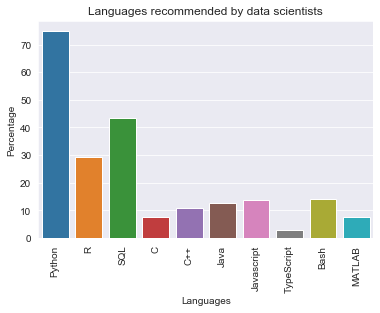

In [69]:
sns.set_style('darkgrid')
chart = sns.barplot(
    x=languages_list,
    y=languages_percents
)
chart.set_xticklabels(labels=languages_list, rotation=90)
chart.set(title='Languages recommended by data scientists', xlabel='Languages', ylabel='Percentage')

[Text(0, 0.5, 'Percentage'),
 Text(0.5, 0, 'Visualization Tools'),
 Text(0.5, 1.0, 'Visualization tools recommended by data scientists')]

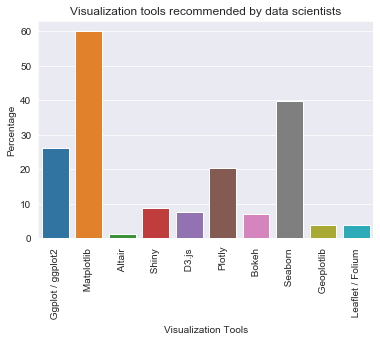

In [70]:
chart = sns.barplot(
    x=visualization_list,
    y=visualization_percents
)
chart.set_xticklabels(labels=visualization_list, rotation=90)
chart.set(title='Visualization tools recommended by data scientists', xlabel='Visualization Tools', ylabel='Percentage')

## Skills vs salaries

In [71]:
print(languages_salaries)
print(visualization_salaries)

[52917.58699134893, 59536.951533406354, 58314.216285924835, 51472.37723919916, 55059.614675516226, 50153.91833541927, 54370.87325581395, 63297.67138810198, 75339.55643788996, 50576.69282744283]
[57871.5276420281, 50526.61276142267, 79020.78723404255, 71408.7463963964, 72349.77684210526, 55643.79676539361, 68397.21321839081, 50741.668876833435, 49466.652977412734, 63126.88477801268]


[Text(0, 0.5, 'Percentage'),
 Text(0.5, 0, 'Languages'),
 Text(0.5, 1.0, 'Languages and average salaries')]

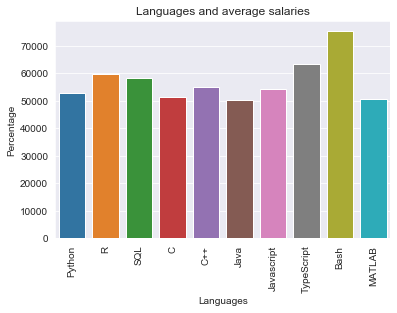

In [72]:
chart = sns.barplot(
    x=languages_list,
    y=languages_salaries
)
chart.set_xticklabels(labels=languages_list, rotation=90)
chart.set(title='Languages and average salaries', xlabel='Languages', ylabel='Percentage')

[Text(0, 0.5, 'Percentage'),
 Text(0.5, 0, 'Visualization Tools'),
 Text(0.5, 1.0, 'Visualization tools and average salaries')]

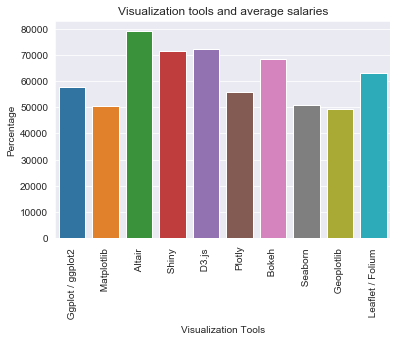

In [73]:
chart = sns.barplot(
    x=visualization_list,
    y=visualization_salaries
)
chart.set_xticklabels(labels=visualization_list, rotation=90)
chart.set(title='Visualization tools and average salaries', xlabel='Visualization Tools', ylabel='Percentage')

Note that while Matplotlib and seaborn seem to have lower salaries, this is simply because the other skills are extremely niche.

For a general data science job, knowing Altair visualization using Python is a very rare requirement, and is usually a skill that can be picked up during work.

Our focus is to gain the necessary skills to get a data science job.

## Pie chart visualization of recommended skills

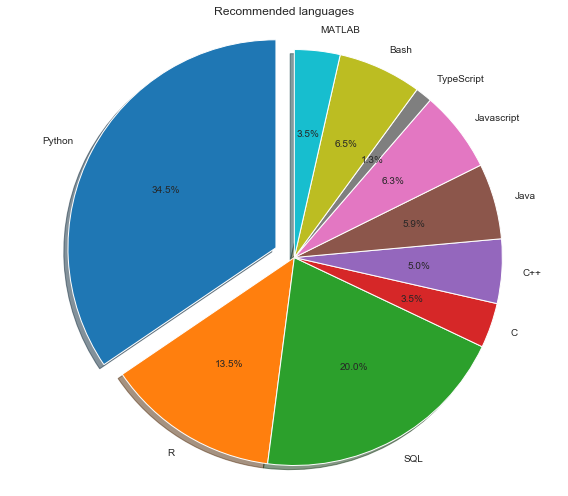

In [74]:
# Pie chart
labels = languages_list
sizes = languages_percents
# only "explode" the 2nd slice (i.e. 'Hogs')
explode = (0,) * len(labels)
explode = (0.1,) + explode[1:]
#add colors

fig1, ax1 = plt.subplots(figsize=(8, 7))
ax1.pie(sizes, explode=explode, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
# Equal aspect ratio ensures that pie is drawn as a circle
ax1.axis('equal')
plt.title('Recommended languages')
plt.tight_layout()
plt.show()

[' Ggplot / ggplot2 ', ' Matplotlib ', ' Altair ', ' Shiny ', ' D3.js ', 'Plotly', ' Bokeh ', ' Seaborn ', ' Geoplotlib ', ' Leaflet / Folium ']


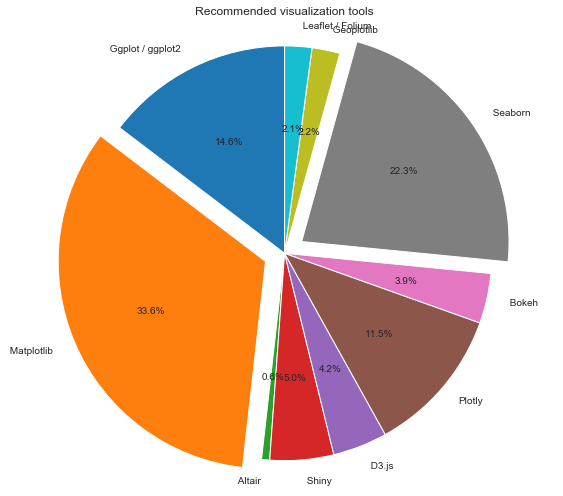

In [75]:
# Pie chart
labels = visualization_list
sizes = visualization_percents
# only "explode" the 2nd slice (i.e. 'Hogs')
explode = (0,0.1,0, 0, 0, 0,0,0.1, 0,0)
print(labels)
#add colors

fig1, ax1 = plt.subplots(figsize=(8, 7))
ax1.pie(sizes, explode=explode, labels=labels, autopct='%1.1f%%', startangle=90)
# Equal aspect ratio ensures that pie is drawn as a circle
ax1.axis('equal')
plt.title('Recommended visualization tools')
plt.tight_layout()
plt.show()

### Statistics Course Design



In [76]:
import requests
from bs4 import BeautifulSoup
import pandas as pd

In [77]:
import os
#import pandas dataframe package
import pandas as pd
#import re package for the use of regular expressions
import re
#import package for string handling
import string
try:
    import emoji #If tweepy is already installed on the system
except:
    !pip install emoji

#import nltk package for text processing
import nltk
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem.porter import PorterStemmer

import numpy as np
try:
    from wordcloud import WordCloud, STOPWORDS
except:
    !pip install wordcloud
    from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn.metrics import pairwise_distances
import unicodedata
import seaborn as sns
try: 
    import plotly.graph_objects as go   
except:
    !pip install plotly
    import plotly.graph_objects as go

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


### Web Scraping to get information on courses & modules

In [78]:
# job_listings_url_1 = 'https://www.classcentral.com/search?q=statistics&subject=business,data-science'
# job_listings_url_2 = 'https://www.classcentral.com/search?page=2&q=statistics&subject=business,data-science'
# job_listings_url_3 = 'https://www.classcentral.com/search?page=3&q=statistics&subject=business,data-science'
# job_listings_url_4 = 'https://www.classcentral.com/search?page=4&q=statistics&subject=business,data-science'

# response_1 = requests.get(job_listings_url_1)
# listingSoup_1 = BeautifulSoup(response_1.text, 'html.parser')

# response_2 = requests.get(job_listings_url_2)
# listingSoup_2 = BeautifulSoup(response_2.text, 'html.parser')

# response_3 = requests.get(job_listings_url_3)
# listingSoup_3 = BeautifulSoup(response_3.text, 'html.parser')

# response_4 = requests.get(job_listings_url_4)
# listingSoup_4 = BeautifulSoup(response_4.text, 'html.parser')

In [79]:
# all_links_1 = listingSoup_1.find_all('a', attrs={'class': 'color-charcoal block line-tight course-name'})
# all_links_2 = listingSoup_2.find_all('a', attrs={'class': 'color-charcoal block line-tight course-name'})
# all_links_3 = listingSoup_3.find_all('a', attrs={'class': 'color-charcoal block line-tight course-name'})
# all_links_4 = listingSoup_4.find_all('a', attrs={'class': 'color-charcoal block line-tight course-name'})
# all_links = all_links_1 + all_links_2 + all_links_3 + all_links_4

# # Links are relative, of the form /course/course_number. Need to append this to main host name
# web_pages = ['https://www.classcentral.com' + link.get('href') for link in all_links ]

In [80]:
# def getDescription(url):
#     response = requests.get(url)
#     jobSoup = BeautifulSoup(response.text, 'html.parser')
#     summary = jobSoup.find_all('div', attrs={'class': 'wysiwyg line-wide text-1 margin-bottom-large'})
#     return summary

# descriptions = [getDescription(page) for page in web_pages]

In [81]:
# all_descriptions = ['']*len(descriptions)
# for idx, each_job in enumerate(descriptions):
#     for description in each_job:
#         all_descriptions[idx] += description.text
        
# for i in range(len(all_descriptions)):
#     all_descriptions[i] = all_descriptions[i].strip()
    
# print(all_descriptions[0])

In [82]:
# len(web_pages)

In [83]:
# df_data = {'Link': web_pages , 'Description': all_descriptions}
# df = pd.DataFrame(df_data)
# df

In [84]:
# df_data = {'Link': web_pages, 'Description': all_descriptions}
# df = pd.DataFrame(df_data)

# df.to_csv('./programming_scraped.csv', index=False, header=True)
# df

In [85]:
df = pd.read_csv('./programming_scraped.csv')
df.head(2)

,Link,Description
0,https://www.classcentral.com/course/independent-dco042-python-for-informatics-1010,"This is a course to teach basic Python programming skills through data analysis. The book and course materials are all free and licensed as Creative Commons. There is no complex math in the course, the programs are generally quite short, and the workload is no more than a few hours per week. By the time you complete the course, you will understand be able to read, parse, and manipulate data using Python. Hopefully at the end of the course you will like programming well enough to take another course in programming or web development. You can register and launch, take the course, and earn your place on the map at any time and at your own pace"
1,https://www.classcentral.com/course/udacity-data-analysis-with-r-1478,"Exploratory data analysis is an approach for summarizing and visualizing the important characteristics of a data set. Promoted by John Tukey, exploratory data analysis focuses on exploring data to understand the data’s underlying structure and variables, to develop intuition about the data set, to consider how that data set came into existence, and to decide how it can be investigated with more formal statistical methods.If you're interested in supplemental reading material for the course check out the Exploratory Data Analysis book. (Not Required)This course is also a part of our Data Analyst Nanodegree.Why Take This Course?You will... Understand data analysis via EDA as a journey and a way to explore data Explore data at multiple levels using appropriate visualizations Acquire statistical knowledge for summarizing data Demonstrate curiosity and skepticism when performing data analysis Develop intuition around a data set and understand how the data was generated.\n\n\n\nLesson 1: What is EDA? (1 hour)We'll start by learn about what exploratory data analysis (EDA) is and why it is important. You'll meet the amazing instructors for the course and find out about the course structure and final project.Lesson 2: R Basics (3 hours)EDA, which comes before formal hypothesis testing and modeling, makes use of visual methods to analyze and summarize data sets. R will be our tool for generating those visuals and conducting analyses. In this lesson, we will install RStudio and packages, learn the layout and basic commands of R, practice writing basic R scripts, and inspect data sets.Lesson 3: Explore One Variable (4 hours)We perform EDA to understand the distribution of a variable and to check for anomalies and outliers. Learn how to quantify and visualize individual variables within a data set as we begin to make sense of a pseudo-data set of Facebook users. While the data set does not contain real user data, it does contain a wealth of information. Through the lesson, we will create histograms and boxplots, transform variables, and examine tradeoffs in visualizations.Problem Set 3 (2 hours)Lesson 4: Explore Two Variables (4 hours)EDA allows us to identify the most important variables and relationships within a data set before building predictive models. In this lesson, we will learn techniques for exploring the relationship between any two variables in a data set. We'll create scatter plots, calculate correlations, and investigate conditional means.Problem Set 4 (2 hours)Lesson 5: Explore Many Variables (4 hours)Data sets can be complex. In this lesson, we will learn powerful methods and visualizations for examining relationships among multiple variables. We'll learn how to reshape data frames and how to use aesthetics like color and shape to uncover more information. Extending our knowledge of previous plots, we'll continue to build intuition around the Facebook data set and explore some new data sets as well.Problem Set 5 (2 hours)Lesson 6: Diamonds and Price Predictions (2 hours)Investigate the diamonds data set alongside Facebook Data Scientist, Solomon Messing. He'll recap many of the strategies covered in the course an

### Data Cleaning & Preparation


In [86]:
def ProcessText(tweet):
        
    
    #start by tokenize the tweet (separate it the text into words, or n-grams) with nltk
    word_tokens = word_tokenize(tweet) 
 
    #convert text into lowercase
    word_tokens = [word.lower() for word in word_tokens]
    
    #remove punctuation signs from tokens
    table = str.maketrans('', '', string.punctuation)
    word_tokens = [word.translate(table) for word in word_tokens]
    
    #remove non-alphabetic characters
    word_tokens = [word for word in word_tokens if word.isalpha()]
    
    #remove stopwords
    stop_words = set(stopwords.words('english')) #import a predefined set of stopwords from the nltk package
    word_tokens = [word for word in word_tokens if not word in stop_words]

    clean_tweet = [] #create empty list to store the final tokens after text processing
    for w in word_tokens:
        clean_tweet.append(w)

    #join the tokens of the clean tweet back into a string with spaces in between
    clean_tweet_str = ' '.join(clean_tweet)
    
    #return the clean tweet string
    return clean_tweet_str  

In [87]:
processedTextList = []
for desc in df['Description']:
    temp = ProcessText(desc)
    processedTextList.append(temp)
df['Processed Description'] = processedTextList

In [88]:
df.head()

,Link,Description,Processed Description
0,https://www.classcentral.com/course/independent-dco042-python-for-informatics-1010,"This is a course to teach basic Python programming skills through data analysis. The book and course materials are all free and licensed as Creative Commons. There is no complex math in the course, the programs are generally quite short, and the workload is no more than a few hours per week. By the time you complete the course, you will understand be able to read, parse, and manipulate data using Python. Hopefully at the end of the course you will like programming well enough to take another course in programming or web development. You can register and launch, take the course, and earn your place on the map at any time and at your own pace",course teach basic python programming skills data analysis book course materials free licensed creative commons complex math course programs generally quite short workload hours per week time complete course understand able read parse manipulate data using python hopefully end course like programming well enough take another course programming web development register launch take course earn place map time pace
1,https://www.classcentral.com/course/udacity-data-analysis-with-r-1478,"Exploratory data analysis is an approach for summarizing and visualizing the important characteristics of a data set. Promoted by John Tukey, exploratory data analysis focuses on exploring data to understand the data’s underlying structure and variables, to develop intuition about the data set, to consider how that data set came into existence, and to decide how it can be investigated with more formal statistical methods.If you're interested in supplemental reading material for the course check out the Exploratory Data Analysis book. (Not Required)This course is also a part of our Data Analyst Nanodegree.Why Take This Course?You will... Understand data analysis via EDA as a journey and a way to explore data Explore data at multiple levels using appropriate visualizations Acquire statistical knowledge for summarizing data Demonstrate curiosity and skepticism when performing data analysis Develop intuition around a data set and understand how the data was generated.\n\n\n\nLesson 1: What is EDA? (1 hour)We'll start by learn about what exploratory data analysis (EDA) is and why it is important. You'll meet the amazing instructors for the course and find out about the course structure and final project.Lesson 2: R Basics (3 hours)EDA, which comes before formal hypothesis testing and modeling, makes use of visual methods to analyze and summarize data sets. R will be our tool for generating those visuals and conducting analyses. In this lesson, we will install RStudio and packages, learn the layout and basic commands of R, practice writing basic R scripts, and inspect data sets.Lesson 3: Explore One Variable (4 hours)We perform EDA to understand the distribution of a variable and to check for anomalies and outliers. Learn how to quantify and visualize individual variables within a data set as we begin to make sense of a pseudo-data set of Facebook users. While the data set does not contain real user data, it does contain a wealth of information. Through the lesson, we will create histograms and boxplots, transform variables, and examine tradeoffs in visualizations.Problem Set 3 (2 hours)Lesson 4: Explore Two Variables (4 hours)EDA allows us to identify the most important variables and relationships within a data set before building predictive models. In this lesson, we will learn techniques for exploring the relationship between any two variables in a data set. We'll create scatter plots, calculate correlations, and investigate conditional means.Problem Set 4 (2 hours)Lesson 5: Explore Many Variables (4 hours)Data sets can be complex. In this lesson, we will learn powerful methods and visualizations for examining relationships among multiple variables. We'll learn how to reshape data frames an

### Data Visualization

In [89]:
def generateWordCloud(strInput):
    wordcloud = WordCloud(width = 800, height = 800, 
                    background_color ='white',  
                    min_font_size = 10).generate(strInput) 

    # plot the WordCloud image                        
    plt.figure(figsize = (8, 8), facecolor = 'black') 
    plt.imshow(wordcloud) 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 

    plt.show() 

In [90]:
strForWC = ""
for desc in processedTextList:
    for text in desc:
        strForWC = strForWC + text

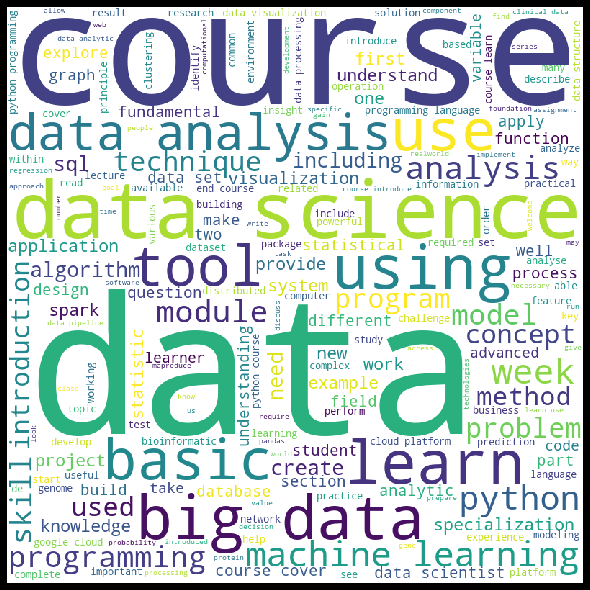

In [91]:
generateWordCloud(strForWC)

Now let's get rid of some words such as week, module, course, learn, etc. that don't necessarily contribute to our design of course concepts. 

In [92]:
strForWC = ""
for desc in processedTextList:
    wordList = desc.split()
    for word in wordList:
        if (word not in ['week','module','learn','week','using','data','course','use','model']):
            strForWC = strForWC + word + ' '

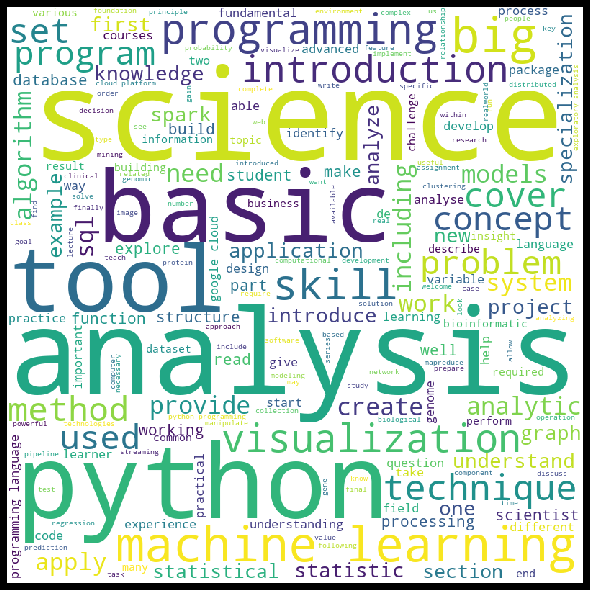

In [93]:
generateWordCloud(strForWC)

### Constructing course curriculum from descriptions

We need to search the relevant course concepts from the descriptions.

In [94]:
df['Processed Description'][0]

'course teach basic python programming skills data analysis book course materials free licensed creative commons complex math course programs generally quite short workload hours per week time complete course understand able read parse manipulate data using python hopefully end course like programming well enough take another course programming web development register launch take course earn place map time pace'

In [95]:
#Create a lit of course concepts that need to be searched
statistics_concepts = ['six sigma', 'bayesian', 'probability', 'excel','statistical inference','binomial','regression','confidence intervals', 'process map', 'business strategy', 'software', 'distribution'
                     'forecast', 'r', 'python', 'moving average', 'hypothesis','arima', 'machine learning','data analysis', 'programming', 'root cause analysis', 
                       'correlation','design experiments', 'central limit theorem','anova', 'control limits', 'hypothesis testing', 'significance', 'spc','statistical process control'
                      'predictive analytics', 'descriptive statistics', 'dimensionality reduction', 'inferential statistics','sampling','random sampling', 'bayes', 'risk analytics']

In [96]:
def detect_tool(table, concepts):
    # Initialize a word frequency table
    concept_table=pd.DataFrame(columns = concepts, index=range(len(table)), dtype=int)
    
    for concept in concepts:
        concept_table[concept] = np.zeros(len(concept_table))
        
    # Phrase detector
    for i in range(len(table)):
        text = table.iloc[i]
        
        # Extract the common concepts and calculate the word frequency
        for concept in concepts:
            if (re.findall(re.escape(concept), str(text)) != []):
                concept_table.loc[i, concept]=int(len(re.findall(re.escape(concept), text)))
    
    return concept_table

In [97]:
df_concepts = detect_tool(df['Processed Description'], statistics_concepts)

In [98]:
df_concepts = df_concepts.loc[:, (df_concepts != 0).any(axis=0)]

### Clustering concepts into modules using unsupervised clustering dendrogram

In [99]:
# Calculating the distance
dist = pdist(df_concepts.T, metric='euclidean')

In [100]:
# Calculating the linkage matrix
link = linkage(df_concepts.T, method='complete', metric='correlation')

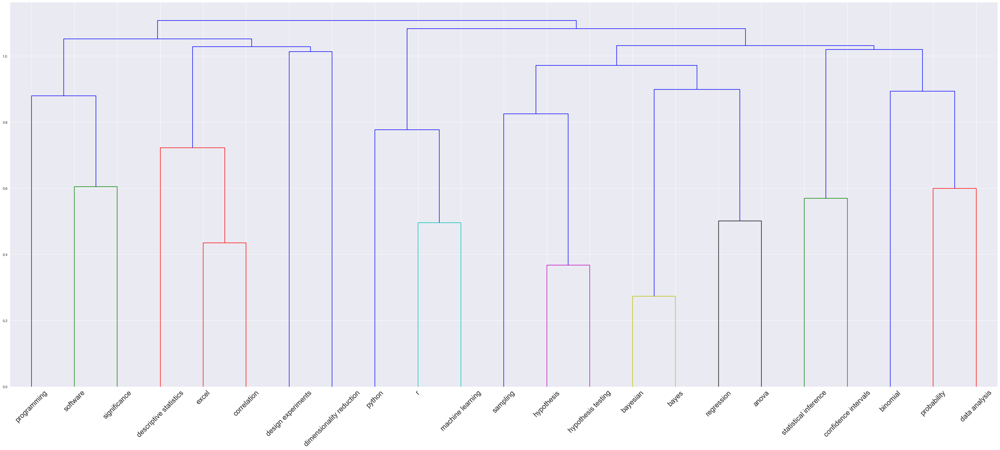

In [101]:
# Draw the dendrogram
plt.figure(figsize=(50,20))
B=dendrogram(link, labels=df_concepts.columns, leaf_font_size=20)

The above dendrogram will be used as a thumb-rule when it comes to constructing the course outline for the Statistics course. It is to be noted that the dendrogram will not be followed to the tee but as a guide coupled with the course designer's intuition and understanding of Statistics and natural grouping of concepts. Hierarchical clustering is not fool-proof since the model is not aware of the inherent relationships between concepts.

### Statistics for Data Science & Business 

An industry-oriented statistics course geared towards bringing beginners & intermediate level practitioners up to speed with the fundamentals of Statistics. Concepts will be covered from scratch and no pre-requisites are required. Special emphasis will be placed on statistical software packages such as SPSS, SAS, R, etc. and programming languages with practical problems & applications to provde an experential learning experience.

#### COURSE OUTLINE

#### Module 1: Fundamentals of Statistics

- Descriptive Statistics - Mean, Median and Mode. Sampling - Random Sampling techniques. 
- Bayes Theorem, Bayesian Probability, Statistical Inference, Confidence Intervals. 
- Hypothesis Testing, Correlation, Regression, Distributions, Probability, Binomial Theorem, Statistical Significance (including Chi-Squared Testing).
- Introduction to Statistical Software such as SPSS, SAS, R, etc. 

#### Module 2: Statistics in the Industry

- Six Sigma techniques: Pareto chart, Histogram, Barplot, Scatterplot, Checksheet
- Why-why analysis, Root Cause Analysis, Process Maps
- Control Charts and Statistical Process Control (SPC)
- Design of Experiments
- Some practical exercises on Excel & R

#### Module 3: Advanced Statistical Methods
- Time Series Analysis: ARIMA and Moving Average
- Dimensionality Reduction
- ANOVA
- Factorial Design

#### Module 4: Applied Statistics for Data Science, Machine Learning & Business

- Intro to Data Science & Machine Learning 
- Data Analysis techniques 
- Business Strategy & Intelligence
- Role of Data Visualization in business - graphs, plots and charts


### Data Visualizations

In [102]:
df_kaggle = pd.read_csv(r'Kaggle_Salary.csv', low_memory=False)

In [103]:
DataAnalysis = df_kaggle['Q9_Part_1'].count()

DataInfra = df_kaggle['Q9_Part_2'].count()

BuildProto = df_kaggle['Q9_Part_3'].count()

df_kaggle['Q9_Part_3'].count()

BuildMLService = df_kaggle['Q9_Part_4'].count()

ImprovingMLmethods = df_kaggle['Q9_Part_5'].count()

MLResearch = df_kaggle['Q9_Part_6'].count()

NoneOftheseActivities = df_kaggle['Q9_Part_7'].count()

Others = df_kaggle['Q9_Part_8'].count()

In [111]:
responseShare = [DataAnalysis, DataInfra, BuildProto, BuildMLService, ImprovingMLmethods, MLResearch, NoneOftheseActivities,Others ]
pieLabels = ['Data Analysis', 'Data Infrastructure', 'Build ML prototypes', 'Build ML service', 'Improve ML', 'ML Research', 'None',' Others']

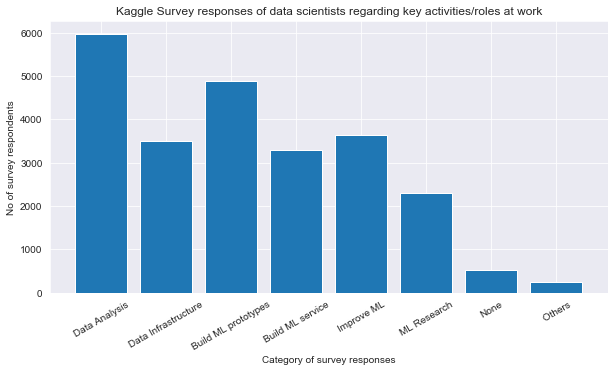

In [112]:
index = np.arange(len(pieLabels))

fig = plt.figure(figsize=(10, 5))

fig = plt.bar(index, responseShare)
plt.xlabel('Category of survey responses', fontsize=10)
plt.ylabel('No of survey respondents', fontsize=10)
plt.xticks(index, pieLabels, fontsize=10, rotation=30)
plt.title('Kaggle Survey responses of data scientists regarding key activities/roles at work')
plt.show()

Text(0, 0.5, '')

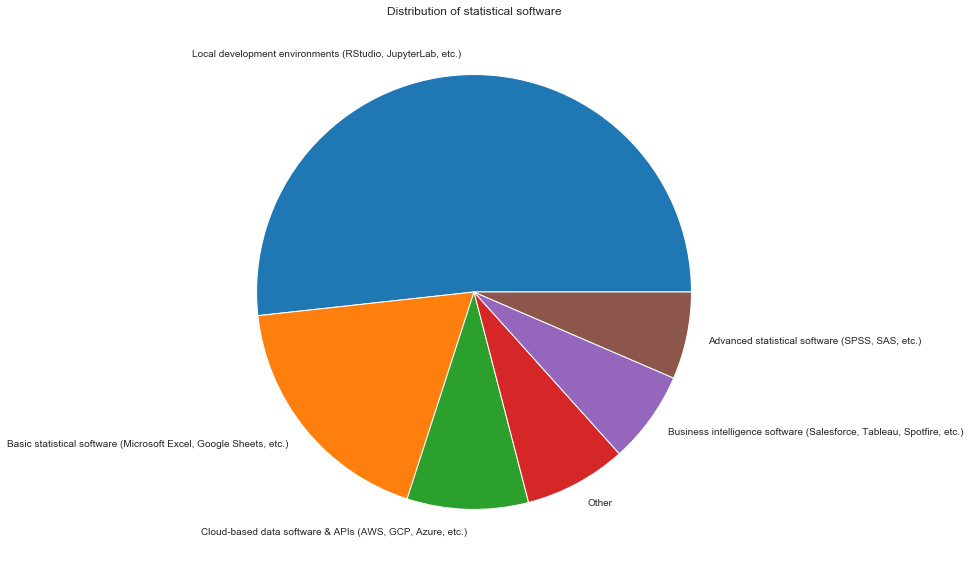

In [113]:
fig = plt.figure(figsize=(10, 10))
plt.title('Distribution of statistical software')
df_kaggle['Q14'].value_counts().plot(kind = 'pie')
#plt.xlabel('Category of survey responses', fontsize=10)
plt.ylabel('', fontsize=10)
#plt.xticks(index, pieLabels, fontsize=10, rotation=30)

In [114]:
df_kaggle['Q14'].value_counts()

Local development environments (RStudio, JupyterLab, etc.)              5925
Basic statistical software (Microsoft Excel, Google Sheets, etc.)       2094
Cloud-based data software & APIs (AWS, GCP, Azure, etc.)                1033
Other                                                                   871 
Business intelligence software (Salesforce, Tableau, Spotfire, etc.)    787 
Advanced statistical software (SPSS, SAS, etc.)                         742 
Name: Q14, dtype: int64

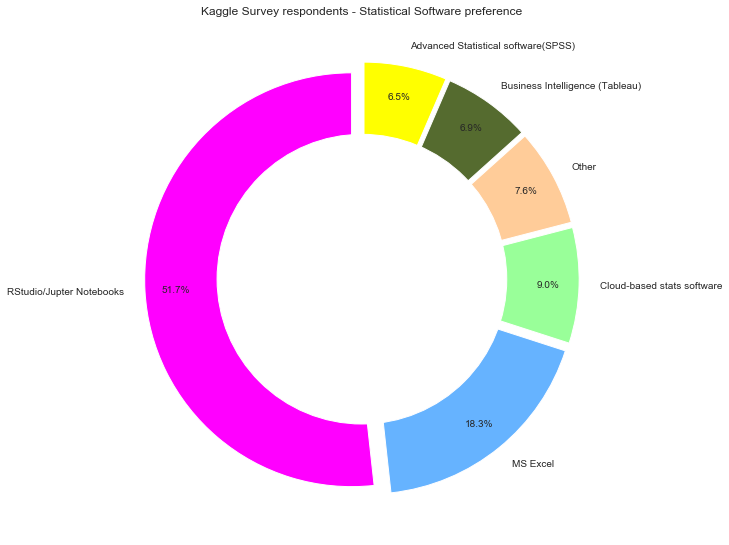

In [115]:
# Pie chart
labels = ['RStudio/Jupter Notebooks', 'MS Excel', 'Cloud-based stats software', 'Other', 'Business Intelligence (Tableau)', 'Advanced Statistical software(SPSS)']
sizes = [5925, 2094, 1033, 871, 787, 742]
#colors
colors = ['fuchsia','#66b3ff','#99ff99','#ffcc99', 'darkolivegreen', 'yellow']
#explsion
explode = (0.05,0.05,0.05,0.05,0.05,0.05)
fig = plt.figure(figsize=(10, 10)) 
plt.pie(sizes, colors = colors, labels=labels, autopct='%1.1f%%', startangle=90, pctdistance=0.85, explode = explode)
#draw circle
centre_circle = plt.Circle((0,0),0.70,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
plt.title('Kaggle Survey respondents - Statistical Software preference')
# Equal aspect ratio ensures that pie is drawn as a circle
#ax1.axis('equal')  
plt.tight_layout()
plt.show()

In [116]:
 df_kaggle['Q20_Part_1'].value_counts()

Matplotlib = df_kaggle['Q20_Part_2'].value_counts()

Altair = df_kaggle['Q20_Part_3'].value_counts()

Shiny = df_kaggle['Q20_Part_4'].value_counts()

df_kaggle['Q20_Part_5'].value_counts()

Plotly = df_kaggle['Q20_Part_6'].value_counts()

df_kaggle['Q20_Part_6'].value_counts()

df_kaggle['Q20_Part_7'].value_counts()

df_kaggle['Q20_Part_8'].value_counts()

df_kaggle['Q20_Part_9'].value_counts()

df_kaggle['Q20_Part_10'].value_counts()

df_kaggle['Q20_Part_11'].value_counts()

df_kaggle['Q20_Part_12'].value_counts()

Ggplot = df_kaggle['Q20_Part_1'].count()

Matplotlib = df_kaggle['Q20_Part_2'].count()

Seaborn = df_kaggle['Q20_Part_8'].count()

Plotly = df_kaggle['Q20_Part_6'].count()

Others = df_kaggle['Q20_Part_4'].count() + df_kaggle['Q20_Part_9'].count() + df_kaggle['Q20_Part_10'].count() + df_kaggle['Q20_Part_12'].count() + df_kaggle['Q20_Part_7'].count()

In [117]:
labels = ['Ggplot','Matplotlib','Seaborn','Plotly','Others']
values = [Ggplot,Matplotlib,Seaborn,Plotly,Others]
fig = plt.figure(figsize=(5, 5)) 
# Use `hole` to create a donut-like pie chart
fig = go.Figure(data=[go.Pie(labels=labels, values=values, hole=.3)])

fig.show()

<Figure size 360x360 with 0 Axes>

### Intro to Data Science Course Design

In [118]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
import numpy as np
import re
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn.metrics import pairwise_distances
import matplotlib.pyplot as plt
#from selenium import webdriver
#from selenium.webdriver.common.keys import Keys
import time
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier
import seaborn as sns

#import nltk package for text processing
import nltk
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem.porter import PorterStemmer

import string
try:
    import emoji #If tweepy is already installed on the system
except:
    !pip install emoji

try:
    from wordcloud import WordCloud, STOPWORDS
except:
    !pip install wordcloud
    from wordcloud import WordCloud, STOPWORDS


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [124]:
# !apt install chromium-chromedriver

'apt' is not recognized as an internal or external command,
operable program or batch file.


In [120]:
# !pip install selenium

In [121]:
# from google.colab import drive
# drive.mount('/content/drive')
# import os
# os.chdir('/content/drive/My Drive/MIE1624/MIE1624-Course Project/CSVs')

ModuleNotFoundError: No module named 'google'

# 1. Data Preparation and Cleaning

## 1.1 Web-Scrapping the introductory data science courses from classcentral

In [125]:
# options = webdriver.ChromeOptions()
# options.add_argument('--headless')
# options.add_argument('--no-sandbox')
# options.add_argument('--disable-dev-shm-usage')

# wd = webdriver.Chrome('chromedriver',options=options)
# wd.get("https://www.classcentral.com/search?page=3&q=introduction+to+data+science")

# for iteration in range(0,20):
#   button = wd.find_elements_by_xpath("//*[@id='page-search']/div[1]/div/section/div/div[2]/div/button")[0]
#   button.click()
#   time.sleep(0.5)

# listingSoup = BeautifulSoup(wd.page_source, 'html.parser')
# all_links = listingSoup.find_all('a', attrs={'class': 'color-charcoal block line-tight course-name'})

# # Links are relative, of the form /course/course_number. Need to append this to main host name
# web_pages = ['https://www.classcentral.com' + link.get('href') for link in all_links]


In [126]:
# def getDescription(url):
#     response = requests.get(url)
#     jobSoup = BeautifulSoup(response.text, 'html.parser')
#     summary = jobSoup.find_all('div', attrs={'class': 'wysiwyg line-wide text-1 margin-bottom-large'})
#     return summary

# descriptions = [getDescription(page) for page in web_pages]

In [127]:
# def getTitle(url):
#     response = requests.get(url)
#     jobSoup = BeautifulSoup(response.text, 'html.parser')
#     summary = jobSoup.find_all(id='course-title', attrs={'class': 'head-2 medium-up-head-1 margin-bottom-xxsmall'})
#     return summary
# course_title = [getTitle(page) for page in web_pages]

In [128]:
# all_descriptions = ['']*len(descriptions)
# for idx, each_job in enumerate(descriptions):
#     for description in each_job:
#         all_descriptions[idx] += description.text
        
# for i in range(len(all_descriptions)):
#     all_descriptions[i] = all_descriptions[i].strip()

In [129]:
# all_title = ['']*len(course_title)
# for idx, each_job in enumerate(course_title):
#     for title in each_job:
#         all_title[idx] += title.text
        
# for i in range(len(all_title)):
#     all_title[i] = all_title[i].strip()

In [130]:
# df_data = {'Link': web_pages, 'Description': all_descriptions, 'Course Title': all_title}
# df = pd.DataFrame(df_data)
# df

## 1.2 Define the skills sets

In [131]:
# df.to_csv('class_central.csv', index=False)

In [133]:
df=pd.read_csv('class_central.csv', low_memory=False)
skills = ['data architecture',
'programming',
'machine learning',
'ai',
'mathematics',
'communication',
'critical thinking',
'visualization',
'master',
'phd',
'bachelor',
'business decisions',
'modeling',
'cloud',
'jupyter',
'rstudio',
'pycharm',
'matlab',
'visual studio',
'spyder',
'vim',
'sublime',
'google colab',
'google cloud',
'datalab',
'ocean',
'python',
'r',
'sql',
'c',
'c++',
'java',
'javascript',
'typescript',
'bash',
'ggplot',
'matplotlib',
'plotly',
'd3',
'shiny',
'seaborn',
'geoplotlib',
'leaflet',
'linear',
'logistic',
'regression',
'gradient descent',
'bayesian',
'neural networks',
'transformer',
'augmentation',
'automated',
'feature engineering',
'selection',
'architecture',
'pipelines',
'image',
'video',
'pil',
'cv2',
'skimage',
'u-net',
'mask r-cnn',
'image segmentation', 
'object detection',
'yolov3',
'retinanet',
'image classification',
'vgg',
'inception',
'resnet',
'gan',
'vae',
'computer vision',
'generative networks',
'word embeddings',
'vectors',
'glove',
'word2ve',
'encoder',
'decorder',
'vanilla',
'contextualized embeddings',
'elmo',
'cove',
'gpt-2',
'bert',
'xlnet',
'scikit-learn',
'tensorflow',
'keras',
'randomforest',
'xgboost',
'decision tree',
'pyTorch',
'caret',
'lightgbm',
'spark mlib',
'fast.ai',
'amazon',
'azure',
'salesforce',
'alibaba',
'aws',
'excel',
'team spirit',
'deep learning',
'web scraping',
'data cleaning',
'data exploration',
'distribution',
'cross-validation',
'supervised learning',
'unsupervised learning',
'hyperparameter tuning',
'spark',
'hadoop',
'monte carlo',
'ensemble',
'sentiment analysis',
'team work',
'consulting',
'creativity',
'statistics',
'sas',
'databases',
'spss'
]

In [134]:
skills = list(set(skills))
unwanted=['spyder', 'critical thinking', 'monte carlo', 'business decisions', 'automated', 'azure', 'gan', 'video', 'selection', 'alibaba', 'typescript', 'pil', 'bert', 'atom', 'vae', 'ocean', 'glove', 'elmo', 'sublime', 'transformer', 'pipelines', 'vectors', 'spider']
for value in unwanted:
  if value in skills:
    skills.remove(value)

## 1.3 Construct the word frequency table

In [135]:
def detect_tool(table, skills):
  # Initialize a word frequency table
  skill_table=pd.DataFrame(columns=skills, index=range(len(table)), dtype=int)
  for skill in skills:
    skill_table[skill] = np.zeros(len(skill_table))
  # Phrase detector
  for i in range(len(table)):
    text=table.iloc[i, 1].lower()
    # Remove the html tags
    re.sub(r'<[^<]+?>','', str(text))
    # Extract the common skills and calculate the word frequency
    for skill in skills:
      if (re.findall(re.escape(skill), str(text))!= []):
        skill_table.loc[i, skill]=int(len(re.findall(re.escape(skill), text)))
  return skill_table

In [139]:
df_sk=detect_tool(df, skills)
df_sk

,inception,contextualized embeddings,bachelor,architecture,r,sql,regression,aws,mask r-cnn,matplotlib,sas,decision tree,supervised learning,python,yolov3,java,fast.ai,u-net,databases,c,web scraping,shiny,scikit-learn,leaflet,cv2,encoder,image classification,consulting,bayesian,vim,image segmentation,unsupervised learning,geoplotlib,vanilla,cove,creativity,distribution,gpt-2,phd,linear,hyperparameter tuning,c++,retinanet,xgboost,visualization,gradient descent,ai,augmentation,pyTorch,spss,rstudio,spark mlib,javascript,master,tensorflow,google colab,skimage,google cloud,word embeddings,salesforce,deep learning,spark,image,caret,jupyter,randomforest,data exploration,vgg,mathematics,communication,hadoop,programming,ggplot,resnet,logistic,word2ve,generative networks,team work,statistics,datalab,modeling,team spirit,visual studio,seaborn,excel,amazon,xlnet,machine learning,decorder,ensemble,keras,object detection,lightgbm,cross-validation,matlab,feature engineering,cloud,data cleaning,d3,plotly,pycharm,bash,sentiment analysis,neural networks,data architecture,computer vision
0,0.0,0.0,0.0,0.0,523.0,3.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,359.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,9.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,14.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,57.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,38.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,140.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,108.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,134.0,0.0,4.0,0.0,0.0,0.0,0.0,1.0,2.0,5.0,0.0,0.0,0.0,0.0,0.0,90.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,0.0,0.0,0.0,0.0,205.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,136.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,62.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,36.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0,158.0,13.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,108.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,

## 1.3 Drop the unnecessary skills if possible

In [137]:
# Chose the skills by frequency
sets=df_sk.sum(axis=0)
sets=sets[sets<=30].index.tolist()

In [138]:
# drop the skills with all 0 values
df_sk = df_sk.loc[:, (df_sk != 0).any(axis=0)]

In [140]:
df_sk=df_sk.drop(columns=sets)

In [141]:
df_sk

,architecture,r,sql,regression,aws,sas,decision tree,supervised learning,python,java,databases,c,bayesian,cove,distribution,linear,c++,visualization,ai,javascript,master,tensorflow,google cloud,deep learning,spark,image,jupyter,mathematics,communication,hadoop,programming,logistic,statistics,modeling,excel,amazon,machine learning,ensemble,cloud,neural networks
0,0.0,523.0,3.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,359.0,0.0,9.0,0.0,0.0,0.0,2.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,14.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,0.0,57.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,38.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,140.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,108.0,0.0,3.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,134.0,0.0,4.0,0.0,0.0,1.0,2.0,5.0,0.0,0.0,90.0,0.0,3.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,0.0,0.0,0.0,8.0,2.0,0.0,1.0
4,0.0,205.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,136.0,0.0,2.0,0.0,0.0,0.0,0.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
5,0.0,62.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,36.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.0,158.0,13.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,108.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.0,81.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,37.0,0.0,3.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
8,0.0,109.0,1.0,3.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,127.0,0.0,5.0,0.0,1.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,5.0,0.0,1.0,0.0
9,0.0,41.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,36.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,0.0,0.0,0.0


# 2. Investigate the correlation in between skills by hierachy clusttering

In [142]:
# Calculating the distance
dist=pdist(df_sk.T, metric='euclidean')

In [143]:
# Calculating the linkage matrix
link = linkage(df_sk.T, method='complete', metric='correlation')

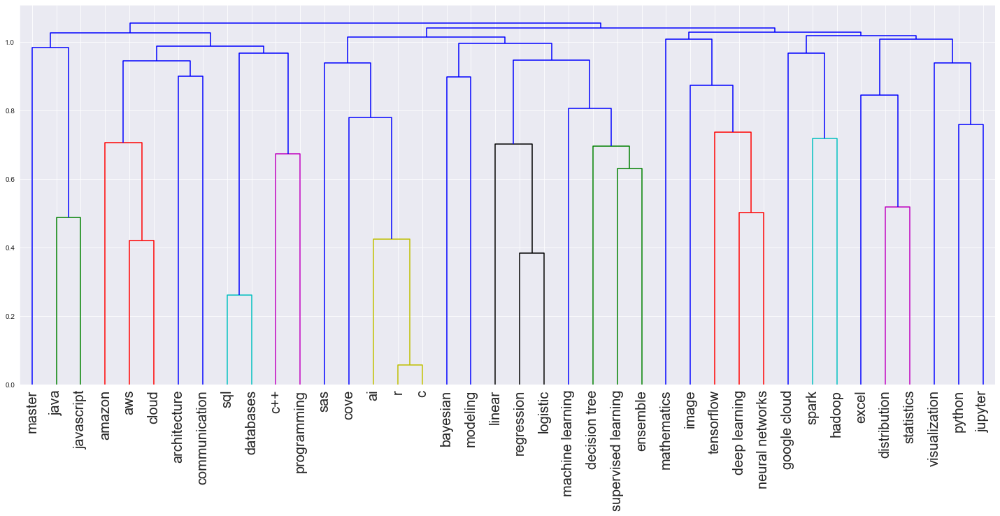

In [144]:
# Draw the dendrogram
plt.figure(figsize=(25,10))
B=dendrogram(link, labels=df_sk.columns, leaf_font_size=20, leaf_rotation=90)

# 3. Course Curriculum Design

# **Introduction to Data Science**

## **Overview**
This course will teach you how to use computation to accomplish a variety of goals and provides you with a brief introduction to a variety of topics in computational problem solving. The course will introduce the data manipulation and cleaning techniques using the popular python libraries. The statistical and mathematical theories behind the most popular machine learning algorithms will also be discussed. By the end of this course, students will be able to apply the covered topics in this course to come up with the practical solutions for several real-world projects.

## **Syllabus**
**Module 1 Introduction to data science in Python**

* Python essentials: Lists, Tuples, Dictionaries, Functions
* Python libraries: pandas, numpy
*	Environment: Jupyter, Colab, Anaconda

**Module 2 Linear algebra and statistics basics**
*	Linear algebra: matrices, linear equation, vector spaces, eigenvalues and eigenvectors
*	Basic statistics: distributions, hypothesis test, comparing means(t-test, ANOVA)

**Module 3 Data Visualization**
*	R: RStudio, ggplot, leaflet
*	Python: matplotlib, seaborn, D3

**Module 4: Data Management**
*	Databases, data structures
*	SQL, noSQL

**Module 5: Distributed and Cloud Computing**
*	Big data analytics: spark and hadoop
* Could computing: Amazon Web Services (AWS)

**Module 6: Modeling Techniques – Regression**
*	Linear regression
*	Logistic Regression
*	Regression case studies

**Module 7: Machine Learning I – Unsupervised Learning**
*	Preprocessing and Scaling: Feature engineering, Principle Component Analysis.
*	Clustering methods: k-means, agglomerative and DBSCAN

**Module 8: Machine Learning II – Supervised Leaning**
*	Classification I: Logistic regression, k-NN, Support Vector Machines (SVM)
*	Classification II: Decision Trees, Ensemble Learning and Random Forest.

**Module 9: Machine Learning III – Model Evaluation**
*	Cross-validation, grid-search, bias-variance tradeoff, evaluation metrics (lift, ROC/AUC curves, confusion matrix, profiling), scoring.

**Module 10: Artificial Neutral Networks and Deep Learning**
*	Introduction: Artificial Neural Networks (ANN), Recurrent Neural Networks (RNN) and Long-Short Term Memory (LSTM)
*	Model Optimization: Gradient Descent, Hyperparameters Tuning, Bias-Variance Tradeoff
*	Libraries: Tensorflow, Pytorch


# 4. Visualizations of the job market to support the course curriculum

In [145]:
df_final=pd.read_csv('final.csv', low_memory=False)
df=pd.read_csv('kaggle.csv')

## 4.1 Pie chart

### 4.1.1 How different IDEs are demanded by market

In [146]:
df_soft=df.iloc[:, 44:56]
df_soft.head()

,Q16_Part_1,Q16_Part_2,Q16_Part_3,Q16_Part_4,Q16_Part_5,Q16_Part_6,Q16_Part_7,Q16_Part_8,Q16_Part_9,Q16_Part_10,Q16_Part_11,Q16_Part_12
0,1,1,1,0,1,0,1,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,0,1,0,0,0,0,0,0
3,1,0,0,0,0,0,0,0,0,0,0,0
4,0,1,0,0,0,0,0,0,0,0,0,1


In [147]:
df_soft.columns=['Jupyter', 'Rstudio', 'Pycharm', 'Atom', 'Matlab', 'Visual Studio', 'Spyder', 'Vim', 'Notepad', 'Sublime Text', 'None', 'Other']

In [148]:
df_soft

,Jupyter,Rstudio,Pycharm,Atom,Matlab,Visual Studio,Spyder,Vim,Notepad,Sublime Text,None,Other
0,1,1,1,0,1,0,1,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,0,1,0,0,0,0,0,0
3,1,0,0,0,0,0,0,0,0,0,0,0
4,0,1,0,0,0,0,0,0,0,0,0,1
5,1,0,0,0,0,0,1,0,1,1,0,0
6,1,0,0,0,0,0,1,0,0,0,0,0
7,1,0,0,0,0,0,0,0,0,0,0,0
8,1,0,0,0,0,0,0,0,0,0,0,0
9,1,1,0,0,0,0,0,0,0,0,0,0


In [149]:
sets=df_soft.sum(axis=0)
sets=sets.drop(index = 'None')

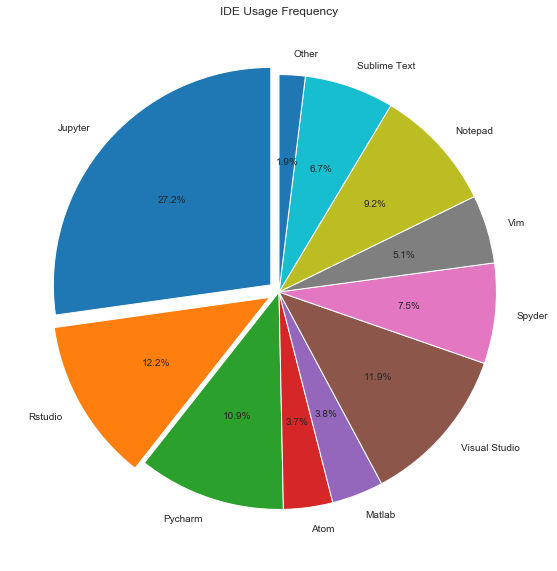

In [150]:
plt.figure(figsize=(10,10))
plt.pie(sets.values, labels=sets.index, explode=(0.05, 0.05,  0, 0, 0, 0, 0, 0, 0, 0, 0),
           labeldistance = 1.1,autopct = '%3.1f%%',shadow = False, startangle = 90,pctdistance = 0.6)
plt.title('IDE Usage Frequency')
plt.show()

### 4.1.2 What is the primary analytical tool you have to learn to analyze data

In [151]:
sets2=df['Q14'].value_counts()

In [152]:
sets2.index=['RStudio, JupyterLab, etc.', 'Microsoft Excel, Google Sheets, etc.', 'AWS, GCP, Azure, etc.', 'Other', 'Salesforce, Tableau, Spotfire, etc.', 'SPSS, SAS, etc.']

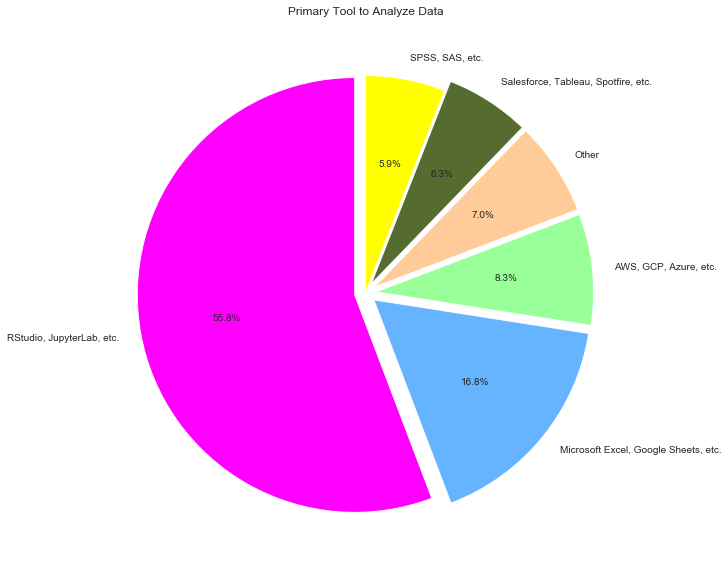

In [153]:
plt.figure(figsize=(10,10))
plt.pie(sets2.values, labels=sets2.index, explode=(0.05, 0.05,  0.05, 0.05, 0.05, 0),
           labeldistance = 1.1,autopct = '%3.1f%%',shadow = False, startangle = 90,pctdistance = 0.6, colors=colors)
plt.title('Primary Tool to Analyze Data')
plt.show()

### 4.1.3 Machine Learning Framework Usages

In [154]:
df_28=df.iloc[:,133:145]
df_28.columns=['Scikit-learn', 'TensorFlow', 'Keras', 'RandomForest', 'Xgboost', 'PyTorch', 'Caret', 'LightGBM', 'Spark MLib', 'Fast.ai', 'None', 'Other']
df_28.head()

,Scikit-learn,TensorFlow,Keras,RandomForest,Xgboost,PyTorch,Caret,LightGBM,Spark MLib,Fast.ai,None,Other
0,0,0,0,0,0,0,0,0,0,0,1,0
1,0,0,0,0,0,0,0,0,0,0,0,0
2,1,1,1,1,0,0,0,0,0,0,0,0
3,1,0,0,1,1,0,0,1,0,0,0,0
4,1,1,1,1,1,0,1,0,0,0,0,0


In [155]:
sets3=df_28.sum(axis=0)
sets3=sets3.drop(index = 'None')

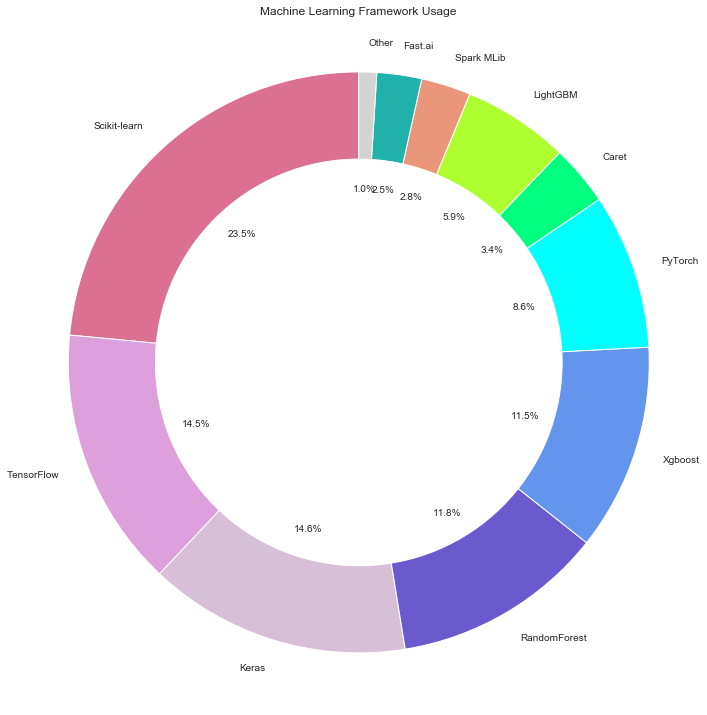

In [157]:
colors = ['palevioletred','plum','thistle','slateblue', 'cornflowerblue', 'cyan', 'springgreen', 'greenyellow', 'darksalmon', 'lightseagreen', 'lightgray']

fig1, ax1 = plt.subplots(figsize=(10,10))
ax1.pie(sets3.values, labels=sets3.index, 
           autopct = '%3.1f%%',shadow = False, startangle = 90,pctdistance = 0.6, colors=colors)

centre_circle = plt.Circle((0,0),0.70,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

ax1.axis('equal')  
plt.tight_layout()
plt.title('Machine Learning Framework Usage')
plt.show()


## 4.2 Histograms

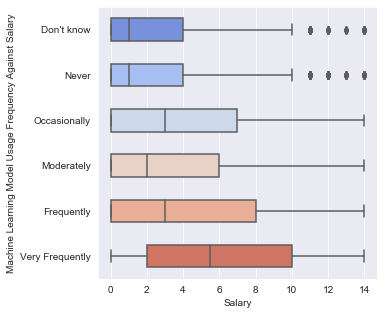

In [158]:
q8_encoded={'I do not know': "Don't know", 
            'No (we do not use ML methods)': 'Never',  
            'We use ML methods for generating insights (but do not put working models into production)': 'Occasionally', 
            'We are exploring ML methods (and may one day put a model into production)': 'Moderately', 
            'We recently started using ML methods (i.e., models in production for less than 2 years)':'Frequently', 
            'N/A': 'Never',
            'We have well established ML methods (i.e., models in production for more than 2 years)': 'Very Frequently'}
colors = ['palevioletred','plum','thistle','slateblue', 'cornflowerblue', 'cyan', 'springgreen', 'greenyellow', 'darksalmon', 'lightseagreen', 'lightgray']
q8_order={"Don't know":0, 'Never':1, 'Occasionally':2, 'Moderately':3, 'Frequently':4, 'Very Frequently':5}
df.loc[:, 'Q8_name']=df.loc[:, 'Q8'].map(q8_encoded)
df_dims = (5, 5)
fig, ax = plt.subplots(figsize=df_dims)
sns.boxplot(y='Q8_name', x='Q10_Encoded', ax=ax, data=df, width=0.5, orient ='h', order=q8_order, palette="coolwarm")
plt.ylabel('Machine Learning Model Usage Frequency Against Salary')
plt.xlabel('Salary')
plt.show()

## 4.3 Word Map

In [159]:
def ProcessText(tweet):
        
    
    #start by tokenize the tweet (separate it the text into words, or n-grams) with nltk
    word_tokens = word_tokenize(tweet) 
 
    #convert text into lowercase
    word_tokens = [word.lower() for word in word_tokens]
    
    #remove punctuation signs from tokens
    table = str.maketrans('', '', string.punctuation)
    word_tokens = [word.translate(table) for word in word_tokens]
    
    #remove non-alphabetic characters
    word_tokens = [word for word in word_tokens if word.isalpha()]
    
    #remove stopwords
    stop_words = set(stopwords.words('english')) #import a predefined set of stopwords from the nltk package
    word_tokens = [word for word in word_tokens if not word in stop_words]

    clean_tweet = [] #create empty list to store the final tokens after text processing
    for w in word_tokens:
        clean_tweet.append(w)

    #join the tokens of the clean tweet back into a string with spaces in between
    clean_tweet_str = ' '.join(clean_tweet)
    
    #return the clean tweet string
    return clean_tweet_str  

In [160]:
def generateWordCloud(strInput):
    wordcloud = WordCloud(width = 800, height = 800, 
                    background_color ='white',  
                    min_font_size = 10).generate(strInput) 

    # plot the WordCloud image                        
    plt.figure(figsize = (8, 8), facecolor = 'black') 
    plt.imshow(wordcloud) 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 

    plt.show() 

In [161]:
job_market=pd.read_csv('job_market.csv', low_memory=False)
job_market.head()

job_description
0  About Assurance\nAt Assurance we are disrupting the antiquated and inefficient world of insurance and financial services. Our team of world class software engineers, data scientists, and business professionals are modernizing how people obtain and manage their financial life all through our powerful platform ecosystem. We are rapidly growing as we expand our product offerings and global footprint, and this growth continues to present new and exciting challenges as we push our industry into its future. We eliminate waste throughout the industry and calculate the complex into simple, valuable solutions to improve people's lives. We are humble, driven, and committed to improving the lives of millions.\n\nAbout the Position\nAs we build the future of consumer insurance in a modern age, data is at the core of everything that we do. The role requires team members who are adept at using large data sets to find opportunities for optimization and can leverage appropriate models to test the effectiveness of different courses of action. Our team uses a variety of data mining and analysis methods, a variety of data tools, builds and implements models, develops algorithms, and creates simulations. Team members must be very comfortable writing production-ready code to include testing and maintenance infrastructure, and able to put models and analysis into production with no support from engineering (we own our stack end to end). At Assurance, we hire experts in their field, and we give them the independence and trust to build based on their expertise.\n\nAbout You\nYou have a proven ability to drive business results with data-based insights and are comfortable working with a wide range of stakeholders and functional teams. The right candidate will have a passion for discovering solutions hidden in large data sets and working with stakeholders to improve business outcomes. You’re capable of getting data for analysis on your own, without reliance on engineering, and you can build professional dashboards as standalone software products and tools. We’re growing at a rapid pace, so it’s important that you embrace the opportunity to blaze your own trail. You thrive in a fast-paced environment where priorities can shift rapidly as we corner opportunity. You can work independently, with little oversight or guidance.\nTo be successful in this role, you must possess the following:\nProficiency in either Python or R, and expertise in SQL.\nExperience working with AWS or another cloud-based computing platform.\nExperience and working knowledge of data infrastructure, pipelines, and advanced data manipulation.\nExperience with BI tools like Tableau or Looker (preferred), or any other industry tool such Qlik, PowerBI, Spotfire, etc.\nExcellent communication ability – you can explain your work in a way that anyone on the team can understand, and you can frame problems in a way that ensures the right question is being asked.\nBusiness Acumen – you are always eager to understand how the business works, and more specifically, how your work impacts the business.\nEnthusiastic yet humble – you are excited about the work you do, but you are also humble enough to embrace feedback – you don’t need to be the smartest person in the room.\nBachelors degree in mathematics, statistics, data science or related field of study.\nThe following additional experience is desired:\nExperience retraining a model within a few days or update a model within one day.\nCapable of performing an in-depth analysis and summarizing findings in one day.\nComfortable having conversations with our executive team and non-technical team members to distill down their needs and to deliver actionable insights.                                                                                                                                                                                                                                                                               

In [162]:
processedTextList = []
for desc in job_market['job_description']:
    temp = ProcessText(desc)
    processedTextList.append(temp)
job_market['processed_text']= processedTextList

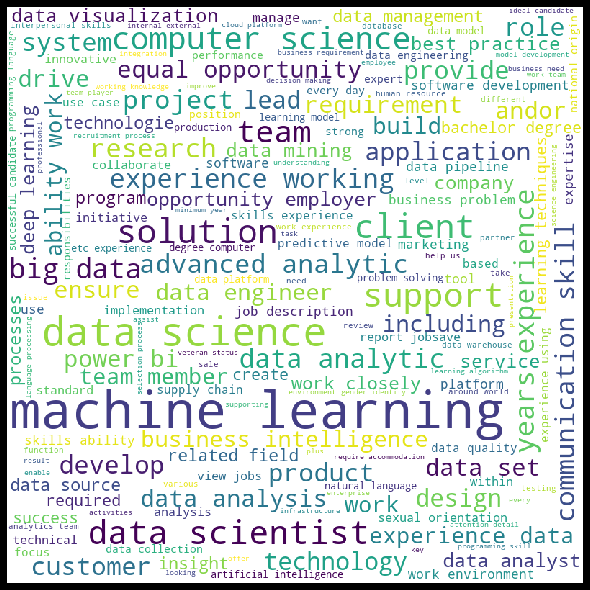

In [163]:
strForWC = ""
for desc in processedTextList:
    for text in desc:
        strForWC = strForWC + text

generateWordCloud(strForWC)

# Finance in AI
- This section/book will determine and justify the course curriculum for the Finance in AI course in the Masters of Data science stream

## URL's to consider.
- After manual searching the best structured courses include data camp, coursera and cfte. The first 2 are rated very well and the syllabus are available directly online. Also, these 3 courses are configured differently, so I could use the variation to develop a unique finance in ai course
- For this reason those 3 are chosen. 


Coursera:
https://www.coursera.org/learn/fundamentals-machine-learning-in-finance#about

CFTE:
https://cfte.education/aifinance/#content



Datacamp:
https://www.datacamp.com/courses/machine-learning-for-finance-in-python



Unused:
- https://www.omscs.gatech.edu/cs-7646-machine-learning-trading 
- https://www.udemy.com/course/ai-for-finance/ 
- https://gradstudies.engineering.utoronto.ca/professional-degrees/elite-emphasis/elite-certificate-finance-management-courses/#1052


In [164]:
# imports
from bs4 import BeautifulSoup
import requests
import seaborn as sns
import html
import re
import numpy as np
import pandas as pd
import unicodedata
import nltk
import html
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn.metrics import pairwise_distances
import re
import matplotlib.pyplot as plt
try:
    from wordcloud import WordCloud
except:
    !pip install wordcloud
    from wordcloud import WordCloud

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


# The first site is Coursera. 
- This course looks at machine learning in finance
- The objective is to find the modules and the lecture topics from the syllabus.

coursera_URL = "https://www.coursera.org/learn/fundamentals-machine-learning-in-finance#syllabus"

coursera_page = requests.get(coursera_URL) # gets the html from the coursera web page
#coursera_page.text
coursera_soup = BeautifulSoup(coursera_page.text, 'lxml') # use bs4 to parse and extract data from the html

mod_names=[] # list to hold the module names
mod_topics = [] # list to hold the individual lecture/module names
mod_dict={} # will hold names, and topics to construct df
for module in coursera_soup.find_all(class_ = 'Row_nvwp6p SyllabusWeek'): # this tag separates the modules
    i = 0
    try:
        mod_topics = [] # initialize the lecture list.
        mod_name=module.find('h2',class_='headline-2-text bold m-b-2').text # find the name
        mod_names.append(mod_name) # fills the names
        num_vid=int(module.find('strong','Strong_gjs17i-o_O-weightBold_uvlhiv-o_O-fontBody_56f0wi m-x-1 text-secondary')\
              .text.split(' ')[0]) # This holds the individual lecture names

        for vid in module.find_all('div',class_='P_gjs17i-o_O-weightNormal_s9jwp5-o_O-fontBody_56f0wi m-y-2'):
            if i<num_vid:
                mod_topics.append(re.sub(r'[0-9]m','',vid.text)) # append the string of videos to topics
    
                i+=1
        mod_dict[mod_name]=mod_topics  # initializes the name as a key and the lectures as a value
    except:pass
ML_in_finance = pd.DataFrame.from_dict(mod_dict,orient = 'Index').T # create dataframe of modules and lecture names
ML_in_finance.to_csv('coursera_ai_fin.csv')

In [165]:
coursera_dict = {'Fundamentals of Supervised Learning in Finance': ['What is Machine Learning in Finance?',
  'Introduction to Fundamentals of Machine Learning in Finance',
  'Support Vector Machines, Part 1',
  'Support Vector Machines, Part 2',
  'SVM. The Kernel Trick',
  'Example: SVM for Prediction of Credit Spreads',
  'Tree Methods. CART Trees',
  'Tree Methods: Random Forests',
  'Tree Methods: Boosting'],
 'Core Concepts of Unsupervised Learning, PCA & Dimensionality Reduction': ['Core Concepts of UL',
  'PCA for Stock Returns, Part 1',
  'PCA for Stock Returns, Part 2',
  'Dimension Reduction with PCA',
  'Dimension Reduction with tSNE1',
  'Dimension Reduction with Autoencoders'],
 'Data Visualization & Clustering': ['UL. Clustering Algorithms',
  'UL. K-clustering',
  'UL. K-means Neural Algorithm',
  'UL. Hierarchical Clustering Algorithms1',
  'UL.  Clustering and Estimation of Equity Correlation Matrix',
  'UL. Minimum Spanning Trees, Kruskal Algorithm',
  'UL. Probabilistic Clustering'],
 'Sequence Modeling and Reinforcement Learning': ['SM. Latent Variables',
  'Sequence Modeling1',
  'SM. Latent Variables for Sequences',
  'SM. State-Space Models',
  'SM. Hidden Markov Models',
  'Neural Architecture for Sequential Data1',
  'RL. Introduction',
  'RL. Core Ideas',
  'Markov Decision Process and RL',
  'RL. Bellman Equation',
  'RL and Inverse Reinforcement Learning1']}

In [166]:
ML_in_finance = pd.read_csv('coursera_ai_fin.csv')
ML_in_finance.head(2)

,Unnamed: 0,Fundamentals of Supervised Learning in Finance,"Core Concepts of Unsupervised Learning, PCA & Dimensionality Reduction",Data Visualization & Clustering,Sequence Modeling and Reinforcement Learning
0,0,What is Machine Learning in Finance?,Core Concepts of UL,UL. Clustering Algorithms,SM. Latent Variables
1,1,Introduction to Fundamentals of Machine Learning in Finance,"PCA for Stock Returns, Part 1",UL. K-clustering,Sequence Modeling1


# Datacamp
- This course looks at ML in finance using python
- same objective, find modules, and the lectures that compose them

dc_url = 'https://www.datacamp.com/courses/machine-learning-for-finance-in-python'
dc_page = requests.get(dc_url) # gets html from datacamp site
dc_soup = BeautifulSoup(dc_page.text,'lxml') # use Beautiful soup to parse

# initialize the lists
mod_names=[] # module names
mod_topics = [] # holds the module lectures
mod_string = [] # 
mod_dict={}

for module in dc_soup.find_all('h4',class_='chapter__title'):
    mod_names.append(module.text.strip())

mod_names

    for chapter in dc_soup.find_all('ul',class_="chapter__exercises hidden dc-u-ta-center"): # find all module/chapters
        mod_topics = [] # initialize topic list
        for vid in chapter.find_all('h5'): # for each video lecture append it to the topics list
            #print(vid.text)
            mod_topics.append(vid.text)
            #print(mod_topics)
        mod_string.append(','.join(mod_topics)) # join all the topics in the list into a single string to be passed to a dict
        #print('***********************')
        
    for i in range(len(mod_names)):
        mod_dict[mod_names[i]]=mod_string[i].split(',') # split the string back to a list and assign to a key (module)
    
    dc_ML_finance = pd.DataFrame.from_dict(mod_dict,orient = 'Index').T # construct df
    dc_dict= mod_dict   # save results
    dc_ML_finance.to_csv('DC_ai_fin.csv')

In [167]:
dc_dict = {'Preparing data and a linear model': ['Machine learning for finance',
  'Explore the data with some EDA',
  'Correlations',
  'Data transforms',
  ' features',
  ' and targets',
  'Create moving average and RSI features',
  'Create features and targets',
  'Check the correlations',
  'Linear modeling',
  'Create train and test features',
  'Fit a linear model',
  'Evaluate our results'],
 'Neural networks and KNN': ['Scaling data and KNN Regression',
  'Standardizing data',
  'Optimize n_neighbors',
  'Evaluate KNN performance',
  'Neural Networks',
  'Build and fit a simple neural net',
  'Plot losses',
  'Measure performance',
  'Custom loss functions',
  'Custom loss function',
  'Fit neural net with custom loss function',
  'Visualize the results',
  'Overfitting and ensembling',
  'Combatting overfitting with dropout',
  'Ensembling models',
  'See how the ensemble performed'],
 'Machine learning tree methods': ['Engineering more features',
  'Feature engineering from volume',
  'Create day-of-week features',
  'Examine correlations of the new features',
  'Decision trees',
  'Fit a decision tree',
  'Try different max depths',
  'Check our results',
  'Random forests',
  'Fit a random forest',
  'Tune random forest hyperparameters',
  'Evaluate performance',
  'Feature importances and gradient boosting',
  'Random forest feature importances',
  'A gradient boosting model',
  'Gradient boosting feature importances'],
 'Machine learning with modern portfolio theory': ['Modern portfolio theory (MPT); efficient frontiers',
  'Join stock DataFrames and calculate returns',
  'Calculate covariances for volatility',
  'Calculate portfolios',
  'Plot efficient frontier',
  'Sharpe ratios; features and targets',
  'Get best Sharpe ratios',
  'Calculate EWMAs',
  'Make features and targets',
  'Plot efficient frontier with best Sharpe ratio',
  'Machine learning for MPT',
  'Make predictions with a random forest',
  'Get predictions and first evaluation',
  'Evaluate returns',
  'Plot returns',
  'Closing remarks and advice']}

In [168]:
dc_ML_finance = pd.read_csv('DC_ai_fin.csv')
dc_ML_finance.head(2)

,Unnamed: 0,Preparing data and a linear model,Neural networks and KNN,Machine learning tree methods,Machine learning with modern portfolio theory
0,0,Machine learning for finance,Scaling data and KNN Regression,Engineering more features,Modern portfolio theory (MPT); efficient frontiers
1,1,Explore the data with some EDA,Standardizing data,Feature engineering from volume,Join stock DataFrames and calculate returns


# CFTE

cfte_url = 'https://cfte.education/aifinance/#content'
cfte_page = requests.get(cfte_url).text # get html
cfte_soup = BeautifulSoup(cfte_page,'lxml') # parse using bs4

# initialize the lists
mod_names=[]
mod_topics = []
mod_string = []
mod_dict={}

# finding the module names/chapter names
for mod in cfte_soup.find_all('span',class_="x-acc-header-text"): # this tag separates the chapters
    if 'Chapter' in mod.text: # if 'Chapter' is found
        print(mod.text)
        mod_names.append(mod.text) # append name to mod_names
        

    for mod in cfte_soup.find_all('div',class_ = 'x-acc-content'): # find all modules, sepearated by this div tag
        mod_topics = []
        if 'Module' in mod.text: # if module is found, strip and append it
            #print(mod.text)
            mod_topics.append(mod.text.strip())
            #print(mod_topics)
            #print('***')
        mod_string.append(','.join(mod_topics))
    mod_string.remove('') # remove extra '' if found
    mod_string = mod_string[:len(mod_names)] # only the ones without ''
    
    for i in range(len(mod_names)): # create a key value pair between the module name and the lecture names
        mod_dict[mod_names[i]]=mod_string[i].split('\n')
    
    cfte_ML_finance = pd.DataFrame.from_dict(mod_dict,orient = 'Index').T # construct df
    cfte_dict = mod_dict # save results
    cfte_ML_finance # view
    cfte_ML_finance.to_csv('cfte_ai_fin.csv')

In [169]:
cfte_dict = {'Chapter 1: An Industry Overview of AI': ['Module 1: Introduction to Artificial Intelligence',
  'Module 2: Use cases of AI outside of Finance',
  'Module 3: Use cases of AI in Finance',
  'Module 4: Industry drivers of AI in Finance'],
 'Chapter 2: AI Technologies': ['Module 5: AI, Machine Learning and Deep Learning',
  'Module 6: Building AI systems',
  'Module 7: Natural Language Processing',
  'Module 8: Recommendation Engine'],
 'Chapter 3: Implementing AI in an Enterprise': ['Module 9: Integrating AI at a Strategic Level',
  'Module 10: Infrastructure for AI',
  'Module 11: The Role of People',
  'Module 12: Ethics and risks'],
 'Chapter 4: Applications of AI in Finance': ['Module 13: Wealth and Asset Management',
  'Module 14: Insurance',
  'Module 15: Customer service',
  'Module 16: Robotic Process Automation',
  'Module 17: Credit Scoring',
  'Module 18: Compliance and Fraud Detection']}

In [170]:
cfte_ML_finance = pd.read_csv('cfte_ai_fin.csv')
cfte_ML_finance.head(2)

,Unnamed: 0,Chapter 1: An Industry Overview of AI,Chapter 2: AI Technologies,Chapter 3: Implementing AI in an Enterprise,Chapter 4: Applications of AI in Finance
0,0,Module 1: Introduction to Artificial Intelligence,"Module 5: AI, Machine Learning and Deep Learning",Module 9: Integrating AI at a Strategic Level,Module 13: Wealth and Asset Management
1,1,Module 2: Use cases of AI outside of Finance,Module 6: Building AI systems,Module 10: Infrastructure for AI,Module 14: Insurance


# Class Central
- Now that we have gotton a general structure for this class, we need to choose the most important modules and topics subjects to teach for this course
- I will use class central which is a database for classes and has descriptions for each class. I will retrieve the descriptions of many courses, then search them for the most common keywords. These keywords will then be used to select the desired modules and topics from the created finance dataframes

baseurl = 'https://www.classcentral.com'
job_listings_url = 'https://www.classcentral.com/search?q=finance+in+ai'
response = requests.get(job_listings_url) # get html
listingSoup = BeautifulSoup(response.text, 'html.parser') # parse using bs4

def getDescription(url):
    '''
    This function takes in a url, enters it then retrieves the url
    '''
    response = requests.get(url)
    jobSoup = BeautifulSoup(response.text, 'html.parser')
    summary = jobSoup.find_all('div', attrs={'class': 'wysiwyg line-wide text-1 margin-bottom-large'})
    return summary

    link_list = [] # this will hold the links to the descriptions of all the classes
    descrip = [] # holds a description of all the classes
    ratings = [] # holds the ratings of all the classes
    class_names = [] # holds the names of all the classes listed
    num_classes=0 # count of the classes
    # im finding all <tr> tags that are not ads
    for class_listing in listingSoup.find_all('tr',class_='row nowrap vert-align-middle padding-vert-small border-bottom border-gray-light'):
        class_name = class_listing.find('span',class_='text-1 weight-semi line-tight').text
        class_names.append(class_name.strip()) # append the class names
        try:
            url = baseurl+class_listing.find('a',class_='color-charcoal block line-tight course-name').get('href') #find url
            link_list.append(url)
        except: url = 'N/A'
        #print(url)
        try:
            summary = getDescription(url) # get description based on the rul
            descrip.append(summary[0].text.strip())
        except: descrip.append('N/A')
        try:
            rating = class_listing.find('span', attrs = {'class': 'text-4 color-charcoal block'}).text # try to find the rating
        except:
            rating = 'N/A'
        ratings.append(rating) # append 
        num_classes+=1
        
    cc_dict = {'Description':descrip,'Link':link_list,'Rating':ratings,'Class Name':class_names} # combine results in dict
    cc_df = pd.DataFrame(cc_dict) # construct df
    cc_df.to_csv('class_central_fin_ai.csv')

In [171]:
cc_df = pd.read_csv('class_central_fin_ai.csv')
#cc_df.head()
cc_df = cc_df[['Description','Link','Rating','Class Name']]
cc_df.head()

,Description,Link,Rating,Class Name
0,"Machine learning is the science of getting computers to act without being explicitly programmed. In the past decade, machine learning has given us self-driving cars, practical speech recognition, effective web search, and a vastly improved understanding of the human genome. Machine learning is so pervasive today that you probably use it dozens of times a day without knowing it. Many researchers also think it is the best way to make progress towards human-level AI. In this class, you will learn about the most effective machine learning techniques, and gain practice implementing them and getting them to work for yourself. More importantly, you'll learn about not only the theoretical underpinnings of learning, but also gain the practical know-how needed to quickly and powerfully apply these techniques to new problems. Finally, you'll learn about some of Silicon Valley's best practices in innovation as it pertains to machine learning and AI.\n\nThis course provides a broad introduction to machine learning, datamining, and statistical pattern recognition. Topics include: (i) Supervised learning (parametric/non-parametric algorithms, support vector machines, kernels, neural networks). (ii) Unsupervised learning (clustering, dimensionality reduction, recommender systems, deep learning). (iii) Best practices in machine learning (bias/variance theory; innovation process in machine learning and AI). The course will also draw from numerous case studies and applications, so that you'll also learn how to apply learning algorithms to building smart robots (perception, control), text understanding (web search, anti-spam), computer vision, medical informatics, audio, database mining, and other areas.\n \n\n\n Read more",https://www.classcentral.com/course/machine-learning-835,4.8,Machine Learning
1,"This is the sixth course in the IBM AI Enterprise Workflow Certification specialization. You are STRONGLY encouraged to complete these courses in order as they are not individual independent courses, but part of a workflow where each course builds on the previous ones. \n\nThis course focuses on models in production at a hypothetical streaming media company. There is an introduction to IBM Watson Machine Learning. You will build your own API in a Docker container and learn how to manage containers with Kubernetes. The course also introduces several other tools in the IBM ecosystem designed to help deploy or maintain models in production. The AI workflow is not a linear process so there is some time dedicated to the most important feedback loops in order to promote efficient iteration on the overall workflow.\n \nBy the end of this course you will be able to:\n1. Use Docker to deploy a flask application\n2. Deploy a simple UI to integrate the ML model, Watson NLU, and Watson Visual Recognition\n3. Discuss basic Kubernetes terminology\n4. Deploy a scalable web application on Kubernetes \n5. Discuss the different feedback loops in AI workflow\n6. Discuss the use of unit testing in the context of model production\n7. Use IBM Watson OpenScale to assess bias and performance of production machine learning models.\n\nWho should take this course?\nThis course targets existing data science practitioners that have expertise building machine learning models, who want to deepen their skills on building and deploying AI in large enterprises. If you are an aspiring Data Scientist, this course is NOT for you as you need real world expertise to benefit from the content of these courses.\n \nWhat skills should you have?\nIt is assumed that you have completed Courses 1 through 5 of the IBM AI Enterprise Workflow specialization and you have a solid understanding of the following topics prior to starting this course: Fundamental understanding of Linear Algebra; Understand sampling, probability theory, and probability distributions; Knowledge of descriptive and inferential statistical concepts; General understanding of machine lea

In [172]:
# keywords to look for. This was a combination of relevant ML keywords and common words in the 3 dataframes above
cc_finance_key_words=['machine learning',
 'risks',
 'machine learning and deep learning',
 'customer service',
 'minimum spanning trees',
 'fraud detection',
 'cloud',
 'statistical',
 'java',
 'gradient boosting',
 'correlations',
 'knn',
 'feature importances',
 'state',
 'decision trees',
 'google cloud',
 'robotic process automation',
 'gradient boost',
 'loss function',
 'mpt',
 'recommender systems',
 'feature',
 'support vector machines',
 'data transforms',
 'modeling',
 'google colab',
 'overfit',
 'reinforcement learning',
 'overfitting',
 'seaborn',
 'preparing data and a linear model',
 'max depths',
 'plotly',
 'pycharm',
 'machine learning tree methods',
 'natural language processing',
 'atom',
 'space models',
 'custom loss function',
 'critical thinking',
 'ocean',
 'calculate portfolios',
 'insurance',
 'javascript',
 'datalab',
 'ggplot',
 'latent variables for sequences',
 'kruskal algorithm',
 'dimensionality reduction',
 'credit scoring',
 'spyder',
 'leaflet',
 ' c ',
 'engineering more features',
 'watson',
 'targets',
 'visual studio',
 'artificial intelligence',
 'measure performance',
 'stock',
 'fit a linear model',
 'building ai systems',
 'deep learning',
 'efficient frontiers',
 'join stock dataframes and calculate returns',
 'statistics',
 'machine learning for finance',
 'mathematic',
 'd3',
 'standardizing',
 'the role of people',
 'recommendation engine',
 'business decisions',
 'linear modeling',
 'latent variables',
 'data visualization',
 'core ideas',
 'plot efficient frontier',
 'bellman equation',
 'logistic regression',
 'linear model',
 'typescript',
 'matlab',
 'cpu',
 'tpu',
 'sequence modeling',
 'infrastructure for ai',
 ' r ',
 'vim',
 'matplotlib',
 'ensemble',
 'random forest',
 'communication',
 'nlp',
 'visualize the results',
 'cart trees',
 'correlation matrix',
 'svm',
 'plot losses',
 'evaluate performance',
 'boosting',
 'c++',
 'finance',
 'geoplotlib',
 'shiny',
 'feature engineering from volume',
 'applications of ai in finance',
 'hierarchical clustering',
 'the kernel trick',
 'neural architecture for sequential data',
 'rl and inverse reinforcement learning',
 'clustering',
 'pca',
 'bash',
 'modern portfolio theory',
 'tune random forest hyperparameters',
 'ewmas',
 'sublime',
 'calculate covariances for volatility',
 'sharpe ratios',
 'visualization',
 'optimize',
 'neighbors',
 'dimension reduction',
 'tree methods',
 'markov decision process and rl',
 'jupyter',
 'linear algebra',
 'eda',
 'sql',
 'hidden markov models',
 'rstudio',
 'random forests',
 'probabilistic clustering',
 'linear regression',
 'gpu',
 'custom loss functions',
 'neural network',
 'moving average',
 'python',
 'wealth and asset management',
'RL', 'UL','SM']

In [173]:
# Create a multi-words phrase detector
def detect_tool(table, skills):
  # Initialize a word frequency table
  skill_table=pd.DataFrame(columns=skills, index=range(len(table)), dtype=int)
  for skill in skills:
    skill_table[skill] = np.zeros(len(skill_table))
  # Phrase detector
  for i in range(len(table)):
    text=table.iloc[i, 0]
    # Remove the html tags
    re.sub(r'<[^<]+?>','', str(text))
    # Extract the common skills and calculate the word frequency
    for skill in skills:
      if (re.findall(re.escape(skill), str(text))!= []):
        skill_table.loc[i, skill]=int(len(re.findall(re.escape(skill), text)))
  return skill_table

In [174]:
df=detect_tool(cc_df, cc_finance_key_words)
# drop the skills with all 0 values
df = df.loc[:, (df != 0).any(axis=0)]

In [175]:
df.tail()

,machine learning,risks,cloud,statistical,state,mpt,recommender systems,feature,support vector machines,modeling,reinforcement learning,natural language processing,insurance,dimensionality reduction,targets,artificial intelligence,stock,deep learning,mathematic,tpu,matplotlib,communication,finance,clustering,modern portfolio theory,optimize,linear algebra,linear regression,neural network,RL
45,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
46,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
48,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


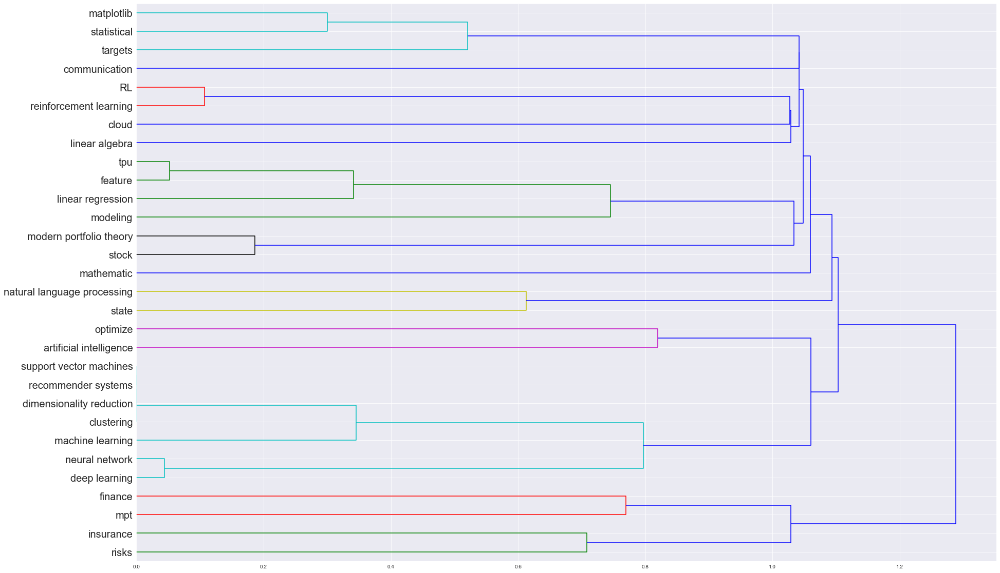

In [176]:
# Calculating the distance
dist=pdist(df.T, metric='euclidean')
# Calculating the linkage matrix
link = linkage(df.T, method='complete', metric='correlation')
# Draw the dendrogram
plt.figure(figsize=(30,20))
B=dendrogram(link, labels=df.columns, leaf_font_size=20,orientation='right')

## Dendrogram Discussion
Looking at the above dendrogram, and comparing the topics to the previous collected dataframes, I could create a couple of clusters that would cover the general topics for finance in ai

**CLUSTER 1**
- <font color = 'red'> ***finance, mpt(modern portfolio theory), insurance, risks*** </font>

This cluster is more on finance than any machine learning. This would be great to integrate ML into applications within finance. Therefore, this cluster should be covered last. After all the models are covered, they can all be applied to these specific topics in this cluster.

**CLUSTER 2**
- <font color = 'red'>***artificial intelligence, modeling, optimization***</font>

This cluster is more of the basics. Modeling, ai, and optimization are the fundamentals of machine learning. Therefore this should be taught first, or near first. A basic introduction to artificial intelligence, followed by core concepts of modeling (supervised learning) then how to optimize these. This cluster could dive deeper into hyperparameter tuning, bias variance tradeoff, and the minimizeing the cost function.

**CLUSTER 3**
- <font color = 'red'>***dimensionality reduction, clustering, recommender systems***</font>

This cluster is a bit more technical so it should be near the end. Looking at the previous dataframes, they are used a lot in finance to cover stock returns, the use of pca, and recommender systems for financial services. Therefore, this module will cover the concepts of unsupervised learning, which goes into clustering, dimensionality reduction, pca, and recommender systems. 

**CLUSTER 4**
- <font color = 'red'>***machine learning, neural networks, deep learning***</font>

Again, this cluster is more technical, getting into deep learning. There is not enough topics in this cluster, so it will also involve a part that integrates into finance. This works well such that the second half of this module will transition into cluster 1 - applications of ML in finance. 

**CLUSTER 5**
- <font color = 'red'>***matplotlib, statistical, targets***</font>

This cluster doesn't mean much. It could represent the abundance and importance of visualization techniques. This could be integrated into another module instead of being one on its own. 

In [177]:
# Next, I will visualize the most common/most important topics/skills from the obtained dataframes from the 3 sites.
all_dict = {**coursera_dict,**dc_dict,**cfte_dict} # combine all dataframes to one dictionary
bag_words = str(all_dict) # convert to string for text processing
bg_re = re.compile(r'[A-Za-z\s]+') # only alphabetic characters
bag_words= bg_re.findall(bag_words)
bag_words=[word.lower().strip() for word in bag_words] # lowercase words
stop_words = ['module','of','and','a','with'] # remove common stop words
bag_words=[word for word in bag_words if word not in stop_words] 
bag_words = [word for word in bag_words if word != ''] # remove extra spaces
bag_words = [word.strip() for word in bag_words]  # remove extra spaces
bag_words_dict = {'Description':bag_words} # create a dict with all the descriptions of the 3 dataframes
skillsdf = pd.DataFrame(bag_words_dict)  # construct df
skillsdf=detect_tool(skillsdf, cc_finance_key_words) # construct a skills df by looking at the descriptions for keywords
skills_count = dict(skillsdf.sum()) # find the count of each skill

skills_count_final={} # there are too many skills, so I will only choose the ones that appear more than twice


In [178]:
tot_skills = 0
for i in skills_count_final.values():
    tot_skills = tot_skills+i
for key,value in skills_count.items():
    if value!=0.0:
        if value!=1.0:
            skills_count_final[key]=value#/tot_skills

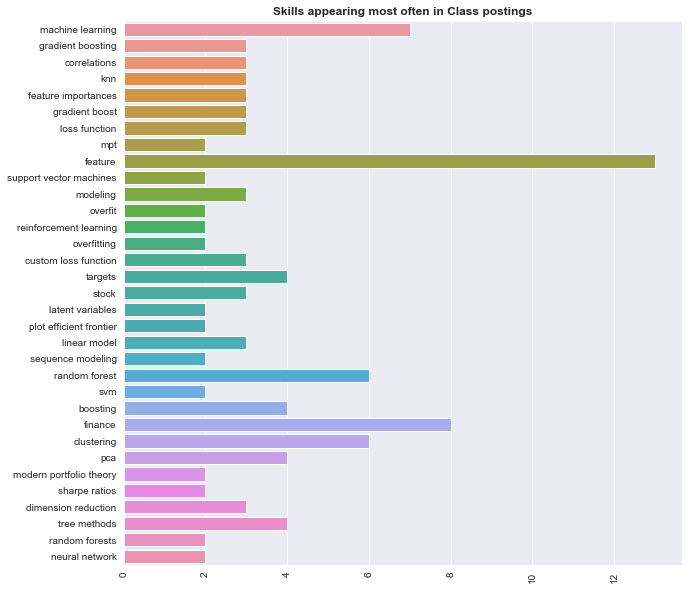

In [179]:
plt.figure(figsize = (10,10))
sns.barplot(list(skills_count_final.values()),list(skills_count_final.keys()),)
plt.xticks(rotation = 90)
plt.title('Skills appearing most often in Class postings',fontweight = 'bold')
plt.show()

## Discussion
The figure above depicts the most common keywords that are mentioned in the scraped courses "finance in ai". These keywords are used to fill in the details of the clusters. This is manually done based on the commonality between the detailed keywords and the keywords from the clusters.

# AI in Finance Course Outline

- This course will cover how machine learning techniques are implemented and covered in financial applications using python
- Introduction to Data Science should be taken before this course as it is more of a applied course rather than introductory
- However, general introductions will be covered in each of the ML methods discussed
- Course objectives:
    - Gain fundamental understanding of different types of models used in finance
    - Learn how to optimize and tune the models
    - Learn how to integrate ML to businesses
    - Optimize return vs risk on portfolios using MPT

### Module 1: Introduction to Artificial Intelligence, Modeling, Visualizations, and Optimization
- Fundamentals of AI in Finance. Discussion on use-cases and industry drivers of AI.
- Data Explorations for EDA, correlations, transformations, targets and feature preparation. Discussion on RSI features.
- Overview of Supervised Learning Pt 1: Linear Modeling - Regression. K Nearest Neighbors, SVM.
- Overview of Supervised Learning Pt 2: Tree Methods and ensembles - Decision Trees, Random Forests, and Boosting. 
- Optimization: Loss functions, Hyperparameter Tuning, Cross Validation, and Bias-Variance Tradeoff. Visualization and evaluation of the results and losses.

### Module 2: Unsupervised Learning, Dimensionality Reduction, Recommender systems
- Core concepts of Unsupervised Machine Learning and 
- Unsupervised Machine Learning algorithms: K-Means, Hierarchical,Probabalistic Clustering.
- Dimensionality reduction in Finance. Dimensionality Reduction with PCA. PCA applications with stock returns
- Core concepts of Recommender Systems, applications in financial services, and investment predictions

### Module 3: ML, Neural Networks and Deep Learning in Finance
- Neural Networks pt 1: Core Concepts of Neural Networks, and deep learning. 
- Neural Networks pt 2: Building simple neural nets, measuring performance, and optimization
- Integrating ML, and AI into an enterprise. Data collection, the role of people, and business infrastructure.

### Module 4: Applications of AI and ML in Finance
- Modern Portfolio Theory (MPT), efficient frontiers, and Wealth and Asset Management. Calculating portfolios and Visualizing the efficient fronteirs
- Risks, Insurance, volatility and calculating covariances. Sharpe ratios - features and targets
- Using Machine Learning for MPT. Predictions using tree methods, and performance optimization
- Credit Scoring, Compliance and Fraud Detection

## Assignments 
1. Use 3 of the core supervised ML models to analyze historical market behavior. Apply hyperparameter tuning and cross validation. Then use the optimal model to predict a strategy for investing. Visualize the results.

2. Use UL clustering to identify similar assets. Construct a diversified portfolio. Then use principal component analysis (pca) to assess returns on the given portfolio. 

3. Use MPT to assemble a portfolio. Calculate the risks, covariances and maximize expected returns given the risk. Optimize the portfolio using efficient frontiers and evaluate the results.

## Exam
- The exam will have technical questions and theoretical questions. Mathematics behind supervised, unsupervised models and neural nets. Optimizing using loss functions. Theoretical questions based on MPT, wealth and asset management, AI in the industry etc.

# Visualizations for supporting the course

In [180]:
df = pd.read_csv('Final_Kaggle.csv')

In [181]:
language = df.iloc[:,-12:]

In [182]:
language.columns = ['Bash', 'C','C++', 'Java','Javascript', 'MATLAB','None', 'Other','Python', 'R','SQL', 'TypeScript']

In [186]:
language

,Bash,C,C++,Java,Javascript,MATLAB,None,Other,Python,R,SQL,TypeScript
0,0,0,0,0,0,0,0,0,1,0,0,0
1,0,0,0,0,0,0,0,0,1,0,0,0
2,0,0,0,0,0,0,0,0,1,0,0,0
3,0,0,0,0,0,0,0,0,1,0,0,0
4,0,0,0,1,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,1,0,0,0
6,0,0,0,0,0,0,0,0,1,0,0,0
7,0,0,0,0,0,0,0,0,1,0,0,0
8,0,0,0,0,0,0,0,0,0,1,0,0
9,0,0,0,0,0,0,0,0,0,1,0,0


In [184]:
sets = language.sum()
sets = sets.drop(index = 'None')
sets = sets.drop(index = 'TypeScript')

In [185]:
sets

Bash          31  
C             83  
C++           124 
Java          69  
Javascript    36  
MATLAB        113 
Other         111 
Python        9649
R             1061
SQL           732 
dtype: int64

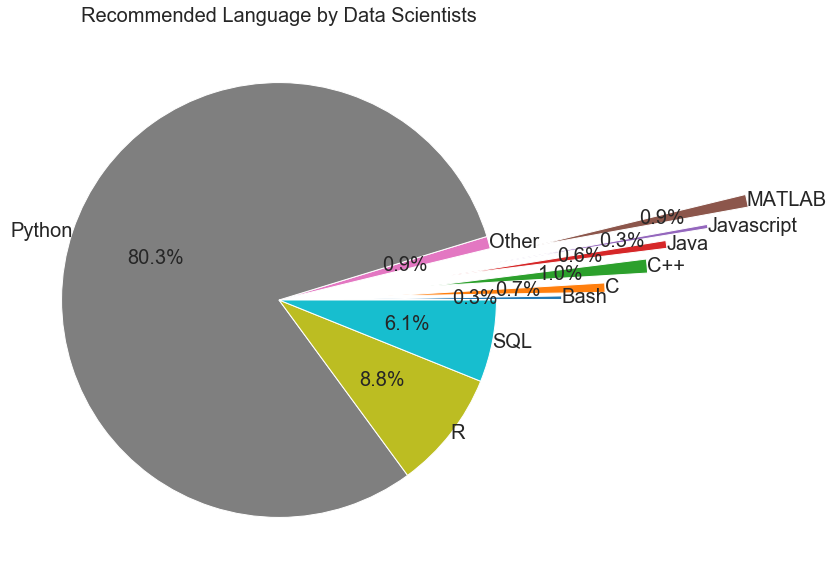

In [187]:
plt.figure(figsize=(10,10))
plt.pie(sets.values, labels=sets.index, explode=(0.3,0.5,0.7,0.8,1.0,1.2,0,0,0,0),
           labeldistance = 1,autopct = '%3.1f%%',shadow = False,pctdistance = 0.6,textprops={'fontsize': 20})
plt.title('Recommended Language by Data Scientists',fontsize = 20)
plt.show()

In [188]:
cloud = ' '.join(bag_words)

In [189]:
cloud

'fundamentals of supervised learning in finance what is machine learning in finance introduction to fundamentals of machine learning in finance support vector machines part support vector machines part svm the kernel trick example svm for prediction of credit spreads tree methods cart trees tree methods random forests tree methods boosting core concepts of unsupervised learning pca dimensionality reduction core concepts of ul pca for stock returns part pca for stock returns part dimension reduction with pca dimension reduction with tsne dimension reduction with autoencoders data visualization clustering ul clustering algorithms ul k clustering ul k means neural algorithm ul hierarchical clustering algorithms ul clustering and estimation of equity correlation matrix ul minimum spanning trees kruskal algorithm ul probabilistic clustering sequence modeling and reinforcement learning sm latent variables sequence modeling sm latent variables for sequences sm state space models sm hidden mar

In [ ]:
    wordcloud = WordCloud(width = 800, height = 800, 
                    background_color ='white',  
                    min_font_size = 5).generate(cloud) 
    # plot the WordCloud image                        
    plt.figure(figsize = (10, 10), facecolor = 'black') 
    plt.imshow(wordcloud) 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 

    plt.show() 

Using a word cloud from the scraped courses, I could see which models, and skills are the most relevant in finance.
ul - unsupervised learning seems to be a really big topic. Feature - involves collecting, determining, preparing features. 

In [192]:
#from IPython.display import Image
#mage(filename='AI in Finance viz.png') 

In [193]:
bag_words

['fundamentals of supervised learning in finance',
 'what is machine learning in finance',
 'introduction to fundamentals of machine learning in finance',
 'support vector machines',
 'part',
 'support vector machines',
 'part',
 'svm',
 'the kernel trick',
 'example',
 'svm for prediction of credit spreads',
 'tree methods',
 'cart trees',
 'tree methods',
 'random forests',
 'tree methods',
 'boosting',
 'core concepts of unsupervised learning',
 'pca',
 'dimensionality reduction',
 'core concepts of ul',
 'pca for stock returns',
 'part',
 'pca for stock returns',
 'part',
 'dimension reduction with pca',
 'dimension reduction with tsne',
 'dimension reduction with autoencoders',
 'data visualization',
 'clustering',
 'ul',
 'clustering algorithms',
 'ul',
 'k',
 'clustering',
 'ul',
 'k',
 'means neural algorithm',
 'ul',
 'hierarchical clustering algorithms',
 'ul',
 'clustering and estimation of equity correlation matrix',
 'ul',
 'minimum spanning trees',
 'kruskal algorithm',
 

Web Scrapping to build the ideal Machine Learning/ Deep Learning Course

# Installing Libraries

In [194]:
#!pip install bs4
#!pip install numpy
#!pip install pandas

#!pip install ast
#!pip install matplotlib
#!pip install nltk
#!pip install wordcloud

In [195]:
import requests
import bs4
from bs4 import BeautifulSoup
import pandas as pd
import time
import re
import numpy as np
import nltk
import nltk
import os
import csv
nltk.download('punkt')
nltk.download('stopwords')
from nltk import word_tokenize
from wordcloud import WordCloud
import matplotlib.pyplot as plt
#from hcluster import pdist, linkage, dendrogram
from nltk.tokenize import RegexpTokenizer
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn.metrics import pairwise_distances

import scipy.cluster.hierarchy as sch



[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


## Scraping CourseReport.com to obtain course information and ratings in data science bootcamps, and online education platforms.



Scraping course report for course postings and rankings to be linked to the relevant skills required. Starts by obtaining all the links for each page. Next iterates through each page to obtain Datascience Course program/website, rating and # of reviews, and links to further investigate courses later.


#create an empty DF 
course_table = pd.DataFrame()
URL = 'https://www.coursereport.com/tracks/data-science-bootcamp'
page = requests.get(URL)
        #specifying a desired format of “page” using the html parser - this allows python to read the various components of the page, rather than treating it as one long string.
soup = BeautifulSoup(page.text, 'html.parser')
#creating a blank list for links
links = []
#web scrapping for links of each page containing relevant data
for divTag in soup.find_all('nav',{'class': 'pagination'}):
    for aTag in divTag.find_all('a'):
        links.append(aTag.get('href'))
        time.sleep(0.5)
links = links[:-1]
#noticed the link for page 2 was grabbed twice instead of page 1 so replaced with the link for page 1
links[0] = '/tracks/data-science-bootcamp'
#resetting the base so the proceeding loop can modify to each specific page
URL = 'https://www.coursereport.com'

for link in links:
    URL = 'https://www.coursereport.com'
    URL += link 
    page = requests.get(URL)
        #specifying a desired format of “page” using the html parser - this allows python to read the various components of the page, rather than treating it as one long string.
    soup = BeautifulSoup(page.text, 'html.parser')
#looping though each course posting and obtaining relevant info
    for courses in soup.find_all("li", class_ = "school-li"): 
        try:
            course_title = courses.find('div', class_ = 'school-header').text.strip()
      #print(job_title)
        except:
            course_title = None

        try:
            rating = courses.find('p', class_ = 'rating-number').text.strip()
        except:
            rating = None

        try:
            link = courses.find('div', attrs={'class': 'school-header'}).find('a', href=True)['href']
        except:
            link = None   
        
        link+='#/courses'
        time.sleep(0.5)
        #building the dataframe row by row 
        course_table = course_table.append({
            'course_title': course_title, 
            'avg_rating': rating,
            'link': link}, ignore_index = True)

### Scraping Links to get summaries

course_table

## Filtering for highest rated schools

Below, the data was cleaned to get the rating and # of reviews in there own respective columns. Many postings that were featured on the website included that in the course platform  title, so this was removed. As avg_rating is a string the columns that were made for reviews and ratings were converted to numeric.

course_table.head()

#course_table = course_table.replace(np.nan, '', regex=True)
course_table = course_table[course_table['avg_rating'].notna()]
course_table['course_title'] = course_table['course_title'].str.replace('Featured','')
course_table['avg_rating'] = course_table['avg_rating'].str.replace('Avg Rating:','')
course_table['avg_rating'] = course_table['avg_rating'].str.replace(' reviews','')
course_table['avg_rating'] = course_table['avg_rating'].str.replace(')','')
#course_table['avg_rating'] = course_table['avg_rating'].str.replace('(','')


course_table[['avg_rating','reviews']] = course_table['avg_rating'].str.split('(',expand=True,)

course_table.tail()


#converting string to numeric
course_table[['avg_rating','reviews']] = course_table[['avg_rating','reviews']].apply(pd.to_numeric)


course_table[course_table['reviews'] > 100].sort_values(by='avg_rating', ascending=False).head(10)



course_sifter = course_table[course_table['reviews'] > 150].sort_values(by='avg_rating', ascending=False)
course_sifter = course_sifter.iloc[0:20,:]
course_sifter = course_sifter.reset_index()
course_sifter

for i in range(len(course_sifter)):
    link=course_sifter.iloc[i,3]
    prefix='https://www.coursereport.com'
    course_sifter.iloc[i,3]=prefix+link

course_sifter.iloc[i,3]

program_table = pd.DataFrame()
for i in range(len(course_sifter)):
    detail = requests.get(course_sifter.iloc[i,3]) 
    soup = BeautifulSoup(detail.text, "lxml")
    for courses in soup.find_all("ul", class_ = "course-card"): 
        try:
            program_title = courses.find('h3').text.strip()
      #print(job_title)
        except:
            program_title = None

        try:
            skills = courses.find('div', class_ = 'details').text.strip()
        except:
            skills = None
        try:
            course_link = courses.find('span', attrs={'class': 'btn btn-default btn-apply small'}).find('a', href=True)['href']
        except:
            course_link = None
        
        time.sleep(0.5)
        #building the dataframe row by row 
        program_table = program_table.append({
            'course_title': course_sifter.iloc[i,2],
            'program_title': program_title, 
            'skills': skills,
            'avg_rating': course_sifter.iloc[i,1],
            'reviews': course_sifter.iloc[i,4],
            'course_link': course_link}, ignore_index = True)

program_table.head()

#copier=program_table
copier=program_table
program_table=copier


print(program_table.iloc[0,4])

#program_table.to_csv(r'C:\Users\Tyler\Documents\Python notes\Project\wtf.csv', index = False)


# program_table.columns = program_table.columns.str.strip()
# program_table = program_table[program_table.skills != None]
# program_table = program_table[program_table.skills != ""]
# program_table.dropna()
program_table.drop_duplicates(keep=False,inplace=True) 
program_table = program_table.reset_index(drop=True)

program_table.head()

## Obtaining list of acceptable courses from highly rated schools

The following list named skillset was created in order to search the schools for keywords that are relavent towards AI,ML and data science...

skillset = ['deep learning', 'machine learning', 'ai' ,'artificial intelligence', 'ml','data science', 'artificial', 'intelligence']

program_table['descript']='skills'
for skill in skillset:
    program_table[skill] = np.zeros(len(program_table))
#reset_index
program_table = program_table.reset_index()
program_table.head(5)

program_table.iloc[0,6]

text = str(program_table.iloc[0,6]).lower()
text

program_table['cleaned_course']='blank'
program_table['cleaned_skills']='blank'
    

Now I will search if the list of key words defined as "skillset' appear in either the course title or description....

tokenized=[]
for i in range(len(program_table)):
    try:
        text = str(program_table.iloc[i,6])
        
        string = re.sub(r'\,', ' ', text) # remove ","
        string = re.sub(r'([a-z](?=[A-Z])|[A-Z](?=[A-Z][a-z]))', r'\1 ', string) # spacing betweeen capitals "MachineLearning"
        string = string.lower() # converting everything to lower case
        #string = re.sub(r'\n',' ',string) 
        string = re.sub(r'\,', ' ', string) # remove ","
        string = re.sub('/', ' ', string) # remove "/"
       
        string = re.sub(r'\(', ' ', string) # remove "("
        string = re.sub(r'\)', ' ', string) # remove ")"
        string = re.sub(' +',' ',string) # remove more than one space  
        
        
        text2 = str(program_table.iloc[i,4])
        string2 = re.sub(r'\,', ' ', text2) # remove ","
        string2 = re.sub(r'([a-z](?=[A-Z])|[A-Z](?=[A-Z][a-z]))', r'\1 ', string2)
        string2 = string2.lower()
        #string2 = re.sub(r'\n',' ',string2) 
        string2 = re.sub(r'\,', ' ', string2) # remove ","
        string2 = re.sub('/', ' ', string2) # remove "/"
        string2 = re.sub(r'\(', ' ', string2) # remove "("
        string2 = re.sub(r'\)', ' ', string2) # remove ")"
        string2 = re.sub(' +',' ',string2) # remove more than one space  
        
                
    except:
        text = None
        text = "" 
        text2 = None
        text2 = ""
    print(string2)
    program_table['cleaned_course'][i] = string2
    program_table['cleaned_skills'][i] = string
    #program_table.iloc[i,4] = string2
    
    for sk in skillset :
        
        if any(x in sk for x in ['+']):
            skk = re.escape(sk)
        else:
            skk = sk
        result = re.search(r'(?:^|(?<=\s))' + skk + r'(?=\s|$)',string)
        result2 = re.search(r'(?:^|(?<=\s))' + skk + r'(?=\s|$)',string2)
        
        if result:

            program_table_text = 1
            
        else:
            program_table_text = 0
        
        if result2:    
            program_table_text2 = 1
            
        else:
            program_table_text2 = 0

        program_table[sk][i] = program_table_text+program_table_text2

program_table.head()

## Filtering results for ideal courses from best matched highly rated schools

After trying to filter out some of the results I still have too many options and it can be seen that some of the options may only contain data science, or ML/AI. To filter more I will make them require definitely require some aspect of Machine Learning first... and I can further reduce later.

program_table['sum'] = program_table.iloc[:,8:15].sum(axis=1) #


program_table['sum_AI'] = program_table.iloc[:,8:12].sum(axis=1) #

program_table = program_table[program_table['sum'] != 0]
program_table = program_table[program_table['sum_AI'] != 0]
program_table = program_table[program_table['data science'] != 0]


program_table

The top 2 results that pertain to ML/AI with a high rating to best model the course off of are the Data Science Masters Program with Deep Learning offered by GreyAtom School of Data Science with an incredible rating of 4.92 and over 250 reviews as well as Data Science with Python: Machine Learning, Data Science with R: Machine Learning as well as Deep Learning with Tensorflow from the NYC Data Science Academy with an excellent rating of 4.84.

These courses will now be scraped in order to build the ideal curriculum....


link1 = program_table['course_link'][11]
link2 = program_table['course_link'][10]
link3 = program_table['course_link'][8]
grey = ['https://greyatom.com/programs/artificial-intelligence-machine-learning'] #sadly link was broken for this had to manually add
links = [link1, link2, link3]


## Scrapping Grey Atom and NYC Data Academy courses


counter=0
module_table = pd.DataFrame()
for link in grey:
    #URL = 'https://www.coursereport.com'
    URL = link 
    page = requests.get(URL)
    print(link)
        #specifying a desired format of “page” using the html parser - this allows python to read the various components of the page, rather than treating it as one long string.
    soup = BeautifulSoup(page.text, 'html.parser')
#looping though each course posting and obtaining relevant info
    for courses in soup.find_all("div", class_ = "col-md-4 d-flex"): 
        try:
            module_text = courses.find('ul', class_ = 'pt-2 pt-md-0 font-weight-light').text.strip()
      #print(job_title)
        except:
            module_text = None

        try:
            module_title = courses.find('h4', class_ = 'card-title mt-0 d-none d-md-block').text.strip()
        except:
            module_title = None
  
        
        counter+=1
        time.sleep(0.5)
        #building the dataframe row by row 
        module_table = module_table.append({ 
            'module_title': module_title,
            'module_text': module_text}, ignore_index = True)


module_table = module_table.drop(module_table.index[15:17])
module_table = module_table.drop(module_table.index[0:3])


module_table.head()

counter=0
module_table2 = pd.DataFrame()
unit_table2 = pd.DataFrame()
for link in links:
    #URL = 'https://www.coursereport.com'
    URL = link 
   

    headers = {'User-Agent':'Mozilla/5.0'}
 
    page = requests.get(URL, headers=headers)
    #page = requests.get(URL)
    print(link)
        #specifying a desired format of “page” using the html parser - this allows python to read the various components of the page, rather than treating it as one long string.
    soup = BeautifulSoup(page.text, 'html.parser')
#looping though each course posting and obtaining relevant info
    content_list =  soup.find(class_ = 'page-wrap')#, class_ = 'page-wrap')
    descript = content_list.find_all('ul')
    title = content_list.find_all('p')
    #print(killyourself)
    for x in descript:
        try:
            unit_description = x.find_all('li')
            
            
        except:
            unit_description = None
        
        module_table2 = module_table2.append({'course': URL, 'module_text': unit_description}, ignore_index = True)
    for z in title:
        try:
            unit_title = z.find('strong').text.strip()
            
            
        except:
            unit_title = None
        unit_table2 = unit_table2.append({'module_title': unit_title}, ignore_index = True)
        counter+=1
        
        #building the dataframe row by row 
   

#sneakyT=module_table2
#module_table2=sneakyT

module_table2 = module_table2.drop(module_table2.index[60:72])

module_table2['unit']=''


# Deleting unwanted rows

# pd.set_option('display.max_rows', None)
# pd.set_option('display.max_columns', None)
# pd.set_option('display.width', None)
# pd.set_option('display.max_colwidth', -1)
# module_table2

module_table2 = module_table2.drop(module_table2.index[40:55])

module_table2 = module_table2.drop(module_table2.index[16:35])

module_table2 = module_table2.drop(module_table2.index[0:6])

# resetting index 
module_table2.reset_index(inplace = True)

#removing unnecesarry columns involving the units

#unit_table2

unit_table2 = unit_table2.drop(unit_table2.index[134:177])

unit_table2 = unit_table2.drop(unit_table2.index[82:129])

unit_table2 = unit_table2.drop(unit_table2.index[26:77])

unit_table2 = unit_table2.drop(unit_table2.index[0:16])

unit_table2.reset_index(inplace = True)

#unit_table2

#module_table2 

df_NYC = pd.merge(module_table2, unit_table2, left_index=True, right_index=True)

df_NYC.head()

df_greyatom=module_table

df_greyatom.head()

df_greyatom['course']= 'Data Science Masters Program with Deep Learning'

df_NYC = df_NYC.replace('https://nycdatascience.com/courses/deep-learning/', 'Deep Learning (with TensorFlow 2, Keras and PyTorch)')

df_NYC = df_NYC.replace('https://nycdatascience.com/courses/data-science-with-r-machine-learning/','Data Science with R: Machine Learning')

df_NYC = df_NYC.replace('https://nycdatascience.com/courses/data-science-with-python-machine-learning/','Data Science with Python: Machine Learning')


### Final Table

df_NYC.head()

## Determining best modules for ideal Machine Learning course

df_NYC = df_NYC[['course','module_title','module_text']]
df_greyatom = df_greyatom[['course','module_title','module_text']]

frames = [df_NYC, df_greyatom]

result_df = pd.concat(frames)



In [ ]:
#result_df.to_csv(r'C:/Users/Tyler/Documents/UofT/DS/AdvancedMachineLearning.csv', index = False)


In [196]:
result_df = pd.read_csv(r'./AdvancedMachineLearning.csv')

In [198]:
result_df

,course,module_title,module_text
0,"Deep Learning (with TensorFlow 2, Keras and PyTorch)",Unit 1: The Unreasonable Effectiveness of Deep Learning,"[<li>An Introduction to Neural Networks and Deep Learning</li>, <li>Interactive Visualization of an Artificial Neural Network</li>, <li>Hardware Options for Deep Learning, including How to Build a Deep Learning Server</li>, <li>Running Jupyter Notebooks within a Docker Container</li>, <li>The Families of Deep Neural Nets and their Applications</li>, <li>A Shallow TensorFlow 2 Neural Network with Keras Layers</li>]"
1,"Deep Learning (with TensorFlow 2, Keras and PyTorch)",Unit 2: How Deep Learning Works,"[<li>Essential Theory I: Neural Units</li>, <li>Interactive Visualization of Neural Units</li>, <li>Essential Theory II: Cost Functions, Gradient Descent, and Backpropagation</li>, <li>Interactive Visualization of Neural Networks</li>, <li>An Intermediate Neural Network</li>, <li>Data Sets for Deep Learning</li>, <li><strong>Your Deep Learning Project:</strong> Ideating</li>]"
2,"Deep Learning (with TensorFlow 2, Keras and PyTorch)",Unit 3: Building and Training a Deep Learning Network,"[<li>Review Content and Take-Home Exercises</li>, <li>Essential Theory III: Weight Initialization and Mini-Batches</li>, <li>Essential Theory IV: Unstable Gradients and Avoiding Overfitting</li>, <li>A Deep TensorFlow 2 Neural Network with Keras Layers</li>, <li>TensorBoard and the Interpretation of Model Outputs</li>]"
3,"Deep Learning (with TensorFlow 2, Keras and PyTorch)",Unit 4: Machine Vision,"[<li>Introduction to Convolutional Neural Networks for Visual Recognition</li>, <li>Classic ConvNet Architectures: LeNet-5 and AlexNet</li>, <li>Object Detection</li>, <li>Image Segmentation</li>, <li>Transfer Learning</li>, <li><strong>Your Deep Learning Project:</strong> Formulating</li>]"
4,"Deep Learning (with TensorFlow 2, Keras and PyTorch)",Unit 5: Natural Language Processing,"[<li>Reviewing Content and Take-Home Exercises</li>, <li>Word Vectors: word2vec and Vector-Space Embedding</li>, <li>Recurrent Neural Networks</li>, <li>Long Short-Term Memory Units</li>, <li>Gated Recurrent Units</li>, <li>Classifying Documents: Sentiment Analysis</li>]"
5,"Deep Learning (with TensorFlow 2, Keras and PyTorch)",Unit 6: Time Series Analysis,"[<li>Autoencoders: Encoder-Decoder Structures</li>, <li>Sequence-to-Sequence Models and Attention</li>, <li>Financial Forecasting</li>, <li>Hyperparameter Tuning</li>, <li>Non-Sequential Models</li>, <li><strong>Your Deep Learning Project</strong>: Assessing</li>]"
6,"Deep Learning (with TensorFlow 2, Keras and PyTorch)",Unit 7: Advanced TensorFlow,"[<li>Introducing TensorFlow Graphs</li>, <li>Representing Neurons as TensorFlow Graphs</li>, <li>Optimizing TensorFlow Graphs</li>, <li>Deep Learning with TensorFlow 1.x</li>, <li>Deep Learning with TensorFlow 2.x</li>]"
7,"Deep Learning (with TensorFlow 2, Keras and PyTorch)",Unit 8: PyTorch,"[<li>Comparison of the Leading Deep Learning Libraries</li>, <li>Autodifferentiation</li>, <li>Sequential Deep Learning Models in PyTorch</li>, <li>Forward Propagation and Optimization in PyTorch</li>, <li>Model Validation in PyTorch</li>, <li><strong>Your Deep Learning Project:</strong> Improving</li>]"
8,"Deep Learning (with TensorFlow 2, Keras and PyTorch)",Unit 9: Generative Adversarial Networks,"[<li>GAN Applications</li>, <li>Essential GAN Theory</li>, <li>Simulating Artistic Creativity with a GAN</li>, <li>Resources for Deep Learning Self-Study</li>]"
9,"Deep Learning (with TensorFlow 2, Keras and PyTorch)",Unit 10: Reinforcement Learning,"[<li>Applications of Reinforcement Learning</li>, <li>Reinforcement Learning Environments: OpenAI Gym</li>, <li>Essential Reinforcement Learning Theory</li>, <li>Deep Q-Learning Networks</li>, <li>Policy Gradients and the Actor-Critic Algorithm</li>, <li>Jeanne Calment and Your Role in the AI Revolution</li>, <li><strong>Your Deep Learning Project:</strong> Presentation</li>]"


In [199]:
result_df['cleaned']=''
skillset = ['deep learning', 'machine learning', 'ai' ,'artificial intelligence', 'ml','data science', 'cost analysis','prediction','code','coding','data architecture','programming','machine learning','ai','statistics','mathematic','communication','critical thinking','visualization','master','professional','bachelor','business decisions','operationalizing','infrastructure','prototype','workflows','modeling','statistical','cloud','jupyter','rstudio','pycharm','atom','matlab','visual studio','spyder','vim','notepad','sublime','google colab','google','google cloud','notebook','ai platform','datalab','binder','ibm watson','ibm watson studio','ocean','python','r','sql','c','c++','java','javascript','typescript','bash','ggplot','matplotlib','plotly','d3','shiny','seaborn','geoplotlib','leaflet','cpu','gpu','tpu','linear','logistic','regression','forest','gradient','bayesian','neural networks','neural','dense','convolutional','transformer','ml','augmentation','automated','feature engineering','selection','architecture','','pipelines','image','video','pil','cv2','skimage','u-net','mask r-cnn','image segmentation','object detection  ','yolov3','retinanet','image classification','vgg','inception','resnet','gan','vae','computer vision','generative networks','word embeddings','vectors','glove','fasttext','word2ve','encoder','decorder seq2seq','vanilla','contextualized embeddings','elmo','cove','gpt-2','bert','xlnet','scikit-learn','tensorflow','keras','randomforest','xgboost','pyTorch','caret','lightgbm','spark mlib','fast.ai','amazon','azure','salesforce','alibaba','aws']
#list of skills]

In [200]:

for skill in skillset:
    result_df[skill] = np.zeros(len(result_df))
#reset_index
result_df = result_df.reset_index()
result_df.head(5)

,index,course,module_title,module_text,cleaned,deep learning,machine learning,ai,artificial intelligence,ml,data science,cost analysis,prediction,code,coding,data architecture,programming,statistics,mathematic,communication,critical thinking,visualization,master,professional,bachelor,business decisions,operationalizing,infrastructure,prototype,workflows,modeling,statistical,cloud,jupyter,rstudio,pycharm,atom,matlab,visual studio,spyder,vim,notepad,sublime,google colab,google,google cloud,notebook,ai platform,datalab,binder,ibm watson,ibm watson studio,ocean,python,r,sql,c,c++,java,javascript,typescript,bash,ggplot,matplotlib,plotly,d3,shiny,seaborn,geoplotlib,leaflet,cpu,gpu,tpu,linear,logistic,regression,forest,gradient,bayesian,neural networks,neural,dense,convolutional,transformer,augmentation,automated,feature engineering,selection,architecture,,pipelines,image,video,pil,cv2,skimage,u-net,mask r-cnn,image segmentation,object detection,yolov3,retinanet,image classification,vgg,inception,resnet,gan,vae,computer vision,generative networks,word embeddings,vectors,glove,fasttext,word2ve,encoder,decorder seq2seq,vanilla,contextualized embeddings,elmo,cove,gpt-2,bert,xlnet,scikit-learn,tensorflow,keras,randomforest,xgboost,pyTorch,caret,lightgbm,spark mlib,fast.ai,amazon,azure,salesforce,alibaba,aws
0,0,"Deep Learning (with TensorFlow 2, Keras and PyTorch)",Unit 1: The Unreasonable Effectiveness of Deep Learning,"[<li>An Introduction to Neural Networks and Deep Learning</li>, <li>Interactive Visualization of an Artificial Neural Network</li>, <li>Hardware Options for Deep Learning, including How to Build a Deep Learning Server</li>, <li>Running Jupyter Notebooks within a Docker Container</li>, <li>The Families of Deep Neural Nets and their Applications</li>, <li>A Shallow TensorFlow 2 Neural Network with Keras Layers</li>]",,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,"Deep Learning (with TensorFlow 2, Keras and PyTorch)",Unit 2: How Deep Learning Works,"[<li>Essential Theory I: Neural Units</li>, <li>Interactive Visualization of Neural Units</li>, <li>Essential Theory II: Cost Functions, Gradient Descent, and Backpropagation</li>, <li>Interactive Visualization of Neural Networks</li>, <li>An Intermediate Neural Network</li>, <li>Data Sets for Deep Learning</li>, <li><strong>Your Deep Learning Project:</strong> Ideating</li>]",,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2,"Deep Learning (with TensorFlow 2, Keras and PyTorch)",Unit 3: Building and Training a Deep Learning Network,"[<li>Review Content and Take-Home Exercises</li>, <li>Essential Theory III: Weight Initialization and Mini-Batches</li>, <li>Essential Theory IV: Unstable Gradients and Avoiding Overfitting</li>, <li>A Deep TensorFlow 2 Neural Network with Keras Layers</li>, <li>TensorBoard and the Interpretation of Model Outputs</li>]",,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,

In [201]:
result_df.iloc[1,3]

'[<li>Essential Theory I: Neural Units</li>, <li>Interactive Visualization of Neural Units</li>, <li>Essential Theory II: Cost Functions, Gradient Descent, and Backpropagation</li>, <li>Interactive Visualization of Neural Networks</li>, <li>An Intermediate Neural Network</li>, <li>Data Sets for Deep Learning</li>, <li><strong>Your Deep Learning Project:</strong> Ideating</li>]'

In [202]:
tokenized=[]

for i in range(len(result_df)):
    try:
        text = str(result_df.iloc[i,3])
        clean = re.compile('<.*?>')
        text = re.sub(clean, '',text)
        string = re.sub(r'\,', ' ', text) # remove ","
        string = re.sub('<li>', ' ', string) # remove ","
        tring = re.sub('< li>', ' ', string) # remove ","
        tring = re.sub('>', ' ', string) # remove ","
        string = re.sub(r'([a-z](?=[A-Z])|[A-Z](?=[A-Z][a-z]))', r'\1 ', string) # spacing betweeen capitals "MachineLearning"
        string = string.lower() # converting everything to lower case
        #string = re.sub(r'\n',' ',string) 
        #string = re.sub(r'\,', ' ', string) # remove ","
        string = re.sub('/', ' ', string) # remove "/"      
        string = re.sub(r'\(', ' ', string) # remove "("
        string = re.sub(r'\)', ' ', string) # remove ")"
        string = re.sub(' +',' ',string) # remove more than one space  
              
    except:
        text = None
        text = "" 

    result_df['cleaned'][i] = string
    #result_df.iloc[i,4] = string2
    
    for sk in skillset :
        
        if any(x in sk for x in ['+']):
            skk = re.escape(sk)
        else:
            skk = sk
        result = re.search(r'(?:^|(?<=\s))' + skk + r'(?=\s|$)',string)
        #result2 = re.search(r'(?:^|(?<=\s))' + skk + r'(?=\s|$)',string2)
        
        if result:
            result_df[sk][i] = 1

In [203]:
result_df.iloc[:,4:]

,cleaned,deep learning,machine learning,ai,artificial intelligence,ml,data science,cost analysis,prediction,code,coding,data architecture,programming,statistics,mathematic,communication,critical thinking,visualization,master,professional,bachelor,business decisions,operationalizing,infrastructure,prototype,workflows,modeling,statistical,cloud,jupyter,rstudio,pycharm,atom,matlab,visual studio,spyder,vim,notepad,sublime,google colab,google,google cloud,notebook,ai platform,datalab,binder,ibm watson,ibm watson studio,ocean,python,r,sql,c,c++,java,javascript,typescript,bash,ggplot,matplotlib,plotly,d3,shiny,seaborn,geoplotlib,leaflet,cpu,gpu,tpu,linear,logistic,regression,forest,gradient,bayesian,neural networks,neural,dense,convolutional,transformer,augmentation,automated,feature engineering,selection,architecture,,pipelines,image,video,pil,cv2,skimage,u-net,mask r-cnn,image segmentation,object detection,yolov3,retinanet,image classification,vgg,inception,resnet,gan,vae,computer vision,generative networks,word embeddings,vectors,glove,fasttext,word2ve,encoder,decorder seq2seq,vanilla,contextualized embeddings,elmo,cove,gpt-2,bert,xlnet,scikit-learn,tensorflow,keras,randomforest,xgboost,pyTorch,caret,lightgbm,spark mlib,fast.ai,amazon,azure,salesforce,alibaba,aws
0,[an introduction to neural networks and deep learning interactive visualization of an artificial neural network hardware options for deep learning including how to build a deep learning server running jupyter notebooks within a docker container the families of deep neural nets and their applications a shallow tensor flow 2 neural network with keras layers],1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,[essential theory i: neural units interactive visualization of neural units essential theory ii: cost functions gradient descent and backpropagation interactive visualization of neural networks an intermediate neural network data sets for deep learning your deep learning project: ideating],1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,[review content and take-home exercises essential theory iii: weight initialization and mini-batches essential theory iv: unstable gradients and avoiding overfitting a deep tensor flow 2 neural network with keras layers tensor board and the interpretation of model outputs],0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,[introduction to convolutional neural networks for visual recognition classic conv net architectures: le net-5 and alex net object detection image segmentation transfer learning yo

In [204]:
df_results2=result_df.iloc[:,5:]
df_concepts = df_results2.loc[:, (df_results2 != 0).any(axis=0)]

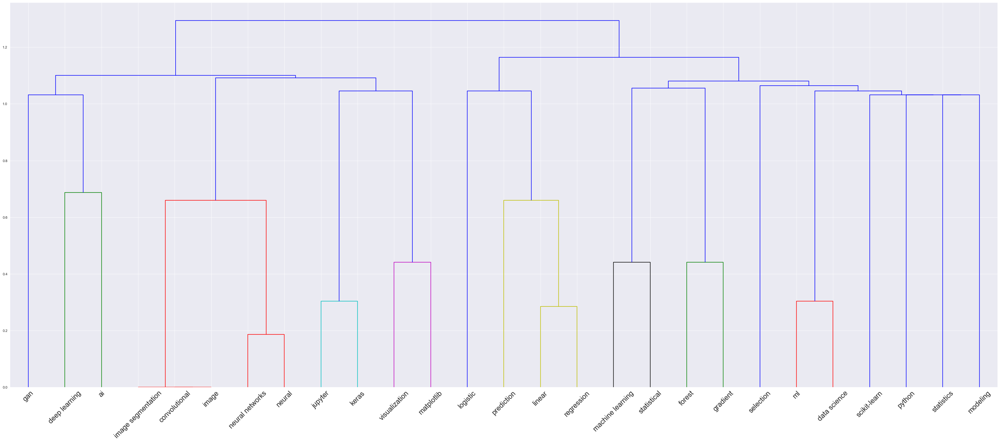

In [205]:
# Calculating the distance
dist = pdist(df_concepts.T, metric='euclidean')

# Calculating the linkage matrix
link = linkage(df_concepts.T, method='complete', metric='correlation')

# Draw the dendrogram
plt.figure(figsize=(50,20))
B=dendrogram(link, labels=df_concepts.columns, leaf_font_size=20)

In [206]:
result_df

,index,course,module_title,module_text,cleaned,deep learning,machine learning,ai,artificial intelligence,ml,data science,cost analysis,prediction,code,coding,data architecture,programming,statistics,mathematic,communication,critical thinking,visualization,master,professional,bachelor,business decisions,operationalizing,infrastructure,prototype,workflows,modeling,statistical,cloud,jupyter,rstudio,pycharm,atom,matlab,visual studio,spyder,vim,notepad,sublime,google colab,google,google cloud,notebook,ai platform,datalab,binder,ibm watson,ibm watson studio,ocean,python,r,sql,c,c++,java,javascript,typescript,bash,ggplot,matplotlib,plotly,d3,shiny,seaborn,geoplotlib,leaflet,cpu,gpu,tpu,linear,logistic,regression,forest,gradient,bayesian,neural networks,neural,dense,convolutional,transformer,augmentation,automated,feature engineering,selection,architecture,,pipelines,image,video,pil,cv2,skimage,u-net,mask r-cnn,image segmentation,object detection,yolov3,retinanet,image classification,vgg,inception,resnet,gan,vae,computer vision,generative networks,word embeddings,vectors,glove,fasttext,word2ve,encoder,decorder seq2seq,vanilla,contextualized embeddings,elmo,cove,gpt-2,bert,xlnet,scikit-learn,tensorflow,keras,randomforest,xgboost,pyTorch,caret,lightgbm,spark mlib,fast.ai,amazon,azure,salesforce,alibaba,aws
0,0,"Deep Learning (with TensorFlow 2, Keras and PyTorch)",Unit 1: The Unreasonable Effectiveness of Deep Learning,"[<li>An Introduction to Neural Networks and Deep Learning</li>, <li>Interactive Visualization of an Artificial Neural Network</li>, <li>Hardware Options for Deep Learning, including How to Build a Deep Learning Server</li>, <li>Running Jupyter Notebooks within a Docker Container</li>, <li>The Families of Deep Neural Nets and their Applications</li>, <li>A Shallow TensorFlow 2 Neural Network with Keras Layers</li>]",[an introduction to neural networks and deep learning interactive visualization of an artificial neural network hardware options for deep learning including how to build a deep learning server running jupyter notebooks within a docker container the families of deep neural nets and their applications a shallow tensor flow 2 neural network with keras layers],1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,"Deep Learning (with TensorFlow 2, Keras and PyTorch)",Unit 2: How Deep Learning Works,"[<li>Essential Theory I: Neural Units</li>, <li>Interactive Visualization of Neural Units</li>, <li>Essential Theory II: Cost Functions, Gradient Descent, and Backpropagation</li>, <li>Interactive Visualization of Neural Networks</li>, <li>An Intermediate Neural Network</li>, <li>Data Sets for Deep Learning</li>, <li><strong>Your Deep Learning Project:</strong> Ideating</li>]",[essential theory i: neural units interactive visualization of neural units essential theory ii: cost functions gradient descent and backpropagation interactive visualization of neural networks an intermediate neural network data sets for deep learning your deep learning project: ideating],1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0

# Advanced Machine Learning Course Breakdown

Using the dendrogram above and judgement based off of the top 4 courses involving Machine Learning that best matched the key skills, a course outline was created for a rigorous program of Advanced Machine Learning.

To effectively teach the more advanced topics of this course, it was deemed that there would be a refresher module of basic Machine Learning topics to start. The breakdown of all the modules are as follows, with modules 1-3 being mostly review:


## Module 1: Fundamentals of Machine Learning

- Linear Regression 
- Logistic regression
- Make your first prediction with Linear Regression
- Optimizing linear regression models through Regularization
-  Multi class classification problems

## Module 2: Supervised Learning and Ensembling Techniques

- Support vector machines 
- decision trees 
- random forests 
- KNN
- Naive Bayes
- Bagging
- Boosting
- Stacking
- Hyperparameter tuning
- Assignment on running models and choosing optimal 


## Module 3: Unsupervised Learning and NLP

- Control principal component analysis kmeans and hierarchical clustering
- KMeans Clustering
- Hierarchical clustering
- word vectors: word2vec 
- vector-space embedding
- TF and TF-idf
- Sentiment analysis


## Module 4: Intro to Deep Learning

- Neural Networks
- Recurrent Neural Networks
- Visualization of an Artificial Neural Network
- Deep Learing and hardware requirements/ building a deep learning server
- Docker Containers with Jupyter Notebook
- Deep Neural Network families and applications
- Using Keras Layers and TensorFlow to create a Neural Network 

## Module 5: Time Series Analysis

- Autoencoders
- Sequence-to-Sequence Models
- Financial Forecasting
- Non Sequential Models

## Module 6: Machine Vision

- Convolutional Neural Networks
- Visual Recognition
- ConvNet Architectures
- Object Detection
- Image Segmentation
- Transfer Learning

## Module 7: TensorFlow Advanced Topics
- TensorFlow Graphs
- Neurons and TensorFlow Graphing applications
- Visualization and optimization of neural networks 
- TensorFlow and Deep Learning


## Module 8: PyTorch Advanced Topics
- Deep Learning Libraries
- Autodifferentiation
- Sequential Deep Learning Models
- Forward Propagation and Optimization
- Deep Learning Model Validation

## Module 9: Generative Adversarial Networks
- Applications of GAN
- GAN theory
- Artistic Creativity with a GAN

## Module 9: Reinforcement Learning
-  Reinforcement Learning theory
- Applications of Reinforcement Learning
- Reinforcement Learning Environments
- OpenAI
- Deep Q-Learning Networks
- Policy Gradients and the Actor-Critic Algorithm
- Deep Learning Project









# Visualizations of the job market to support the course curriculum

In [207]:
df_final=pd.read_csv('./final.csv', low_memory=False)
df=pd.read_csv('./kaggle.csv')

### Machine Learning Framework Usage

In [208]:
df.columns.get_loc("Q24_Part_1")

100

In [209]:
df.columns.get_loc("Q24_Part_12")

111

In [210]:
df_24=df.iloc[:,100:112]
df_24.columns=['Linear or Logistic Regression', 'Decision Trees/ Random Forests', 'Gradient Boosting', 'Bayesian Approaches', 'Evolutionary Approaches', 'Dense Neural Networks', 'Convolutional Neural Networks', 'Generative Adversarial Networks', 'Recurrent Neural Networks', 'Transformer Networks', 'None', 'Other']
df_24.head()

,Linear or Logistic Regression,Decision Trees/ Random Forests,Gradient Boosting,Bayesian Approaches,Evolutionary Approaches,Dense Neural Networks,Convolutional Neural Networks,Generative Adversarial Networks,Recurrent Neural Networks,Transformer Networks,None,Other
0,1,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,0,0,1,0,0,0,0,0
3,1,1,1,0,0,0,0,0,0,0,0,0
4,1,1,1,1,0,0,1,1,1,0,0,0


In [211]:
sets3=df_24.sum(axis=0)
#sets3=sets3.drop(index = 'None')

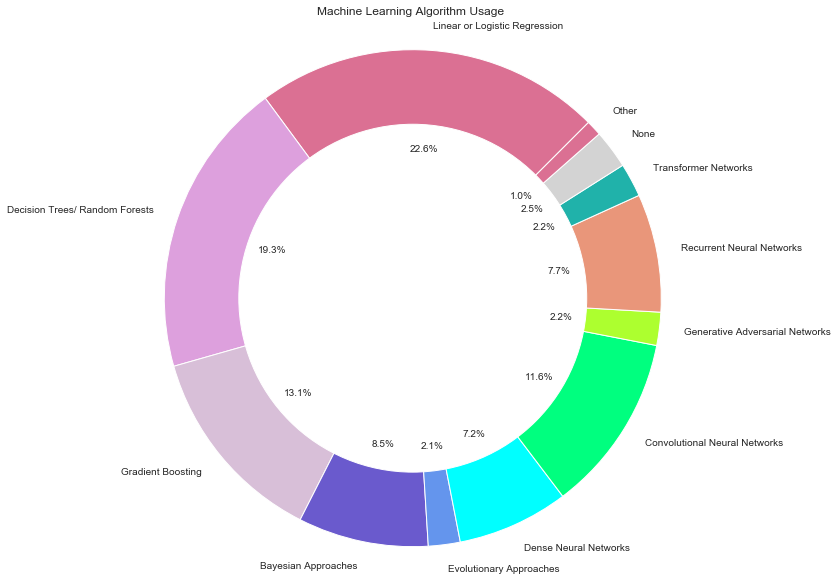

In [213]:
colors = ['palevioletred','plum','thistle','slateblue', 'cornflowerblue', 'cyan', 'springgreen', 'greenyellow', 'darksalmon', 'lightseagreen', 'lightgray']

fig1, ax1 = plt.subplots(figsize=(12,8))
ax1.pie(sets3.values, labels=sets3.index, 
           autopct = '%3.1f%%',shadow = False, startangle = 45 ,pctdistance = 0.6, colors=colors)

centre_circle = plt.Circle((0,0),0.70,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)#30

ax1.axis('equal')  
plt.tight_layout()
plt.title('Machine Learning Algorithm Usage')
#plt.savefig('C:/Users/Tyler/Documents/UofT/DS/plotty')
plt.show()


## Bar Chart 

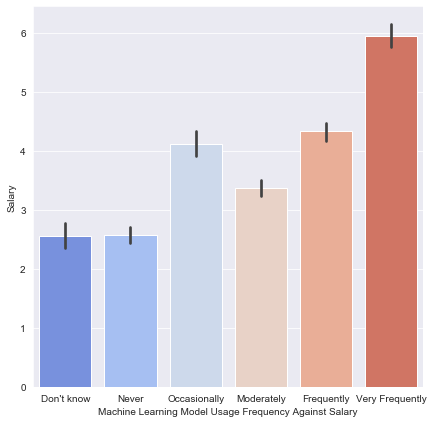

In [214]:
import seaborn as sns
q8_encoded={'I do not know': "Don't know", 
            'No (we do not use ML methods)': 'Never',  
            'We use ML methods for generating insights (but do not put working models into production)': 'Occasionally', 
            'We are exploring ML methods (and may one day put a model into production)': 'Moderately', 
            'We recently started using ML methods (i.e., models in production for less than 2 years)':'Frequently', 
            'N/A': 'Never',
            'We have well established ML methods (i.e., models in production for more than 2 years)': 'Very Frequently'}
colors = ['palevioletred','plum','thistle','slateblue', 'cornflowerblue', 'cyan', 'springgreen', 'greenyellow', 'darksalmon', 'lightseagreen', 'lightgray']
q8_order={"Don't know":0, 'Never':1, 'Occasionally':2, 'Moderately':3, 'Frequently':4, 'Very Frequently':5}
df.loc[:, 'Q8_name']=df.loc[:, 'Q8'].map(q8_encoded)
df_dims = (7, 7)
fig, ax = plt.subplots(figsize=df_dims)
sns.barplot(x='Q8_name', y='Q10_Encoded', ax=ax, data=df,   order=q8_order, palette="coolwarm")
plt.xlabel('Machine Learning Model Usage Frequency Against Salary')
plt.ylabel('Salary')
plt.show()

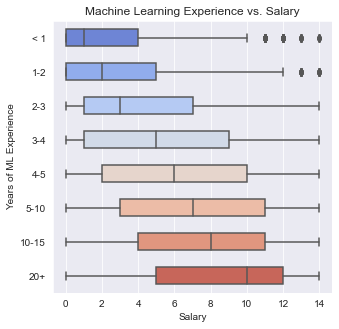

In [215]:
q23_encoded={'< 1 years': '< 1', 
             '1-2 years':'1-2',
             '2-3 years':'2-3',
             '3-4 years':'3-4',
             '4-5 years':'4-5',
             '5-10 years':'5-10',
             '10-15 years':'10-15',
             '20+ years':'20+'}
        
colors = ['palevioletred','plum','thistle','slateblue', 'cornflowerblue', 'cyan', 'springgreen', 'greenyellow', 'darksalmon', 'lightseagreen', 'lightgray']
q23_order={"< 1":0, '1-2':1, '2-3':2, '3-4':3, '4-5':4, '5-10':5, '10-15':6,  '20+':7}
df.loc[:, 'Q23_name']=df.loc[:, 'Q23'].map(q23_encoded)
df_dims = (5, 5)
fig, ax = plt.subplots(figsize=df_dims)
sns.boxplot(y='Q23_name', x='Q10_Encoded', ax=ax, data=df, width=0.5, orient ='h', order=q23_order, palette="coolwarm")
plt.ylabel('Years of ML Experience')
plt.xlabel('Salary')
plt.title('Machine Learning Experience vs. Salary')
plt.show()

### Introduction to Finance course design

In [ ]:
import requests
from bs4 import BeautifulSoup
import pandas as pd

import requests
from bs4 import BeautifulSoup
import csv
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
import unicodedata
import nltk
import html
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn.metrics import pairwise_distances
import re

In [ ]:
# job_listings_url = 'https://www.classcentral.com/search?q=finance&sort=rating-up'

# response = requests.get(job_listings_url)
# listingSoup = BeautifulSoup(response.text, 'html.parser')

# all_links = listingSoup.find_all('a', attrs={'class': 'color-charcoal block line-tight course-name'})

# # Links are relative, of the form /course/course_number. Need to append this to main host name
# web_pages = ['https://www.classcentral.com' + link.get('href') for link in all_links]
# len(web_pages)

# def getDescription(url):
#     response = requests.get(url)
#     jobSoup = BeautifulSoup(response.text, 'html.parser')
#     summary = jobSoup.find_all('div', attrs={'class': 'wysiwyg line-wide text-1 margin-bottom-large'})
#     return summary

# descriptions = [getDescription(page) for page in web_pages]

# all_stars = listingSoup.find_all('span', attrs = {'class': 'text-4 color-charcoal block'})[1:] #skip first, it's an ad
# all_stars = [float(star.text) for star in all_stars]
# print(len(all_stars))

# # 54 ratings instead of 50 because of fucking ads. Need to work on removing them later.

# all_descriptions = ['']*len(descriptions)
# for idx, each_job in enumerate(descriptions):
#     for description in each_job:
#         all_descriptions[idx] += description.text
        
# for i in range(len(all_descriptions)):
#     all_descriptions[i] = all_descriptions[i].strip()
    
# print(all_descriptions[0])

# df_data = {'Link': web_pages, 'Description': all_descriptions}
# df = pd.DataFrame(df_data)
# df.head(3)

# df.to_csv('finance_course.csv')

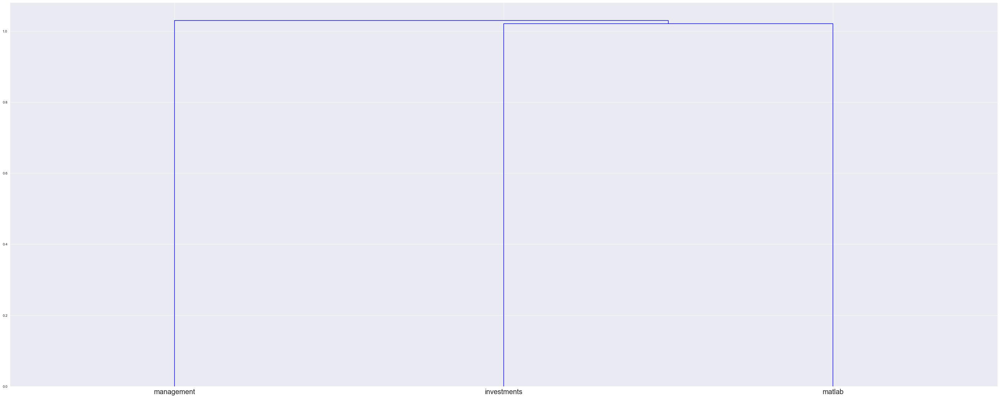

In [240]:
df=pd.read_csv('finance_course.csv')

import unicodedata
from collections import Counter
from nltk.tokenize import RegexpTokenizer
import re
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
stop_words = set(stopwords.words('english'))
Lemmatizer = WordNetLemmatizer()
tokenizer = RegexpTokenizer(r'\w+')
def clean_tweet(text):
    text = BeautifulSoup(text, 'html.parser').get_text() 
    text = unicodedata.normalize('NFKD',text).encode('ascii', 'ignore').decode('utf-8')
    text = re.sub(r'http\S+','',text) 
    text = re.sub(r'\d+','',text) 
    text = text.lower()
    text = tokenizer.tokenize(text)
    text_filter = [words for words in text if not words in stop_words]
    text_base = [Lemmatizer.lemmatize(words) for words in text_filter]
    text_clean = ' '.join(words for words in text_base)
    return text_clean

cleaned_tweet=[]
for sentence in df['Description']:
    output = clean_tweet(sentence)
    cleaned_tweet.append(output)

df['Description'] = cleaned_tweet


all_words=[]
word_counter = Counter()
for text in df['Description']:
    words = tokenizer.tokenize(text)
    all_words.extend(words)
    word_counter.update(all_words)

# save the most common 30 words to word_list
word_list = [word for (word, freq) in word_counter.most_common(30)]
word_list

useless_words=['module','course','model','learn','de','introduction','also','problem', 'vote', 'use','method','important',
              'world','first']
def remove_useless_words (text):
    text = ' '.join(i for i in text.split() if i not in useless_words)
    return text

df['Description'] = df['Description'].apply(remove_useless_words)
df.head(3)

all_words=[]
word_counter = Counter()
for text in df['Description']:
    words = tokenizer.tokenize(text)
    all_words.extend(words)
    word_counter.update(all_words)

# save the most common 30 words to word_list
word_list = [word for (word, freq) in word_counter.most_common(30)]
word_list

# Create a multi-words phrase detector
def detect_tool(table, skills):
  # Initialize a word frequency table
  skill_table=pd.DataFrame(columns=skills, index=range(len(table)), dtype=int)
  for skill in skills:
    skill_table[skill] = np.zeros(len(skill_table))
  # Phrase detector
  for i in range(len(table)):
    text=table.iloc[i, 1]
    # Remove the html tags
    re.sub(r'<[^<]+?>','', str(text))
    # Extract the common skills and calculate the word frequency
    for skill in skills:
      if (re.findall(re.escape(skill), str(text))!= []):
        skill_table.loc[i, skill]=int(len(re.findall(re.escape(skill), text)))
  return skill_table

skills = ['strategy',
'analytical',
'auditing',
'project management',
'accounting',
'mathematics',
'communication',
'critical thinking',
'visualization',
'master',
'phd',
          'mba',
          'estate planning',
          'handling detailed work',
          'handling money',
          'investments',
          'investment principles',
          'marketing',
          'mergers ',
          'portfolio performance reports',
          'taxation',
          'wealth management',
          'working under stress',
          'analytics',
          'writing',
          'scheduling',
          'gaap',
          'cost Analysis',
          'Excel',
          'quantitative data',
          'matlab',
          'tax filing',
          'tax planning',
          'trial balance',
          'analyzing data',
          'economize',
          'financial analysis',
          'logic',
          'restructuring',
          'strategic planning',
          'financial engineering',
          'financial modeling',
          'hyperion',
          'it software',
          'microsoft office',
          'mobile applications',
          'sap',
          'securities',
          'financial advising',
          'financial concepts',
          'financial reporting',
          'interpersonal',
          'management',
          'nonverbal communication',
          'performance management',
          'persuading',
          'practice management',
          'presenting',
          'relationship management',
]
df=detect_tool(df, skills)

df.head(3)

df=df.loc[:,(df!=0.).any(axis=0)]

# Calculating the distance
dist=pdist(df.T, metric='euclidean')

# Calculating the linkage matrix
link = linkage(df.T, method='complete', metric='correlation')

plt.figure(figsize=(50,20))
B=dendrogram(link, labels=df.columns, leaf_font_size=20)

### Recommender System

In [1]:
#!pip install bs4
#!pip install numpy
#!pip install pandas

#!pip install ast
#!pip install matplotlib
#!pip install nltk
#!pip install wordcloud

In [2]:
import requests
import bs4
from bs4 import BeautifulSoup
import pandas as pd
import time
import re
import numpy as np
import nltk
import nltk
import os
import csv
nltk.download('punkt')
nltk.download('stopwords')
from nltk import word_tokenize
from wordcloud import WordCloud
import matplotlib.pyplot as plt
#from hcluster import pdist, linkage, dendrogram
from nltk.tokenize import RegexpTokenizer
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn.metrics import pairwise_distances

import scipy.cluster.hierarchy as sch



[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


# Online Course Recommender

## Scraping CourseReport.com to obtain course information and ratings in data science bootcamps, and online education platforms.



Sraping course report for course postings and rankings to be linked to the relevant skills required. Starts by obtaining all the links for each page. Next iterates through each page to obtain Datascience Course program/website, rating and # of reviews, and links to further investigate courses later.

In [3]:

# #create an empty DF 
# course_table = pd.DataFrame()
# URL = 'https://www.coursereport.com/tracks/data-science-bootcamp'
# page = requests.get(URL)
#         #specifying a desired format of “page” using the html parser - this allows python to read the various components of the page, rather than treating it as one long string.
# soup = BeautifulSoup(page.text, 'html.parser')
# #creating a blank list for links
# links = []
# #web scrapping for links of each page containing relevant data
# for divTag in soup.find_all('nav',{'class': 'pagination'}):
#     for aTag in divTag.find_all('a'):
#         links.append(aTag.get('href'))
#         time.sleep(0.5)
# links = links[:-1]
# #noticed the link for page 2 was grabbed twice instead of page 1 so replaced with the link for page 1
# links[0] = '/tracks/data-science-bootcamp'
# #resetting the base so the proceeding loop can modify to each specific page
# URL = 'https://www.coursereport.com'

# for link in links:
#     URL = 'https://www.coursereport.com'
#     URL += link 
#     page = requests.get(URL)
#         #specifying a desired format of “page” using the html parser - this allows python to read the various components of the page, rather than treating it as one long string.
#     soup = BeautifulSoup(page.text, 'html.parser')
# #looping though each course posting and obtaining relevant info
#     for courses in soup.find_all("li", class_ = "school-li"): 
#         #sleep(1)
#         try:
#             course_title = courses.find('div', class_ = 'school-header').text.strip()
#       #print(job_title)
#         except:
#             course_title = None

#         try:
#             rating = courses.find('p', class_ = 'rating-number').text.strip()
#         except:
#             rating = None

#         try:
#             link = courses.find('div', attrs={'class': 'school-header'}).find('a', href=True)['href']
#         except:
#             link = None   
        
#         link+='#/courses'
#         time.sleep(0.5)
#         #building the dataframe row by row 
#         course_table = course_table.append({
#             'course_title': course_title, 
#             'avg_rating': rating,
#             'link': link}, ignore_index = True)

### Scraping Links to get summaries

In [4]:
# course_table

## Filtering ratings

Below, the data was cleaned to get the rating and # of reviews in there own respective columns. Many postings that were featured on the website included that in the course platform  title, so this was removed. As avg_rating is a string the columns that were made for reviews and ratings were converted to numeric.

In [5]:
# #course_table.head()

# #course_table = course_table.replace(np.nan, '', regex=True)
# course_table = course_table[course_table['avg_rating'].notna()]
# course_table['course_title'] = course_table['course_title'].str.replace('Featured','')
# course_table['avg_rating'] = course_table['avg_rating'].str.replace('Avg Rating:','')
# course_table['avg_rating'] = course_table['avg_rating'].str.replace(' reviews','')
# course_table['avg_rating'] = course_table['avg_rating'].str.replace(')','')
# #course_table['avg_rating'] = course_table['avg_rating'].str.replace('(','')


# course_table[['avg_rating','reviews']] = course_table['avg_rating'].str.split('(',expand=True,)

In [6]:
# #course_table.tail()


# #converting string to numeric
# course_table[['avg_rating','reviews']] = course_table[['avg_rating','reviews']].apply(pd.to_numeric)


# #course_table[course_table['reviews'] > 100].sort_values(by='avg_rating', ascending=False).head(10)



# course_sifter = course_table[course_table['reviews'] > 150].sort_values(by='avg_rating', ascending=False)
# #course_sifter = course_sifter.iloc[0:20,:]
# course_sifter = course_sifter.reset_index()
# #course_sifter

# for i in range(len(course_sifter)):
#     link=course_sifter.iloc[i,3]
#     prefix='https://www.coursereport.com'
#     course_sifter.iloc[i,3]=prefix+link

# #course_sifter.iloc[i,3]

# program_table = pd.DataFrame()
# for i in range(len(course_sifter)):
#     detail = requests.get(course_sifter.iloc[i,3]) 
#     soup = BeautifulSoup(detail.text, "lxml")
#     for courses in soup.find_all("ul", class_ = "course-card"): 
#         try:
#             program_title = courses.find('h3').text.strip()
#       #print(job_title)
#         except:
#             program_title = None

#         try:
#             skills = courses.find('div', class_ = 'details').text.strip()
#         except:
#             skills = None
#         try:
#             course_link = courses.find('span', attrs={'class': 'btn btn-default btn-apply small'}).find('a', href=True)['href']
#         except:
#             course_link = None
        
#         time.sleep(0.5)
#         #building the dataframe row by row 
#         program_table = program_table.append({
#             'course_title': course_sifter.iloc[i,2],
#             'program_title': program_title, 
#             'skills': skills,
#             'avg_rating': course_sifter.iloc[i,1],
#             'reviews': course_sifter.iloc[i,4],
#             'course_link': course_link}, ignore_index = True)

# program_table.head()

In [7]:
# #copier=program_table
# copier=program_table
# program_table=copier


In [8]:
#program_table

In [9]:
# print(program_table.iloc[0,4])

In [10]:
# #program_table.to_csv(r'C:\Users\Tyler\Documents\Python notes\Project\wtf.csv', index = False)

In [11]:

# # program_table.columns = program_table.columns.str.strip()
# # program_table = program_table[program_table.skills != None]
# # program_table = program_table[program_table.skills != ""]
# # program_table.dropna()
# program_table.drop_duplicates(keep=False,inplace=True) 
# program_table = program_table.reset_index(drop=True)

In [12]:
# program_table.head()

## Obtaining list of acceptable courses from highly rated schools

The following list named skillset was created in order to search the schools for keywords that are relavent towards AI,ML and data science...

In [13]:
# skillset = ['deep learning', 'machine learning', 'ai' ,'artificial intelligence', 'ml','data science', 'cost analysis','prediction','code','coding','data architecture','programming','machine learning','ai','statistics','mathematic','communication','critical thinking','visualization','master','professional','bachelor','business decisions','operationalizing','infrastructure','prototype','workflows','modeling','statistical','cloud','jupyter','rstudio','pycharm','atom','matlab','visual studio','spyder','vim','notepad','sublime','google colab','google','google cloud','notebook','ai platform','datalab','binder','ibm watson','ibm watson studio','ocean','python','r','sql','c','c++','java','javascript','typescript','bash','ggplot','matplotlib','plotly','d3','shiny','seaborn','geoplotlib','leaflet','cpu','gpu','tpu','linear','logistic','regression','forest','gradient','bayesian','neural networks','neural','dense','convolutional','transformer','ml','augmentation','automated','feature engineering','selection','architecture','pipelines','image','video','pil','cv2','skimage','u-net','mask r-cnn','image segmentation','object detection  ','yolov3','retinanet','image classification','vgg','inception','resnet','gan','vae','computer vision','generative networks','word embeddings','vectors','glove','fasttext','word2ve','encoder','decorder seq2seq','vanilla','contextualized embeddings','elmo','cove','gpt-2','bert','xlnet','scikit-learn','tensorflow','keras','randomforest','xgboost','pyTorch','caret','lightgbm','spark mlib','fast.ai','amazon','azure','salesforce','alibaba','aws']
# #list of skills]

# program_table['descript']='skills'
# for skill in skillset:
#     program_table[skill] = np.zeros(len(program_table))
# #reset_index
# program_table = program_table.reset_index()
# #program_table.head(5)

# program_table['cleaned_course']='blank'
# program_table['cleaned_skills']='blank'
    

Now I will search if the list of key words defined as "skillset' appear in either the course title or description....

In [14]:
# tokenized=[]
# for i in range(len(program_table)):
#     try:
#         text = str(program_table.iloc[i,6])
        
#         string = re.sub(r'\,', ' ', text) # remove ","
#         string = re.sub(r'([a-z](?=[A-Z])|[A-Z](?=[A-Z][a-z]))', r'\1 ', string) # spacing betweeen capitals "MachineLearning"
#         string = string.lower() # converting everything to lower case
#         #string = re.sub(r'\n',' ',string) 
#         string = re.sub(r'\,', ' ', string) # remove ","
#         string = re.sub('/', ' ', string) # remove "/"
       
#         string = re.sub(r'\(', ' ', string) # remove "("
#         string = re.sub(r'\)', ' ', string) # remove ")"
#         string = re.sub(' +',' ',string) # remove more than one space  
        
        
#         text2 = str(program_table.iloc[i,4])
#         string2 = re.sub(r'\,', ' ', text2) # remove ","
#         string2 = re.sub(r'([a-z](?=[A-Z])|[A-Z](?=[A-Z][a-z]))', r'\1 ', string2)
#         string2 = string2.lower()
#         #string2 = re.sub(r'\n',' ',string2) 
#         string2 = re.sub(r'\,', ' ', string2) # remove ","
#         string2 = re.sub('/', ' ', string2) # remove "/"
#         string2 = re.sub(r'\(', ' ', string2) # remove "("
#         string2 = re.sub(r'\)', ' ', string2) # remove ")"
#         string2 = re.sub(' +',' ',string2) # remove more than one space  
        
                
#     except:
#         text = None
#         text = "" 
#         text2 = None
#         text2 = ""
#     print(string2)
#     program_table['cleaned_course'][i] = string2
#     program_table['cleaned_skills'][i] = string
#     #program_table.iloc[i,4] = string2
    
#     for sk in skillset :
        
#         if any(x in sk for x in ['+']):
#             skk = re.escape(sk)
#         else:
#             skk = sk
#         result = re.search(r'(?:^|(?<=\s))' + skk + r'(?=\s|$)',string)
#         result2 = re.search(r'(?:^|(?<=\s))' + skk + r'(?=\s|$)',string2)
        
#         if result:

#             program_table_text = 1
            
#         else:
#             program_table_text = 0
        
#         if result2:    
#             program_table_text2 = 1
            
#         else:
#             program_table_text2 = 0

#         program_table[sk][i] = program_table_text+program_table_text2

In [15]:
# program_table.iloc[1,1]

In [16]:
# program_table.head()

## Collecting dataframes for recommender

After trying to filter out some of the results I still have too many options and it can be seen that some of the options may only contain data science, or ML/AI. To filter more I will make them require definitely require some aspect of Machine Learning first... and I can further reduce later.

In [17]:
# recommended_courses = program_table

In [18]:
#recommended_courses.to_csv(r'C:\Users\Tyler\Documents\Python notes\Project\recommended_courses.csv', index = False)

In [19]:
job_list = pd.read_csv(r'.\ZipRecruiter.csv')
recommended_courses = pd.read_csv(r'.\recommended_courses.csv')

In [20]:
skillset = ['deep learning', 'machine learning', 'ai' ,'artificial intelligence', 'ml','data science', 'cost analysis','prediction','code','coding','data architecture','programming','machine learning','ai','statistics','mathematic','communication','critical thinking','visualization','master','professional','bachelor','business decisions','operationalizing','infrastructure','prototype','workflows','modeling','statistical','cloud','jupyter','rstudio','pycharm','atom','matlab','visual studio','spyder','vim','notepad','sublime','google colab','google','google cloud','notebook','ai platform','datalab','binder','ibm watson','ibm watson studio','ocean','python','r','sql','c','c++','java','javascript','typescript','bash','ggplot','matplotlib','plotly','d3','shiny','seaborn','geoplotlib','leaflet','cpu','gpu','tpu','linear','logistic','regression','forest','gradient','bayesian','neural networks','neural','dense','convolutional','transformer','ml','augmentation','automated','feature engineering','selection','architecture','pipelines','image','video','pil','cv2','skimage','u-net','mask r-cnn','image segmentation','object detection  ','yolov3','retinanet','image classification','vgg','inception','resnet','gan','vae','computer vision','generative networks','word embeddings','vectors','glove','fasttext','word2ve','encoder','decorder seq2seq','vanilla','contextualized embeddings','elmo','cove','gpt-2','bert','xlnet','scikit-learn','tensorflow','keras','randomforest','xgboost','pyTorch','caret','lightgbm','spark mlib','fast.ai','amazon','azure','salesforce','alibaba','aws']
#list of skills]

In [21]:
jobs=job_list.iloc[:,1:6]
columns_titles = ["company","job_title",'location','salary','link']
jobs=jobs.reindex(columns=columns_titles)
jobs= jobs[0:7]
#job_list
jobs

,company,job_title,location,salary,link
0,rockwell automation,Software Data Architect,"Toronto, ON",Full-Time,https://www.ziprecruiter.com/eclk/fAQRWYLiCODH...
1,PagerDuty,Senior Data Engineer - Analytics,"Toronto, ON",Full-Time,https://www.ziprecruiter.com/eclk/PrjVFPG3P6gb...
2,Goodfood Market Corp.,BI Engineer,"Toronto, ON",Full-Time,https://www.ziprecruiter.com/c/Goodfood-Market...
3,Interac,Senior Data Engineer,"Toronto, ON",Full-Time,https://www.ziprecruiter.com/eclk/gptSw66Ty4w_...
4,Project X,Consultant- Big Data Developer (4 Positions),"Toronto, ON",Full-Time,https://www.ziprecruiter.com/c/Project-X/Job/C...
5,Rocket Homes,Big Data Engineer,"Toronto, ON",Full-Time,https://www.ziprecruiter.com/eclk/3yN3BWOj-n7Z...
6,Serigor Inc.,Informatica MDM Architect,"Toronto, ON",Full-Time,https://www.ziprecruiter.com/c/Serigor-Inc./Jo...


In [22]:
recommended_courses['score']=0
skillset

['deep learning',
 'machine learning',
 'ai',
 'artificial intelligence',
 'ml',
 'data science',
 'cost analysis',
 'prediction',
 'code',
 'coding',
 'data architecture',
 'programming',
 'machine learning',
 'ai',
 'statistics',
 'mathematic',
 'communication',
 'critical thinking',
 'visualization',
 'master',
 'professional',
 'bachelor',
 'business decisions',
 'operationalizing',
 'infrastructure',
 'prototype',
 'workflows',
 'modeling',
 'statistical',
 'cloud',
 'jupyter',
 'rstudio',
 'pycharm',
 'atom',
 'matlab',
 'visual studio',
 'spyder',
 'vim',
 'notepad',
 'sublime',
 'google colab',
 'google',
 'google cloud',
 'notebook',
 'ai platform',
 'datalab',
 'binder',
 'ibm watson',
 'ibm watson studio',
 'ocean',
 'python',
 'r',
 'sql',
 'c',
 'c++',
 'java',
 'javascript',
 'typescript',
 'bash',
 'ggplot',
 'matplotlib',
 'plotly',
 'd3',
 'shiny',
 'seaborn',
 'geoplotlib',
 'leaflet',
 'cpu',
 'gpu',
 'tpu',
 'linear',
 'logistic',
 'regression',
 'forest',
 'gradien

## Recommender Function

In [23]:
def recommender_system (jb, rc, t, skill):
    rc['score']=0
    
    for i in range(len(rc)):
        for sk in skill:
            #print (sk)
            if rc[sk][i]>0 and jb[sk][t]>0:
                rc['score'][i]+=1
                
            else:        
                pass
    columns_titles = ["course_title","program_title",'avg_rating', 'course_link']
    rc = rc.sort_values(by='score', ascending=False)
    rc=rc.reindex(columns=columns_titles)
    recommendation = rc.iloc[0:3,0:5]
    return(recommendation)
    

In [24]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', -1)

## Get started on your quest for your dream job !

In [25]:

jobs

,company,job_title,location,salary,link
0,rockwell automation,Software Data Architect,"Toronto, ON",Full-Time,https://www.ziprecruiter.com/eclk/fAQRWYLiCODHDVhTHh7rb3onxGwlezFluFwVDL8YavB0CNp3AbuQfM0sDZbig-9f-gum4QBlMcwzOnjKXsvDSNZ6PuK3x_6sMLu-Yd1n3yjlTC1eQK-VMffepbYYkLKSbjQDbe5aKZKbQ2sUFGNgIp9ogk14YLbG3d1Qok5tWgsGDLWH3AlxcurcCXOKD6fpYOmDChJCcaPkyk_xsRVDCrzpMvtZG6i61rgxUcrA4szDs49gLYXwQQ1NwrppaGm-QwH8xVbsf3y5X4DkOLvoh-3r55vd5hNG9Q2lEQPajniqNFcxex5s7C5cor3669MmG4KiMXPPDNJdQXTI6jaK9Ejp0cHxpp6hihZd3PPWYmu2ySIzAOQ2YB_jz4ca0GzOMTQDyjaDJR9psJQ-lkAtQBefMwtc_YPdICFGKDGMxYRmlpHfuEDzW1Oi0ssrvENVJkxABjz1ps6goB8h22erF0bJy2UDOavIU7b9OHtlpVQ=.7ea07f6c767dc9c9b3a4367cd39e8266
1,PagerDuty,Senior Data Engineer - Analytics,"Toronto, ON",Full-Time,https://www.ziprecruiter.com/eclk/PrjVFPG3P6gbwN0p_i0XWDKFgvBTNJrNRGGKDCMhHL7mRdXRM2b5Fmi_Haclq2VKQIub7up0I3OtddG3cK9rw-1YrwqchEzOYeon4r4uv4Qth2rf_pRqM4aiba5Qaz-2y-FPjaOMRNdxpK9Xwkt9SPbHGPc12RmDQHtgP7wTMSWTGFRZ3-nTfvGF9M3SaroLJ8WZkQbFBsigjbfGxTVJlYiFyZDB2fuCniKFo_L_gvoiq9aYP8ApQKz2P0-urNfDMJmzmT4WBc0oAtBe8_gRz8CDYiLhn7tQFRQZRdeYgiVv0cMxbdi1-4PnJVdNMt_wqMQOeLgwOElk5my26BQFMxODZWIiuoBNkDml6ssPRdmwS5vxuCRwHkbWdE2npezo9BQ_-0SOEIB8YP4U8Qx7rb4vn1l_COOWr6GoBwEiLhNSE9OVth16dFeqJXlG_Mq0VwDuYQBGvKvz_uNm4pLKTFFGe3TvtoB9wRxkHWqfgG4=.d27744abe62985b25a8a5bd9c7ca89d4
2,Goodfood Market Corp.,BI Engineer,"Toronto, ON",Full-Time,"https://www.ziprecruiter.com/c/Goodfood-Market-Corp./Job/BI-Engineer/-in-Toronto,ON?jid=DQ0ea4828fc2fb1b087020654f11f47678&job_id=331a1f2c39c037a7e69b2aca0c24f539"
3,Interac,Senior Data Engineer,"Toronto, ON",Full-Time,https://www.ziprecruiter.com/eclk/gptSw66Ty4w_7ZFRLIsXd4hQdYNxZ7KUDleAudN3vWWS1P70Em6ybBtL18O2rnGybTjbyVT6vDcor00ysOMuEAJXF89hauACXEHluf-WUw_NwCYx8F8hRty4jWB6VhZa4sdtgCAbclp-0hBs8Wsy0vxU7fZLkaF6_hW2HG9V7k8puGW6tWS0P8wBf_OtiNiY_VplUhHH1UPUObVO9a6rd9lT2pphogQLw92gM2HdkHwo_cuy_i5WULtgGIsH7uI4aIQ5wPwk6oWFYGXXwX-ebrO94kIZ6X0XMA3U-w50GuFGUJTZlsf-hNxwPh0zp5SpKTvGHEKFS2GodGpw97e3NWmxBLn7e1HlNS7ecSIsZfza_GufJpE5P6xg6Ak99_KA0zl112DAFEs4Z9JzFjEaesjmwiPpCW4DpWrYatMg1ZHRdehPsY3YECkYwXXTS5WZIkmDwr8KXJuJagnsBvXDUB6A5Gh_-1WU3fg-sirmpJA=.46efbfc84a9cf59794f4abce5fe8b7ab
4,Project X,Consultant- Big Data Developer (4 Positions),"Toronto, ON",Full-Time,"https://www.ziprecruiter.com/c/Project-X/Job/Consultant-Big-Data-Developer-(4-Positions)/-in-Toronto,ON?ojob=88a1b281c09d749f83a63c440961843b"
5,Rocket Homes,Big Data Engineer,"Toronto, ON",Full-Time,https://www.ziprecruiter.com/eclk/3yN3BWOj-n7ZC7ZDF6l4i12xAdbDU8bKHuIi2u8hIIMPgXuNJQG4uwt9jW7Wl9KqxykqMKei5y7UKVcsZeNlCt-EzDThZFgrBJAI-g4CsxJNm_SNQC-zTWrzAu1ANxNhe3EvLmBECoPHWpXiV65tGDX2aqfJ09D839qiKtwsW9ifPSEPnoyUw6f1m2KGUxQl0cgMF64Dipgaqxjb_Ruu0PFJDmt2okhds-UttejfiCPItpd4pqnPb4rP2rzL1g5o1HtqXEbRMRHZVCtiWeD4BNsQ77iTD4K7zlcI9QxRjMH2LKK0aiKuXMIZkzTG63mcz7NpYcM6ZWQCYdlqlc07M6zAju8U7k0hvIb01r_0Yc6uJnLivpSueHS7IYeMsvOni2fdhz-U0-03iBDBQNhe8aqxtP5Jpk0523_Jc_NSbeaM53p_6glR1Uw7YPPADMT2SMMcs146gJLYiPnadVxCco_G_4Ygj0WhS6wVELvl18c=.11067628bd1dbbd45c341b10ee097138
6,Serigor Inc.,Informatica MDM Architect,"Toronto, ON",Full-Time,"https://www.ziprecruiter.com/c/Serigor-Inc./Job/Informatica-MDM-Architect/-in-Toronto,ON?ojob=10bdb112e57e79adedfc0d991c3a0c4b"


Welcome to Course Compass! Please look through the company names and jobs and enter the one that interest you below:

In [26]:
#Type line of job beside X and click and run !
x=4
bang= recommender_system (job_list, recommended_courses, x, skillset)
print('The top 3 courses for you to get that dream job at:', jobs.iloc[x,0], ' in ' ,jobs.iloc[x,2], ' as a ', jobs.iloc[x,1], ' at a ', jobs.iloc[x,3], ' rate:')
bang


C:\Users\aruns\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


The top 3 courses for you to get that dream job at: Project X  in  Toronto, ON  as a  Consultant- Big Data Developer (4 Positions)  at a  Full-Time  rate:


,course_title,program_title,avg_rating,course_link
116,BrainStation,Introduction to Cloud Computing Training Online,4.67,https://brainstation.io/training/intro-cloud-computing?utm_source=CourseReport&utm_medium=referral&utm_campaign=cloudComputing_online
48,Flatiron School,Online Software Engineering Immersive,4.71,https://flatironschool.com/career-courses/coding-bootcamp/online/?utm_campaign=Sponsored_Content&utm_source=Course%20Report&utm_medium=FS%20Profile%20-%20OSE%20PDP
61,Udacity,Cloud Developer,4.71,https://www.udacity.com/course/cloud-developer-nanodegree--nd9990


# **Web Scraping for ZipRecruiter**

## **Importing Libraries

In [27]:
#!pip install bs4
#!pip install numpy
#!pip install pandas

#!pip install ast
#!pip install matplotlib
#!pip install nltk
#!pip install wordcloud
!pip install xgboost

In [28]:
import requests
import bs4
from bs4 import BeautifulSoup
import pandas as pd
import time
import re
import numpy as np
import nltk
import nltk
import os
import csv
nltk.download('punkt')
nltk.download('stopwords')
from nltk import word_tokenize
from wordcloud import WordCloud
import matplotlib.pyplot as plt
#from hcluster import pdist, linkage, dendrogram
from nltk.tokenize import RegexpTokenizer
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn.metrics import pairwise_distances

import scipy.cluster.hierarchy as sch



[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


## Scraping Zip Recruiter for skills in data science job postings



Sraping Zip Recruiter for Job postings to find relevant skills required. Much difficulty scraping this website as it uses an "infinite scroll" system to load more results. Investigated the use of Selenium which can act as a human and click buttons on the page, but browser drivers were needed so considered this not an acceptable option for this project. In the end I decided to make a loop scrolling through 5 pages of each city (20 results per page) to gain the data as typically only 5 pages were available per city.

In [29]:
# #Scrapping for 100 data points (20 points per page = 5 pages)
# #create an empty DF and set pages = 6
# zip_table = pd.DataFrame()
# URL = 'https://www.ziprecruiter.com/Jobs/Data-Scientist/--in-Toronto,ON'
# #i = 1
# for i in range(1,20):
#     time.sleep(0.5)
# #conducting a request of the stated URL above:
#     if i == 1:
#         page = requests.get(URL)
#         #specifying a desired format of “page” using the html parser - this allows python to read the various components of the page, rather than treating it as one long string.
#         soup = BeautifulSoup(page.text, 'html.parser')
#     elif i > 1:
#         URL = 'https://www.ziprecruiter.com/Jobs/Data-Scientist/--in-Toronto,ON/'
#         URL+=str(i)
#         page = requests.get(URL)
#         #specifying a desired format of “page” using the html parser - this allows python to read the various components of the page, rather than treating it as one long string.
#         soup = BeautifulSoup(page.text, 'html.parser')

#     for jobs in soup.find_all("article", class_ = "job_result"): 
#       try:
#           job_title = jobs.find('span', class_ = 'just_job_title').text.strip()
#       #print(job_title)
#       except:
#           job_title = None

#       try:
#         location = jobs.find('span', class_ = 'location').text.strip()
#       except:
#         location = None

#       try:
#         company = jobs.find('span', class_ = 'name').text.strip()
#       except:
#         company = None

#       try:
#         link = jobs.find('p', attrs={'class': 'job_snippet'}).find('a', href=True)['href']
#       except:
#         link = None

#       try:
#         salary = jobs.find('span', attrs={'class': 'data_item'}).text.strip()
#       except:
#         salary = None    
    
#       zip_table = zip_table.append({
#           'job_title': job_title, 
#           'company': company,
#           'location': location,
#           'salary': salary,
#           'link': link}, ignore_index = True)
        


Below, a list of skills was made using terms found in the kaggle data science survey. Previously, links were obained by scraping Zip Recuiter as the job posting descriptions reside in a seprate URL. The new URLs are scraped below, and the regular expressions library is utilyzed to determine if the skills are mentioned in the job postings.

In [30]:

# skills = 'deep learning', 'machine learning', 'ai' ,'artificial intelligence', 'ml','data science', 'cost analysis','prediction','code','coding','data architecture','programming','machine learning','ai','statistics','mathematic','communication','critical thinking','visualization','master','professional','bachelor','business decisions','operationalizing','infrastructure','prototype','workflows','modeling','statistical','cloud','jupyter','rstudio','pycharm','atom','matlab','visual studio','spyder','vim','notepad','sublime','google colab','google','google cloud','notebook','ai platform','datalab','binder','ibm watson','ibm watson studio','ocean','python','r','sql','c','c++','java','javascript','typescript','bash','ggplot','matplotlib','plotly','d3','shiny','seaborn','geoplotlib','leaflet','cpu','gpu','tpu','linear','logistic','regression','forest','gradient','bayesian','neural networks','neural','dense','convolutional','transformer','ml','augmentation','automated','feature engineering','selection','architecture','','pipelines','image','video','pil','cv2','skimage','u-net','mask r-cnn','image segmentation','object detection  ','yolov3','retinanet','image classification','vgg','inception','resnet','gan','vae','computer vision','generative networks','word embeddings','vectors','glove','fasttext','word2ve','encoder','decorder seq2seq','vanilla','contextualized embeddings','elmo','cove','gpt-2','bert','xlnet','scikit-learn','tensorflow','keras','randomforest','xgboost','pyTorch','caret','lightgbm','spark mlib','fast.ai','amazon','azure','salesforce','alibaba','aws'
# #list of skills]

In [31]:
# zip_table['descript']='text'
# for skill in skills:
#     zip_table[skill] = np.zeros(len(zip_table))
# #reset_index
# zip_table = zip_table.reset_index()
# zip_table.head(5)

In [32]:
# tokenized=[]
# for i in range(len(zip_table)):
#     detail = requests.get(zip_table.iloc[i,3]) 
#     soup = BeautifulSoup(detail.text, "lxml")
    
#     #BELOW IS OPTION 2 (CAN NOT HANDLE MULTIPLE WORD SKILLS)
# #     try:
# #         text = soup.find("div", {'class' : 'job_details_container'}).text.strip().lower()
# #       # Remove the html tags
# #         re.sub(r'<[^<]+?>','', text)
# #   # Tokenize the text
# #     except:
# #         text = None
# #     zip_table.iloc[i,6] = text
# #     tokenizer = RegexpTokenizer('\W+',gaps=True)
# #     text=tokenizer.tokenize(str(text))
# #   # Extract the common skills
# #     common_value=list(set(skills).intersection(text))
# #     for word in common_value:
# #         zip_table.loc[i, word]=1
#   #get the text without none
#     try:
#         text = soup.find("div", {'class' : 'job_details_container'}).text.strip().lower()
#         string = re.sub(r'\,', ' ', text) # remove ","
#         #string = re.sub(r'\n',' ',string) 
#         string = re.sub(r'\,', ' ', string) # remove ","
#         string = re.sub('/', ' ', string) # remove "/"
#         string = re.sub(r'\(', ' ', string) # remove "("
#         string = re.sub(r'\)', ' ', string) # remove ")"
#         string = re.sub(' +',' ',string) # remove more than one space 
#         print(string)
        
#     except:
#         text = None
#         text = "" 
#     #zip_table.iloc[i,6] = string
#     for sk in skills :
#         if any(x in sk for x in ['+']):
#             skk = re.escape(sk)
#         else:
#             skk = sk
#         result = re.search(r'(?:^|(?<=\s))' + skk + r'(?=\s|$)',text)
        
#         if result:

#             zip_table[sk][i] = 1

In [33]:
# #zip_table

# zip_table = zip_table[zip_table.descript != "none"]
# zip_table = zip_table.drop_duplicates(keep='first')
# zip_table=zip_table.fillna(0)
# #zip_table = zip_table.loc[:, (zip_table != 0).any(axis=0)]
# #zip_table.to_csv(r'C:\Users\Tyler\Documents\Python notes\Project\ZipRecruiter.csv', index = False)
# zip_table.head()

Below, an attempt was made to obtain the most frequently used word across descriptions to mine for skills. Even with the StopWords libary, there were to many general terms used and no skills were obtained. It is clear that a large list of terms needs to be created in order to find the skills with highest importance (frequency). This was done in the above work.

In [34]:
#zip_table.to_csv(r'C:\Users\Tyler\Documents\Python notes\Project\ZipRecruiter.csv', index = False)
zip_table = pd.read_csv(r'.\ZipRecruiter.csv')
zip_table.head()

# wf = zip_table.descript.str.cat(sep=' ')
# #function to split text into word
# tokens = word_tokenize(wf)
# vocabulary = set(tokens)
# print(len(vocabulary))
# from nltk.corpus import stopwords
# stop_words = set(stopwords.words('english'))
# tokens = [w for w in tokens if not w in stop_words]
# frequency_dist = nltk.FreqDist(tokens)
# sorted(frequency_dist,key=frequency_dist.__getitem__, reverse=True)[0:50]

,index,company,job_title,link,location,salary,descript,deep learning,machine learning,ai,artificial intelligence,ml,data science,cost analysis,prediction,code,coding,data architecture,programming,statistics,mathematic,communication,critical thinking,visualization,master,professional,bachelor,business decisions,operationalizing,infrastructure,prototype,workflows,modeling,statistical,cloud,jupyter,rstudio,pycharm,atom,matlab,visual studio,spyder,vim,notepad,sublime,google colab,google,google cloud,notebook,ai platform,datalab,binder,ibm watson,ibm watson studio,ocean,python,r,sql,c,c++,java,javascript,typescript,bash,ggplot,matplotlib,plotly,d3,shiny,seaborn,geoplotlib,leaflet,cpu,gpu,tpu,linear,logistic,regression,forest,gradient,bayesian,neural networks,neural,dense,convolutional,transformer,augmentation,automated,feature engineering,selection,architecture,Unnamed: 91,pipelines,image,video,pil,cv2,skimage,u-net,mask r-cnn,image segmentation,object detection,yolov3,retinanet,image classification,vgg,inception,resnet,gan,vae,computer vision,generative networks,word embeddings,vectors,glove,fasttext,word2ve,encoder,decorder seq2seq,vanilla,contextualized embeddings,elmo,cove,gpt-2,bert,xlnet,scikit-learn,tensorflow,keras,randomforest,xgboost,pyTorch,caret,lightgbm,spark mlib,fast.ai,amazon,azure,salesforce,alibaba,aws
0,0,rockwell automation,Software Data Architect,https://www.ziprecruiter.com/eclk/fAQRWYLiCODHDVhTHh7rb3onxGwlezFluFwVDL8YavB0CNp3AbuQfM0sDZbig-9f-gum4QBlMcwzOnjKXsvDSNZ6PuK3x_6sMLu-Yd1n3yjlTC1eQK-VMffepbYYkLKSbjQDbe5aKZKbQ2sUFGNgIp9ogk14YLbG3d1Qok5tWgsGDLWH3AlxcurcCXOKD6fpYOmDChJCcaPkyk_xsRVDCrzpMvtZG6i61rgxUcrA4szDs49gLYXwQQ1NwrppaGm-QwH8xVbsf3y5X4DkOLvoh-3r55vd5hNG9Q2lEQPajniqNFcxex5s7C5cor3669MmG4KiMXPPDNJdQXTI6jaK9Ejp0cHxpp6hihZd3PPWYmu2ySIzAOQ2YB_jz4ca0GzOMTQDyjaDJR9psJQ-lkAtQBefMwtc_YPdICFGKDGMxYRmlpHfuEDzW1Oi0ssrvENVJkxABjz1ps6goB8h22erF0bJy2UDOavIU7b9OHtlpVQ=.7ea07f6c767dc9c9b3a4367cd39e8266,"Toronto, ON",Full-Time,text,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,PagerDuty,Senior Data Engineer - Analytics,https://www.ziprecruiter.com/eclk/PrjVFPG3P6gbwN0p_i0XWDKFgvBTNJrNRGGKDCMhHL7mRdXRM2b5Fmi_Haclq2VKQIub7up0I3OtddG3cK9rw-1YrwqchEzOYeon4r4uv4Qth2rf_pRqM4aiba5Qaz-2y-FPjaOMRNdxpK9Xwkt9SPbHGPc12RmDQHtgP7wTMSWTGFRZ3-nTfvGF9M3SaroLJ8WZkQbFBsigjbfGxTVJlYiFyZDB2fuCniKFo_L_gvoiq9aYP8ApQKz2P0-urNfDMJmzmT4WBc0oAtBe8_gRz8CDYiLhn7tQFRQZRdeYgiVv0cMxbdi1-4PnJVdNMt_wqMQOeLgwOElk5my26BQFMxODZWIiuoBNkDml6ssPRdmwS5vxuCRwHkbWdE2npezo9BQ_-0SOEIB8YP4U8Qx7rb4vn1l_COOWr6GoBwEiLhNSE9OVth16dFeqJXlG_Mq0VwDuYQBGvKvz_uNm4pLKTFFGe3TvtoB9wRxkHWqfgG4=.d27744abe62985b25a8a5bd9c7ca89d4,"Toronto, ON",Full-Time,text,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2,Goodfood Market Corp.,BI Engineer,"https://www.ziprecruiter.com/c/Goodfood-Market-Corp./Job/BI-Engineer/-in-Toronto,ON?jid=DQ0ea4828fc2fb1b087020654f11f47678&job_id=331a1f2c39c037a7e69b2aca0c24f539","Toronto, ON",Full-Time,text,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

It can be seen that the top 500 words are not relevant towards finding skills wanted in the field of data science.

### JOB BOARD WEB SCRAPPING

In [217]:
!pip install bs4

In [218]:
import requests
from bs4 import BeautifulSoup
import csv
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
import unicodedata
import nltk
import html
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn.metrics import pairwise_distances
import re


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\aruns\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [219]:
#from google.colab import drive
#drive.mount('/content/drive')
#import os
#os.chdir('/content/drive/My Drive/MIE1624/MIE1624-Course Project/CSVs')

# 1. Webscraping

## 1.1 Scrape every job posting

In [224]:
# # create an empty DF & get the base_url
# indeed_table = pd.DataFrame()
# base_URL = 'http://ca.indeed.com'

# pages = list(range(0,400,10))
# for page in pages:
#   result = requests.get("https://ca.indeed.com/jobs?q=data+scientist&start={}".format(page)).text
#   soup = BeautifulSoup(result, 'lxml')
#   for jobs in soup.find_all(class_ = "result"): 
#     try:
#       job_title = jobs.div.text.strip()
#     except:
#       job_title = None

#     try:
#       company = jobs.span.text.strip()
#     except:
#       company = None

#     try:
#       location = jobs.find('div', class_ = 'location').text.strip()
#     except:
#       location = None
      
#     try:
#       salary = jobs.find('span', class_ = 'no-wrap').text.strip()
#     except:
#       salary = None

#     try:
#       link = base_URL + jobs.find('a').attrs['href']
#     except:
#       link = None
    
#     indeed_table = indeed_table.append({
#         'job_title': job_title, 
#         'company': company,
#         'location': location,
#         'salary': salary,
#         'link': link}, ignore_index = True)

# #Delect dulicate jobs
# indeed_table = indeed_table.drop_duplicates(['link'], keep='first')

In [225]:
# # drop the rows with blank value in 'job_title' column 
# indeed_table.job_title.replace('', np.nan)
# indeed_table.dropna(axis=0, subset=['job_title'])

## 1.2  Extract the job descriptions from websites to the table

In [226]:
# def description(table):
#  # Rearrange the index
#   table.index=range(len(table))
  
#   for i in range(len(table)):
#     detail = requests.get(table.iloc[i,2])
#     soup = BeautifulSoup(detail.text, "lxml")

#     # Extract the text
#     text = ''
#     if (soup.find("div", {'class' : 'jobsearch-jobDescriptionText'}) != None):
#       text = soup.find("div", {'class' : 'jobsearch-jobDescriptionText'}).text.strip().lower()

#     table.loc[i, 'job_description']=text
#   return table

In [227]:
# indeed_description=description(indeed_table)

In [228]:
# indeed_description.tail()

In [229]:
# indeed_description.to_csv('indeed_description.csv', index=False)

## 1.3 Combine the job description from different sources (websites)

In [230]:
# indeed_description=pd.read_csv('indeed_description.csv', low_memory=False)

# glass=pd.read_csv('glass_door_webscrape (1).csv', low_memory=False)

# zip_des=pd.read_csv('zip_scrape.csv', low_memory=False)

# zip_des.iloc[15:19, :]

# glass=glass.rename(columns={'descrip': 'job_description'})

# descrip_all=pd.concat((glass['job_description'], indeed_description['job_description'], zip_des['job_description']))

# descrip_all.index=range(len(descrip_all))

# descrip_all=pd.DataFrame(descrip_all)

# # Drop the row with nan
# descrip_all=descrip_all.dropna(axis=0)

# descrip_all.to_csv('job_market.csv', index=False)

In [231]:
descrip_all=pd.read_csv('job_market.csv', low_memory=False)

## 1.3 Detect the key words in each job description and calculate the word frequency

In [232]:
# Create a multi-words phrase detector
def detect_tool(table, skills):
  # Initialize a word frequency table
  skill_table=pd.DataFrame(columns=skills, index=range(len(table)), dtype=int)
  for skill in skills:
    skill_table[skill] = np.zeros(len(skill_table))
  # Phrase detector
  for i in range(len(table)):
    text=table.iloc[i, 0]
    # Remove the html tags
    re.sub(r'<[^<]+?>','', str(text))
    # Extract the common skills and calculate the word frequency
    for skill in skills:
      if (re.findall(re.escape(skill), str(text))!= []):
        skill_table.loc[i, skill]=int(len(re.findall(re.escape(skill), text)))
  return skill_table

In [233]:
skills = ['data architecture',
'programming',
'machine learning',
'ai',
'statistics',
'mathematic',
'communication',
'critical thinking',
'visualization',
'master',
'phd',
'bachelor',
'business decisions',
'modeling',
'statistical',
'cloud',
'jupyter',
'rstudio',
'pycharm',
'atom',
'matlab',
'visual studio',
'spyder',
'vim',
'sublime',
'google colab',
'google cloud',
'datalab',
'ocean',
'python',
'r',
'sql',
'c',
'c++',
'java',
'javascript',
'typescript',
'bash',
'ggplot',
'matplotlib',
'plotly',
'd3',
'shiny',
'seaborn',
'geoplotlib',
'leaflet',
'cpu',
'gpu',
'tpu',
'linear',
'logistic',
'regression',
'gradient',
'bayesian',
'neural networks',
'convolutional',
'transformer',
'augmentation',
'automated',
'feature engineering',
'selection',
'architecture',
'pipelines',
'image',
'video',
'pil',
'cv2',
'skimage',
'u-net',
'mask r-cnn',
'image segmentation', 
'object detection',
'yolov3',
'retinanet',
'image classification',
'vgg',
'inception',
'resnet',
'gan',
'vae',
'computer vision',
'generative networks',
'word embeddings',
'vectors',
'glove',
'word2ve',
'encoder',
'decorder',
'vanilla',
'contextualized embeddings',
'elmo',
'cove',
'gpt-2',
'bert',
'xlnet',
'scikit-learn',
'tensorflow',
'keras',
'randomforest',
'xgboost',
'pyTorch',
'caret',
'lightgbm',
'spark mlib',
'fast.ai',
'amazon',
'azure',
'salesforce',
'alibaba',
'aws']
df=detect_tool(descrip_all, skills)

In [234]:
# drop the skills with all 0 values
df = df.loc[:, (df != 0).any(axis=0)]

In [235]:
df.tail()

,data architecture,programming,machine learning,ai,statistics,mathematic,communication,critical thinking,visualization,master,phd,bachelor,business decisions,modeling,statistical,cloud,jupyter,pycharm,atom,matlab,visual studio,google cloud,ocean,python,r,sql,c,c++,java,javascript,typescript,bash,ggplot,matplotlib,plotly,d3,shiny,seaborn,cpu,gpu,tpu,linear,logistic,regression,gradient,bayesian,neural networks,convolutional,transformer,augmentation,automated,feature engineering,selection,architecture,pipelines,image,video,pil,object detection,image classification,inception,gan,computer vision,word embeddings,vectors,word2ve,encoder,cove,gpt-2,bert,xlnet,scikit-learn,tensorflow,keras,xgboost,amazon,azure,salesforce,aws
1401,0.0,0.0,0.0,12.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,194.0,0.0,135.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1402,0.0,0.0,0.0,17.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,271.0,0.0,200.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1403,0.0,0.0,0.0,12.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,349.0,0.0,255.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1404,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,60.0,1.0,32.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1405,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,200.0,0.0,125.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Save the file to Google Drive

In [236]:
df.to_csv('webscraping_indeed.csv', index=False)

# 2. Clustering

In [237]:
# Calculating the distance
dist=pdist(df.T, metric='euclidean')

In [238]:
# Calculating the linkage matrix
link = linkage(df.T, method='complete', metric='correlation')

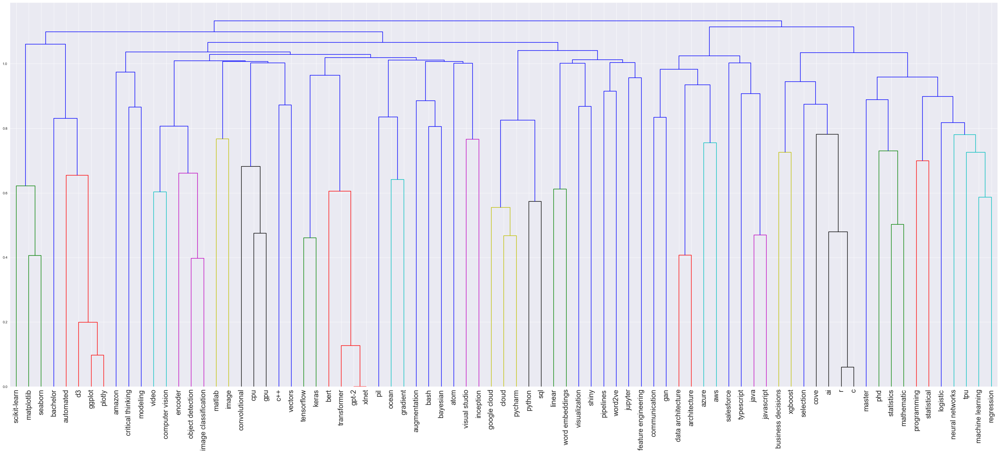

In [239]:
# Draw the dendrogram
plt.figure(figsize=(50,20))
B=dendrogram(link, labels=df.columns, leaf_font_size=20)